In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sys
import warnings
from pathlib import Path
import deepvar.hyperopt as hyperopt
from var import var
import random
import numpy as np
import torch
import optuna

#If you get an error either delete or add a parent (2 or 3)
project_root = Path('.').resolve().parent.parent.parent
sys.path.append(str(project_root))
print("Project root:", project_root)
print("Python path:", sys.path)

from tools import helpers as hp
from var import stationary as st
from tools import plotresults as pr
from deepvar import deepvar
from var import var
from deepvar import lstm
from deepvar import irf

warnings.filterwarnings('ignore', category=UserWarning, module='statsmodels')
warnings.filterwarnings('ignore', message='X does not have valid feature names, but StandardScaler was fitted with feature names')
warnings.filterwarnings('ignore', message='An unsupported index was provided and will be ignored when e.g. forecasting.')

ModuleNotFoundError: No module named 'deepvar'

## Prepare the Data


Prepares the data for the individual VAR, panel VAR, LSTM, and TFT models.

In [3]:
def prepare_df(df):
    df['log_GDP'] = np.log(df['GDP']) 
    df['log_CPI'] = np.log(df['CPI']) 
    final_df = df.copy()
    final_df['TIME_PERIOD'] = pd.to_datetime(final_df['TIME_PERIOD'])
    final_df = final_df.set_index(["Country", "TIME_PERIOD"])
    final_df = final_df.drop(columns = {"Code", "GDP", 'CPI'})
    return final_df

In [4]:
df = pd.read_csv('../../Data/WithoutPolicyRate.csv')
variables_to_keep = ['log_GDP', 'household_debt']
df = prepare_df(df)
df = df.drop(columns = {"exchange_rate"})
df = df[variables_to_keep]
LAGS = 3

In [5]:
final_detrend = st.detrend_data(df, variables_to_keep, 1) 
final_detrend = final_detrend[final_detrend.index.get_level_values("TIME_PERIOD")< "2020-03-31"]

Index(['Colombia', 'Netherlands, The', 'United Kingdom', 'India', 'Israel',
       'Sweden', 'Thailand', 'Australia', 'New Zealand', 'Ireland', 'Germany',
       'Brazil', 'Mexico', 'Greece', 'Norway', 'Austria', 'Italy', 'Argentina',
       'Singapore', 'France', 'Portugal', 'Hungary', 'Spain', 'Canada',
       'Switzerland', 'United States', 'Denmark', 'Indonesia',
       'China, P.R.: Hong Kong', 'Luxembourg', 'Japan', 'Finland',
       'South Africa', 'Chile', 'Czech Rep.', 'Poland, Rep. of',
       'Türkiye, Rep of', 'Korea, Rep. of', 'Belgium'],
      dtype='object', name='Country')


In [6]:
train_dt_var, test_dt_var = hp.time_panel_split_predict(final_detrend)


## LSTM Prep

In [7]:
inputs = lstm.get_lstm_input(final_detrend, LAGS)

demeaned_df, cross_sectional_means, country_means = deepvar.prepare_data_with_fixed_effects(final_detrend, variables = variables_to_keep)

lstm_df= lstm.create_lstm_data(demeaned_df, LAGS)

lstm_train, lstm_val, lstm_test= lstm.train_val_test_split(lstm_df)

panel_var_df= lstm.create_lstm_data(final_detrend, LAGS)



## Panel VAR preparation


The panel var was trained on a balanced dataset. It uses the lstm dataframe.

In [8]:

pvar_dict = {
    1: './pvarcoefs_GDPHHD/coef1_GDPHHD.xlsx',
    2: './pvarcoefs_GDPHHD/coef2_GDPHHD.xlsx',
    3: './pvarcoefs_GDPHHD/coef3_GDPHHD.xlsx',
    4: './pvarcoefs_GDPHHD/coef4_GDPHHD.xlsx',
    5: './pvarcoefs_GDPHHD/coef5_GDPHHD.xlsx',
    6: './pvarcoefs_GDPHHD/coef6_GDPHHD.xlsx'
}


def predict_differences(pvar_dict, LAGS, df):
    coefs_excel = pvar_dict.get(LAGS)
    coefs_df = pd.read_excel(coefs_excel, index_col=0)
    coefs_df = coefs_df.transpose()
    
    
    gdp_lags = [df[f'log_GDP_lag{i+1}'] for i in range(LAGS)]
    hd_lags = [df[f'household_debt_lag{i+1}'] for i in range(LAGS)]
    
    # Make predictions
    gdp_pred = sum(coefs_df.loc['GDP_eq', f'l_GDP_dif_L{i+1}'] * gdp_lags[i] for i in range(LAGS)) + \
               sum(coefs_df.loc['GDP_eq', f'hd_dif_L{i+1}'] * hd_lags[i] for i in range(LAGS))
    
    hhd_pred = sum(coefs_df.loc['HD_eq', f'l_GDP_dif_L{i+1}'] * gdp_lags[i] for i in range(LAGS)) + \
               sum(coefs_df.loc['HD_eq', f'hd_dif_L{i+1}'] * hd_lags[i] for i in range(LAGS))
    
    # Create DataFrame with predictions
    pred_df = pd.DataFrame({
        'log_GDP': gdp_pred,
        'household_debt': hhd_pred
    }, index=df.index)
    
    return pred_df


panel_var_df= lstm.create_lstm_data(final_detrend, 5)
predictions_df = predict_differences(pvar_dict, 5, panel_var_df)
predictions_df = predictions_df.dropna()

plot_df = panel_var_df.copy()
plot_df = plot_df[plot_df.index.isin(predictions_df.index)]
plot_df = plot_df.reset_index()
pred_df = predictions_df.reset_index()

def print_pvar_metrics(var, actual_df, pred_df):
    mse = hp.calculate_mse(actual_df, pred_df, var)
    rmse = np.sqrt(mse)
    mae = hp.calculate_mae(actual_df, pred_df, var)
    
    print(f"{var} Panel VAR MSE In Sample: {mse:.6f}")
    print(f"{var} Panel VAR RMSE In Sample: {rmse:.6f}")
    print(f"{var} Panel VAR MAE In Sample: {mae:.6f}")

print_pvar_metrics('log_GDP', plot_df, pred_df)
print_pvar_metrics('household_debt', plot_df, pred_df)


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
log_GDP Panel VAR MSE In Sample: 0.000172
log_GDP Panel VAR RMSE In Sample: 0.013116
log_GDP Panel VAR MAE In Sample: 0.009574
household_debt Panel VAR MSE In Sample: 0.402398
household_debt Panel VAR RMSE In Sample: 0.634348
household_debt Panel VAR MAE In Sample: 0.425917


Get Prediction for PVAR

In [9]:
def run_panel_VAR_predict_new(df, test, lags, pvar_dict):
    model_vars = ['log_GDP', 'household_debt']  
    n_vars = len(model_vars)
    
    
    all_predictions = []

    unique_countries = test.index.get_level_values('Country').unique()

    for country in unique_countries:
       
        country_data = df[df.index.get_level_values('Country') == country]
        country_test = test[test.index.get_level_values('Country') == country]

       
        initial_values = country_data[country_data.index.get_level_values('TIME_PERIOD') < 
                                      country_test.index.get_level_values('TIME_PERIOD')[0]][model_vars].tail(lags).values
        
        n_periods = len(country_test)
        forecast = np.zeros((n_periods, n_vars))
        
        for t in range(n_periods):
            if t < lags:
                last_values = np.vstack([initial_values[-(lags-t):], forecast[:t]])
            else:
                last_values = forecast[t-lags:t]
            
            
            temp_df = pd.DataFrame()
            for i in range(lags):
                if i < len(last_values):
                    temp_df[f'log_GDP_lag{i+1}'] = [last_values[i, 0]]
                    temp_df[f'household_debt_lag{i+1}'] = [last_values[i, 1]]
                else:
                    temp_df[f'log_GDP_lag{i+1}'] = [0]
                    temp_df[f'household_debt_lag{i+1}'] = [0]
            
            # Get predictions
            predictions_df = predict_differences(pvar_dict, lags, temp_df)
            
            # get predicted values 
            gdp_pred = predictions_df['log_GDP'].iloc[0]
            hhd_pred = predictions_df['household_debt'].iloc[0]
            
            forecast[t] = [gdp_pred, hhd_pred]
        
        time_periods = country_test.index.get_level_values('TIME_PERIOD')
        prediction_index = pd.MultiIndex.from_product(
            [[country], time_periods],
            names=['Country', 'TIME_PERIOD']
        )
        predictions_df = pd.DataFrame(forecast, columns=model_vars, index=prediction_index)
        
        all_predictions.append(predictions_df)

    final_predictions_df = pd.concat(all_predictions)
    return final_predictions_df, test

panel_var_pred, pvar_test_df = run_panel_VAR_predict_new(lstm_df, lstm_test, LAGS, pvar_dict)


pvar_data_metrics_df = panel_var_pred + cross_sectional_means + country_means
pvar_data_metrics_df

        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_

log_GDP  household_debt
Country  TIME_PERIOD                          
Colombia 2017-03-31   0.016862       -0.301645
         2017-06-30   0.020199       -0.025261
         2017-09-30   0.020547       -0.186097
         2017-12-31   0.017886        0.012261
         2018-03-31   0.017091       -0.186800
...                        ...             ...
Belgium  2018-12-31   0.008589        0.417128
         2019-03-31   0.011068        0.086728
         2019-06-30   0.011337        0.420707
         2019-09-30   0.008035        0.466378
         2019-12-31   0.005860        0.452538

[826 rows x 2 columns]

In [10]:
def generate_panel_var_forecast(df, test, lags, pvar_dict):
    model_vars = ['log_GDP', 'household_debt']
    n_vars = len(model_vars)
    
    initial_values = df[df.index.get_level_values('TIME_PERIOD') < 
                       test.index.get_level_values('TIME_PERIOD')[0]][model_vars].tail(lags).values
    
    n_periods = len(test)
    forecast = np.zeros((n_periods, n_vars))
    
    # Generate forecasts
    for t in range(n_periods):
        if t < lags:
            last_values = np.vstack([initial_values[-(lags-t):], forecast[:t]])
        else:
            last_values = forecast[t-lags:t]
        
        temp_df = pd.DataFrame()
        for i in range(lags):
            if i < len(last_values):
                temp_df[f'log_GDP_lag{i+1}'] = [last_values[i, 0]]
                temp_df[f'household_debt_lag{i+1}'] = [last_values[i, 1]]
            else:
                temp_df[f'log_GDP_lag{i+1}'] = [0]
                temp_df[f'household_debt_lag{i+1}'] = [0]
        
        predictions_df = predict_differences(pvar_dict, lags, temp_df)
        
        gdp_pred = predictions_df['log_GDP'].iloc[0]
        hhd_pred = predictions_df['household_debt'].iloc[0]
        
        forecast[t] = [gdp_pred, hhd_pred]
    
    time_periods = test.index.get_level_values('TIME_PERIOD')
    country = test.index.get_level_values('Country')[0]
    prediction_index = pd.MultiIndex.from_product(
        [[country], time_periods],
        names=['Country', 'TIME_PERIOD']
    )
    predictions_df = pd.DataFrame(forecast, columns=model_vars, index=prediction_index)
    
    return predictions_df, test

def get_country_forecast(df, test, country, lags, pvar_dict):
    country_data = df[df.index.get_level_values('Country') == country]
    country_test = test[test.index.get_level_values('Country') == country]
    
    predictions, actual = generate_panel_var_forecast(country_data, country_test, 
                                                    lags, pvar_dict)
    return predictions, actual


all_predictions = []
for country in lstm_test.index.get_level_values('Country').unique():
    pred, _ = get_country_forecast(lstm_df, lstm_test, country, LAGS, pvar_dict)
    all_predictions.append(pred)

final_pvar_predictions = pd.concat(all_predictions)


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Finding optimal learning rate...


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:310: The number of training batches (41) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
Finding best initial lr:  26%|██▌       | 26/100 [00:00<00:00, 258.94it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early

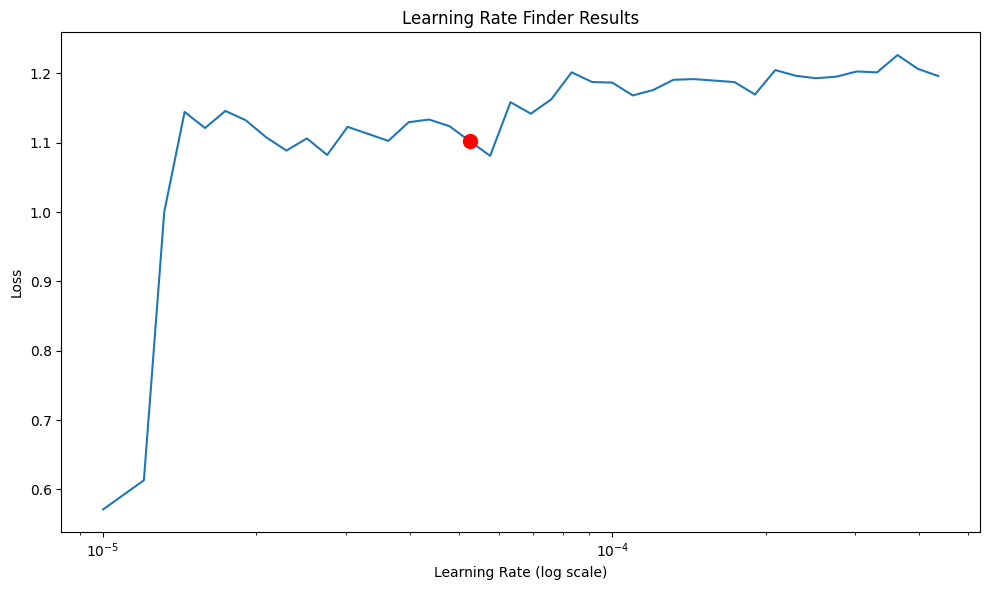

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:310: The number of training batches (41) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Suggested learning rate: 0.00005248
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 435.17it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_af651af9-2db8-4e49-be70-b4fdc30c454d.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_af651af9-2db8-4e49-be70-b4fdc30c454d.ckpt


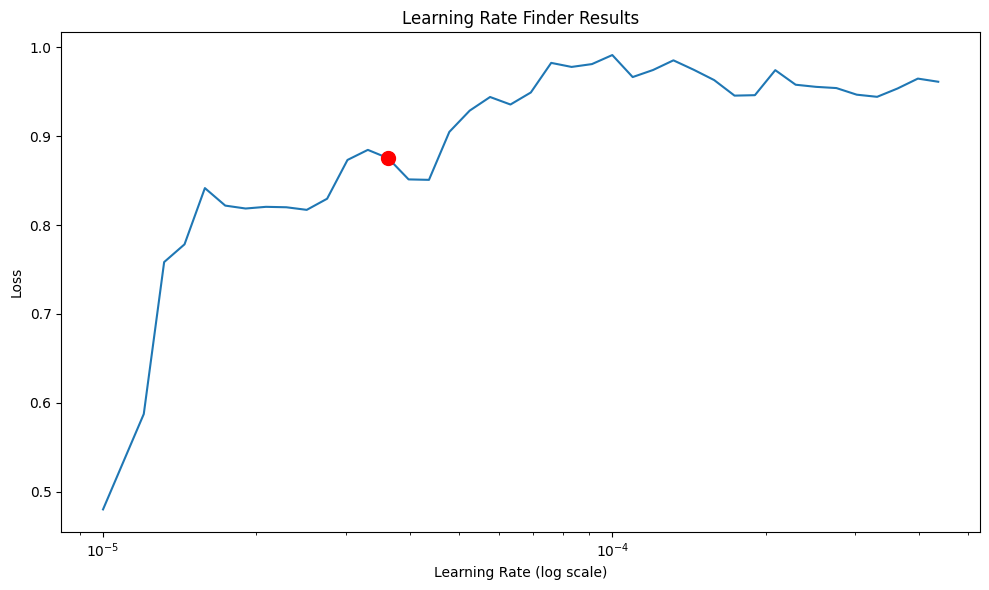

Suggested learning rate: 0.00003631


In [11]:
best_lr_GDP = lstm.find_learning_rate(lstm_df, inputs, 'log_GDP',min_lr=1e-5, max_lr=1e-1)
best_lr_hhd = lstm.find_learning_rate(lstm_df, inputs, 'household_debt',min_lr=1e-5, max_lr=1e-1)

In [12]:
# best_lr_hhd = lstm.find_learning_rate(lstm_df, inputs, 'household_debt',min_lr=1e-5, max_lr=1e-1)

# hhd_model_lstm, hhd_predictions_lstm, hhd_lstm_metrics, hhd_scaler_X, hhd_scaler_y = lstm.train_lstm_model(lstm_df, inputs, ['household_debt'], learning_rate = best_lr, num_epochs= 500)


In [13]:
param_dict = {
    'household_debt':{'learning_rate': best_lr_hhd, 'epochs': 1000},
    'log_GDP':{'learning_rate': best_lr_GDP, 'epochs': 1000},
}
variables = final_detrend.columns
model_scaler_dict = deepvar.get_model_and_scaler_no_window(lstm_df, variables, inputs, param_dict)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_datal

In [16]:
def test_errors(df, inputs_test, actuals_test, variable, dictionary, inputs, LAG, cross_sectional_means, country_means):
    lstm.set_seed()
    countries = df.index.get_level_values('Country').unique()
    df = df.drop(columns = inputs)
    total_squared_error = 0
    total_absolute_error = 0 
    total_samples = 0

    for country in countries:
        actual_values = hp.get_country(actuals_test, country)
        input_values = hp.get_country(inputs_test, country)
        steps_to_predict = len(actual_values)
        predictions_dict = deepvar.autoregressive_predict(input_values, inputs, steps_to_predict, dictionary, LAG)
        prediction = predictions_dict[variable]
        
        # Get the time periods for the predictions
        time_periods = actual_values.index.get_level_values('TIME_PERIOD')
        # Add the cross-sectional means
        prediction = prediction + cross_sectional_means.loc[time_periods, variable].values + country_means.loc[country, variable]
        

        fitted_values = pd.DataFrame(prediction, columns=[variable])
        
        mse = hp.calculate_mse(actual_values, fitted_values, variable)
        total_squared_error += mse * len(actual_values[variable]) 
        
        mae = hp.calculate_mae(actual_values, fitted_values, variable)
        total_absolute_error += mae * len(actual_values[variable])
        
        total_samples += len(actual_values[variable])
    
    total_mse = total_squared_error / total_samples
    rmse = np.sqrt(total_mse)
    total_mae = total_absolute_error / total_samples
    return [total_mse, rmse, total_mae]

gdp_deepvar_metrics = test_errors(lstm_df, lstm_test, test_dt_var, 'log_GDP', model_scaler_dict, inputs, LAGS, cross_sectional_means, country_means)
hhd_deepvar_metrics = test_errors(lstm_df, lstm_test, test_dt_var, 'household_debt', model_scaler_dict, inputs, LAGS, cross_sectional_means, country_means)


   

In [17]:
def calculate_percent_improvement(deepvar_metrics, compare_metrics):
    improvements = {}
    
    # Define the metric names for clarity (order should match the input lists)
    metric_names = ['total_mse', 'rmse', 'total_mae']
    
    for i, metric in enumerate(metric_names):
        # Get the values for DeepVAR and the comparison model
        deepvar_value = deepvar_metrics[i]
        compare_value = compare_metrics[i]
        
        if compare_value != 0:  
            improvement = ((compare_value - deepvar_value) / compare_value) * 100
            improvements[metric] = improvement
        else:
            improvements[metric] = None  
    
    return improvements

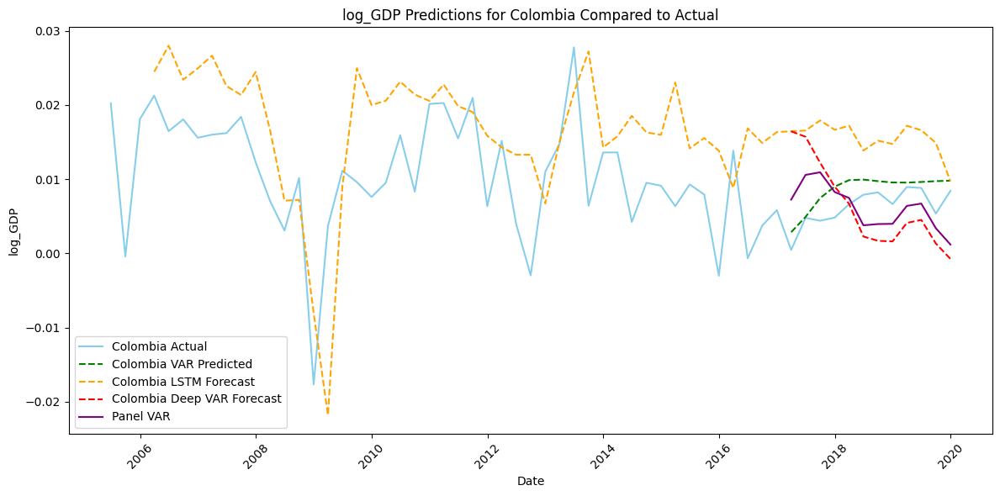

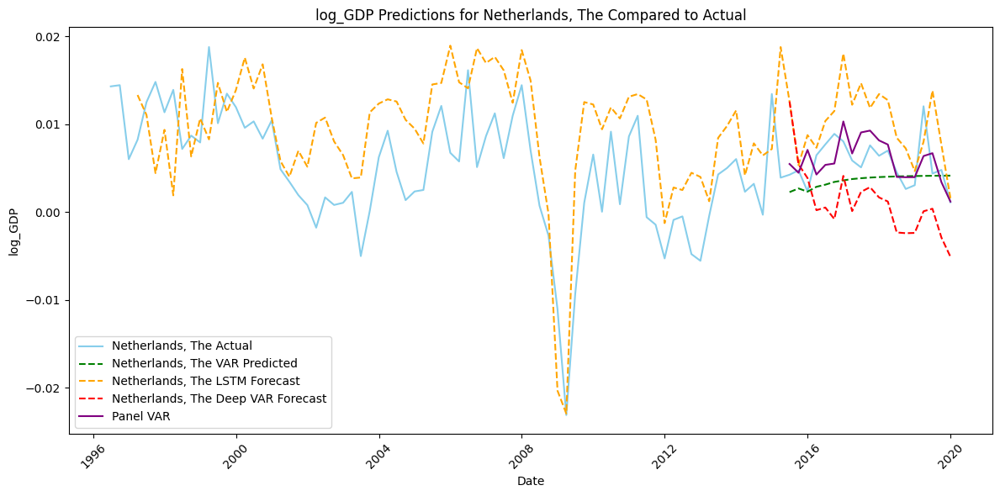

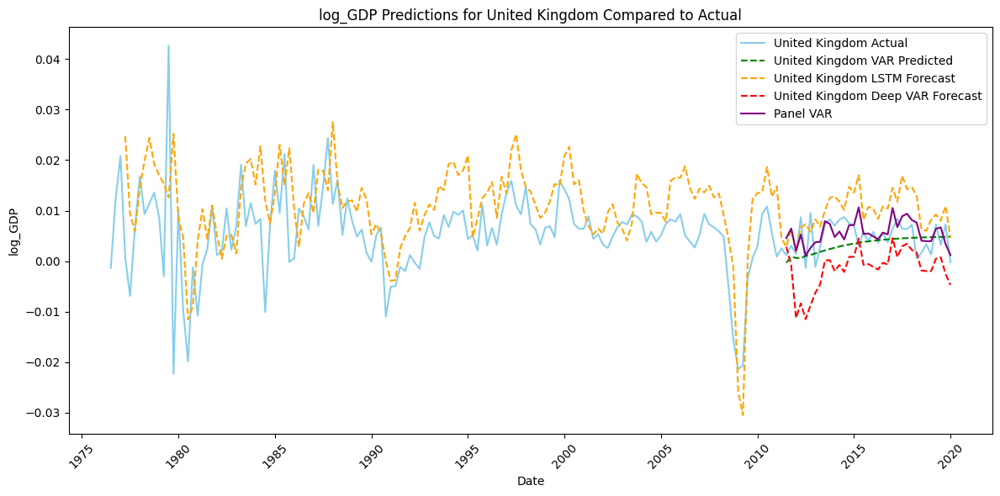

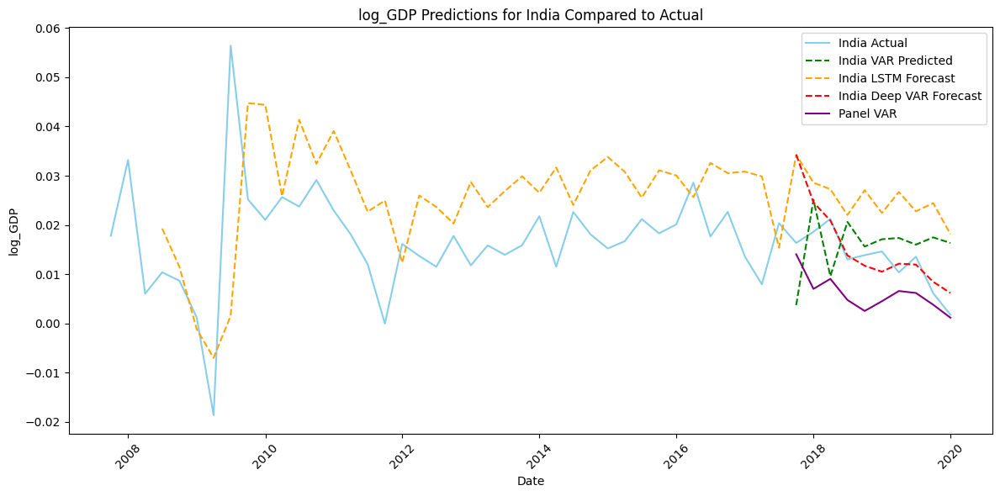

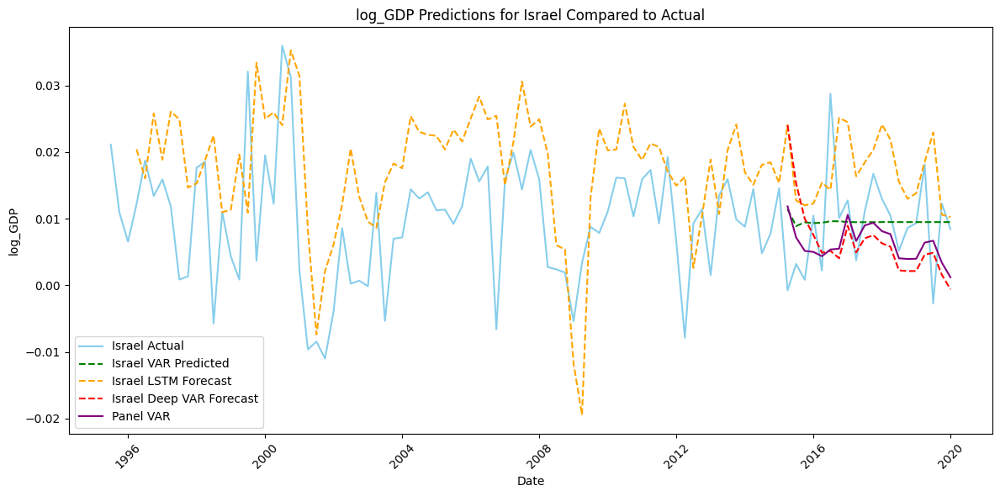

...

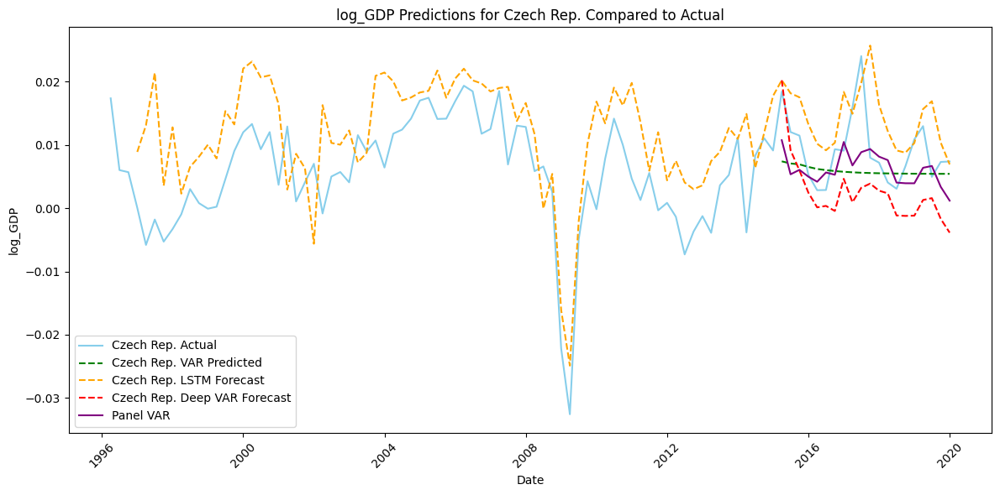

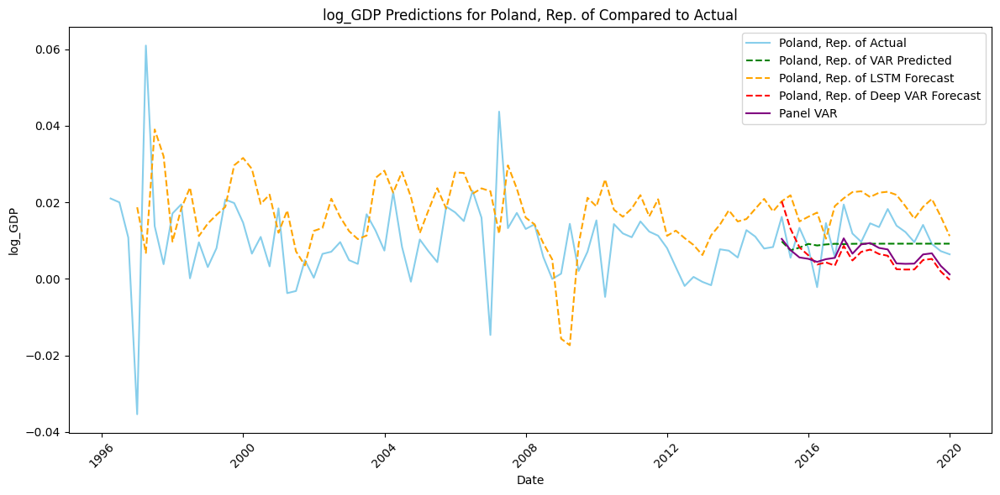

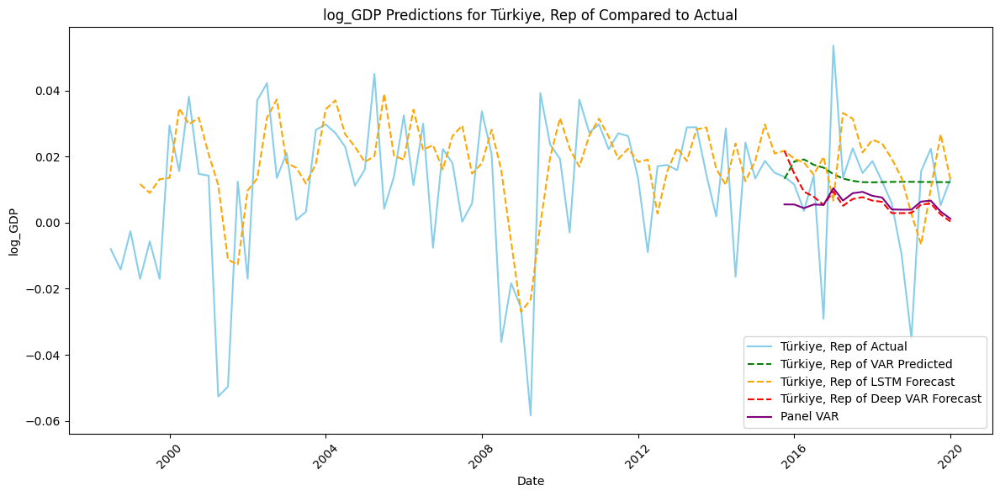

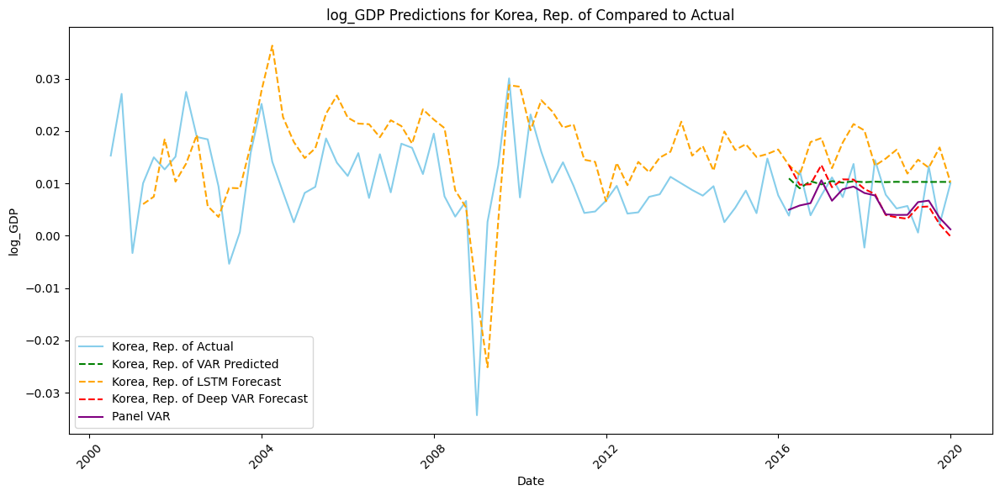

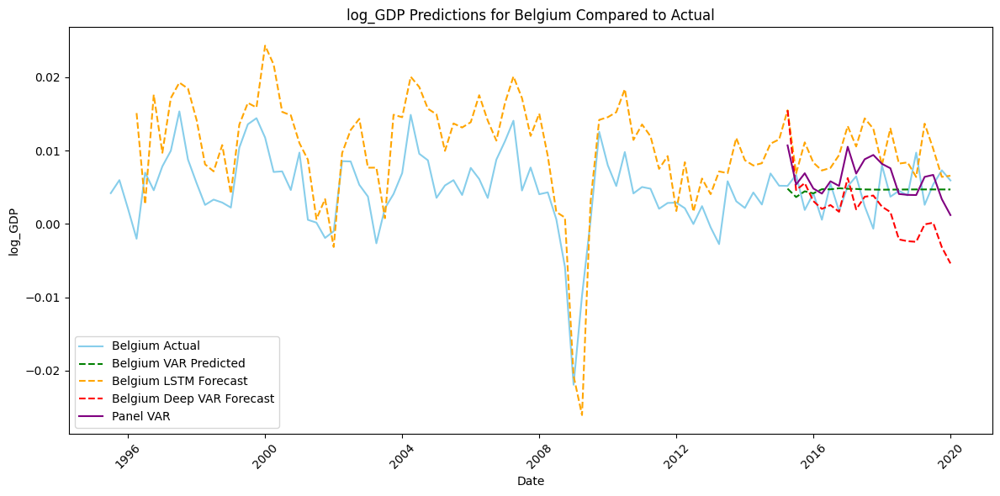

In [18]:
countries = lstm_df.index.get_level_values("Country").unique()
from var import var
def plot_country_predictions_test(country, variable, inputs, lags, df, dict, train_dt_var, test_dt_var, final_detrend, cross_sectional_means, country_means, panel_predictions, train_fraction=0.8):
    country_data = hp.get_country(df, country)
    country_var_detrend_predict, _ = var.get_VAR_predict(final_detrend, train_dt_var, test_dt_var, country, lags)

    # Get panel VAR predictions and add back means
    panel_predictions_country = hp.get_country(panel_predictions, country)
    panel_predictions_adjusted = panel_predictions_country.copy()
    panel_predictions_adjusted[variable] = panel_predictions_adjusted[variable] + cross_sectional_means[variable]

    # LSTM predictions 
    country_test_data = hp.get_test_data(country_data, train_fraction=train_fraction)
    lstm_predict = lstm.fill_forecast_values(country_data, inputs, variable, dict)
    lstm_predict = lstm_predict + cross_sectional_means+country_means

    # Deep var predictions
    steps_to_predict = len(country_test_data)
    deepvar_predict_dict = deepvar.autoregressive_predict(country_test_data, inputs, steps_to_predict, dict, lags)
    deepvar_predict = deepvar_predict_dict[variable]
    
    deepvar_predict_df = pd.DataFrame(
        deepvar_predict, 
        index=country_test_data.index,
        columns=[variable]
    )
    
    deepvar_predict_df[variable] = deepvar_predict_df[variable] + cross_sectional_means[variable]+country_means[variable]

    plt.figure(figsize = (12,6))

    plt.plot(country_data.index.get_level_values('TIME_PERIOD'), country_data[variable], label=f"{country} Actual", color='skyblue')
    plt.plot(country_var_detrend_predict.index.get_level_values('TIME_PERIOD'), country_var_detrend_predict[variable], label=f"{country} VAR Predicted", color='green', linestyle='--')
    plt.plot(lstm_predict.index.get_level_values('TIME_PERIOD'), lstm_predict[variable], label=f"{country} LSTM Forecast", color='orange', linestyle='--')
    plt.plot(deepvar_predict_df.index.get_level_values('TIME_PERIOD'), deepvar_predict_df[variable], label=f"{country} Deep VAR Forecast", color='red', linestyle='--')
    plt.plot(panel_predictions_adjusted.index.get_level_values('TIME_PERIOD'),
              panel_predictions_adjusted[variable], label='Panel VAR', color='purple')
    
    plt.title(f'{variable} Predictions for {country} Compared to Actual')
    plt.xlabel('Date')
    plt.ylabel(f'{variable}')
    
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    
    plt.show()
    
for country in countries:
    plot_country_predictions_test(
        country, 
        'log_GDP', 
        inputs, 
        3, 
        panel_var_df, 
        model_scaler_dict, 
        train_dt_var,
        test_dt_var, 
        final_detrend,
        cross_sectional_means,
        country_means, 
        panel_var_pred
    )


In [19]:
pvar_metrics_gdp = [
    hp.calculate_mse(test_dt_var, pvar_data_metrics_df, 'log_GDP'),
    np.sqrt(hp.calculate_mse(test_dt_var, pvar_data_metrics_df, 'log_GDP')),
    hp.calculate_mae(test_dt_var, pvar_data_metrics_df, 'log_GDP')
]

pvar_metrics_hhd = [
    hp.calculate_mse(test_dt_var, pvar_data_metrics_df, 'household_debt'),
    np.sqrt(hp.calculate_mse(test_dt_var, pvar_data_metrics_df, 'household_debt')),
    hp.calculate_mae(test_dt_var, pvar_data_metrics_df, 'household_debt')
]

improvement_deepvar_vs_var_gdp = calculate_percent_improvement(gdp_deepvar_metrics,pvar_metrics_gdp)
print("GDP model improvement",improvement_deepvar_vs_var_gdp)


improvement_deepvar_vs_var_hhd = calculate_percent_improvement(hhd_deepvar_metrics, pvar_metrics_hhd)
print("household debt model improvement",improvement_deepvar_vs_var_hhd)

GDP model improvement {'total_mse': 15.47321954412756, 'rmse': 8.06155295205795, 'total_mae': 12.477265258930386}
household debt model improvement {'total_mse': 7.6333357945448075, 'rmse': 3.8924226684205663, 'total_mae': 0.21953811834578524}


In [20]:
GDP_var_metrics = var.get_test_errors(final_detrend, train_dt_var, test_dt_var, LAGS, 'log_GDP')
hhd_var_metrics = var.get_test_errors(final_detrend, train_dt_var, test_dt_var, LAGS, 'household_debt')

improvement_deepvar_vs_var_gdp = calculate_percent_improvement(gdp_deepvar_metrics,GDP_var_metrics )
print("GDP model improvement",improvement_deepvar_vs_var_gdp)


improvement_deepvar_vs_var_hhd = calculate_percent_improvement(hhd_deepvar_metrics, hhd_var_metrics)
print("household debt model improvement",improvement_deepvar_vs_var_hhd)


GDP model improvement {'total_mse': -26.158073154055955, 'rmse': -12.320110912541386, 'total_mae': -30.111478392561036}
household debt model improvement {'total_mse': 27.433400156932642, 'rmse': 14.813968373290583, 'total_mae': 11.569202253184994}


In [21]:
gdp_latex = hp.create_model_comparison_latex_table(gdp_deepvar_metrics, GDP_var_metrics, pvar_metrics_gdp)


hhd_latex = hp.create_model_comparison_latex_table(hhd_deepvar_metrics, hhd_var_metrics, pvar_metrics_hhd)

In [22]:
# gdp_latex 

In [23]:
hhd_latex

'\\begin{table}[htbp]\n\\centering\n\\caption{Model Performance Comparison}\n\\begin{tabular}{lccc}\n\\hline\n\\textbf{Metric} & \\textbf{DeepVAR} & \\textbf{VAR} & \\textbf{Panel VAR} \\\\\n\\hline\nMean Squared Error (MSE) & 0.378896 & 0.522135 & 0.410208  \\\\\nRoot Mean Squared Error (RMSE) & 0.615545 & 0.722589 & 0.640475  \\\\\nMean Absolute Error (MAE) & 0.455472 & 0.515060 & 0.456474  \\\\\n\\hline\n\\end{tabular}\n\\end{table}'

In [24]:
# # ... existing code ...
# import deepvar.hyperopt as hyperopt
# import time

# # Define the variables you want to optimize
# variables = final_detrend.columns  # ['household_debt', 'log_GDP']

# # Start timer to track optimization time
# start_time = time.time()

# print("Starting hyperparameter optimization for DeepVAR models...")
# # Run hyperparameter optimization for all variables
# best_params = hyperopt.optimize_all_variables(
#     df=lstm_df,  # Your training dataframe
#     variables=variables,  # Variables to predict
#     inputs=inputs,  # Input features
#     n_trials=30  # Number of trials per variable (adjust based on your time constraints)
# )

# # Print optimization time
# optimization_time = time.time() - start_time
# print(f"Hyperparameter optimization completed in {optimization_time:.2f} seconds")

# # Print the best hyperparameters for each variable
# for var, params in best_params.items():
#     print(f"\nBest hyperparameters for {var}:")
#     for param_name, param_value in params.items():
#         print(f"  {param_name}: {param_value}")

# # Train models with the optimized hyperparameters
# print("\nTraining DeepVAR models with optimized hyperparameters...")
# optimized_model_dict = {}

# for var in variables:
#     print(f"Training model for {var} with optimized hyperparameters...")
#     params = best_params[var]
    
#     model_params = {
#         'learning_rate': params['learning_rate'],
#         'hidden_size': params['hidden_size'],
#         'dropout': params['dropout'],
#         'weight_decay': params['weight_decay'],
#         'batch_size': params['batch_size'],
#         'num_epochs': 500  # Use a fixed number of epochs
#     }
    
#     # Train the model with the optimized parameters
#     model, predictions, metrics, scaler_X, scaler_y = lstm.train_lstm_model(
#         lstm_df, 
#         inputs, 
#         [var], 
#         **model_params
#     )
    
#     # Store in the format expected by autoregressive_predict
#     optimized_model_dict[var] = (model, predictions, metrics, scaler_X, scaler_y)

# # Now you can use these optimized models for prediction and evaluation
# print("\nEvaluating optimized DeepVAR models...")

# # Calculate test errors for the optimized models
# gdp_optimized_metrics = test_errors(
#     lstm_df, lstm_test, test_dt_var, 'log_GDP', 
#     optimized_model_dict, inputs, LAGS, 
#     cross_sectional_means, country_means
# )

# hhd_optimized_metrics = test_errors(
#     lstm_df, lstm_test, test_dt_var, 'household_debt', 
#     optimized_model_dict, inputs, LAGS, 
#     cross_sectional_means, country_means
# )

# # Compare the optimized models with the previous models
# print("\nComparison of model performance:")
# print("\nGDP Model:")
# print(f"{'Metric':<25} {'Original DeepVAR':<15} {'Optimized DeepVAR':<15}")
# print(f"{'MSE':<25} {gdp_deepvar_metrics[0]:<15.6f} {gdp_optimized_metrics[0]:<15.6f}")
# print(f"{'RMSE':<25} {gdp_deepvar_metrics[1]:<15.6f} {gdp_optimized_metrics[1]:<15.6f}")
# print(f"{'MAE':<25} {gdp_deepvar_metrics[2]:<15.6f} {gdp_optimized_metrics[2]:<15.6f}")

# print("\nHousehold Debt Model:")
# print(f"{'Metric':<25} {'Original DeepVAR':<15} {'Optimized DeepVAR':<15}")
# print(f"{'MSE':<25} {hhd_deepvar_metrics[0]:<15.6f} {hhd_optimized_metrics[0]:<15.6f}")
# print(f"{'RMSE':<25} {hhd_deepvar_metrics[1]:<15.6f} {hhd_optimized_metrics[1]:<15.6f}")
# print(f"{'MAE':<25} {hhd_deepvar_metrics[2]:<15.6f} {hhd_optimized_metrics[2]:<15.6f}")

# # Calculate improvement percentages
# gdp_improvement = {
#     'MSE': ((gdp_deepvar_metrics[0] - gdp_optimized_metrics[0]) / gdp_deepvar_metrics[0]) * 100,
#     'RMSE': ((gdp_deepvar_metrics[1] - gdp_optimized_metrics[1]) / gdp_deepvar_metrics[1]) * 100,
#     'MAE': ((gdp_deepvar_metrics[2] - gdp_optimized_metrics[2]) / gdp_deepvar_metrics[2]) * 100
# }

# hhd_improvement = {
#     'MSE': ((hhd_deepvar_metrics[0] - hhd_optimized_metrics[0]) / hhd_deepvar_metrics[0]) * 100,
#     'RMSE': ((hhd_deepvar_metrics[1] - hhd_optimized_metrics[1]) / hhd_deepvar_metrics[1]) * 100,
#     'MAE': ((hhd_deepvar_metrics[2] - hhd_optimized_metrics[2]) / hhd_deepvar_metrics[2]) * 100
# }

# print("\nImprovement with optimized hyperparameters:")
# print("\nGDP Model:")
# print(f"{'Metric':<25} {'Improvement (%)':<15}")
# print(f"{'MSE':<25} {gdp_improvement['MSE']:<15.2f}")
# print(f"{'RMSE':<25} {gdp_improvement['RMSE']:<15.2f}")
# print(f"{'MAE':<25} {gdp_improvement['MAE']:<15.2f}")

# print("\nHousehold Debt Model:")
# print(f"{'Metric':<25} {'Improvement (%)':<15}")
# print(f"{'MSE':<25} {hhd_improvement['MSE']:<15.2f}")
# print(f"{'RMSE':<25} {hhd_improvement['RMSE']:<15.2f}")
# print(f"{'MAE':<25} {hhd_improvement['MAE']:<15.2f}")


In [29]:
num_variables_deepvar = len(inputs)
df_zeros = pd.DataFrame(np.zeros((1, num_variables_deepvar)), columns=inputs)


In [30]:
# Get standard deviations for the variables
std_devs = lstm_df[['household_debt', 'log_GDP']].std()
print("Standard deviations of variables:")
print(std_devs)

std_multipliers = [-3, -2, -1, 1, 2, 3]

household_debt_shocks = {m: std_devs['household_debt'] * m for m in std_multipliers}
log_gdp_shocks = {m: std_devs['log_GDP'] * m for m in std_multipliers}

print(f"-3 std dev shock for household debt: {household_debt_shocks[-3]}")

Standard deviations of variables:
household_debt    0.738476
log_GDP           0.009769
dtype: float64
-3 std dev shock for household debt: -2.2154266791664345


In [31]:
hp.get_country(lstm_df[['household_debt', 'log_GDP']], "United States").mean()

household_debt   -0.225395
log_GDP          -0.007443
dtype: float64

In [33]:
def plot_irf_with_multiple_shocks(df_zeros, inputs, shock_var, response_var, 
                                 model_dict, lags, periods=10, 
                                 std_multipliers=None, figsize=(14, 8)):
    
    base_var = shock_var.split('_lag')[0]
    response_base_var = response_var
    
    
    std_devs = lstm_df[[base_var, response_base_var]].std()
    
    if std_multipliers is None:
        std_multipliers = [-3, -2, -1, 1, 2, 3]
    
    # Sort multipliers from negative to positive
    std_multipliers.sort()
    
    # Create shock sizes
    shock_sizes = [std_devs[base_var] * m for m in std_multipliers]
    

    fig, ax = plt.subplots(figsize=figsize)
    
    colors = plt.cm.coolwarm(np.linspace(0, 1, len(std_multipliers)))
    
    # Plot IRFs for different shock sizes
    for i, (mult, shock, color) in enumerate(zip(std_multipliers, shock_sizes, colors)):
        irf_result = irf.predict(df_zeros, inputs, shock_var, shock, response_var, periods, model_dict, lags)
        label = f'{mult:+d} std dev shock ({shock:.4f})'
        ax.plot(irf_result, label=label, color=color, linewidth=2)
    
    ax.axhline(y=0, color='k', linestyle='-', alpha=0.3)
    
    shock_name = base_var.replace('_', ' ').title()
    response_name = response_var.replace('_', ' ').title()
    
    if response_var == 'log_GDP':
        response_label = '%Δ GDP'
    else:
        response_label = f'Δ {response_name}'
        
    ax.set_title(f'{response_name} Response to {shock_name} Shocks')
    ax.set_xlabel('Periods')
    ax.set_ylabel(response_label)
    
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    
std_multipliers = [-3, -2, -1, 1, 2, 3]




Evaluating models with 1 lags...
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
      

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_datal

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 1:
  learning_rate: 0.000124530028757876
  hidden_size: 16
  num_layers: 3
  dropout: 0.1
  weight_decay: 0.01
  batch_size: 64

Best hyperparameters for household_debt with lag 1:
  learning_rate: 2.2139290514335146e-05
  hidden_size: 16
  num_layers: 1
  dropout: 0.4
  weight_decay: 0.0001
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 524.50it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_6fd6c0a6-0480-49ad-84f6-9f7c9addaa2c.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_6fd6c0a6-0480-49ad-84f6-9f7c9addaa2c.ckpt


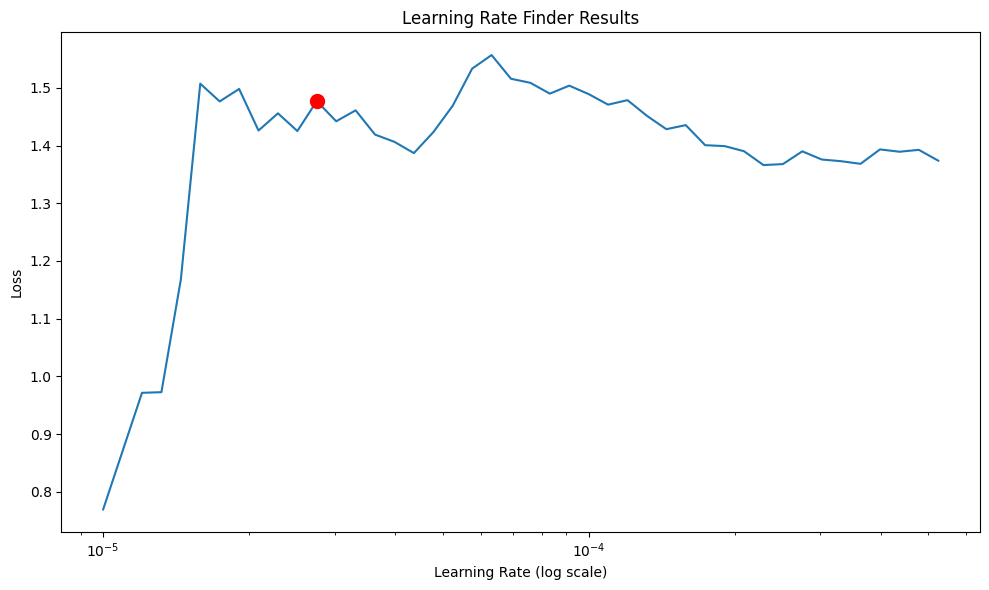

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 395.84it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 383.99it/s]
Learning rate set to 0.00015848931924611134
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_52ee23ad-d321-4b45-b04e-dc21f82c6fd9.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_52ee23ad-d321-4b45-b04e-dc21f82c6fd9.ckpt


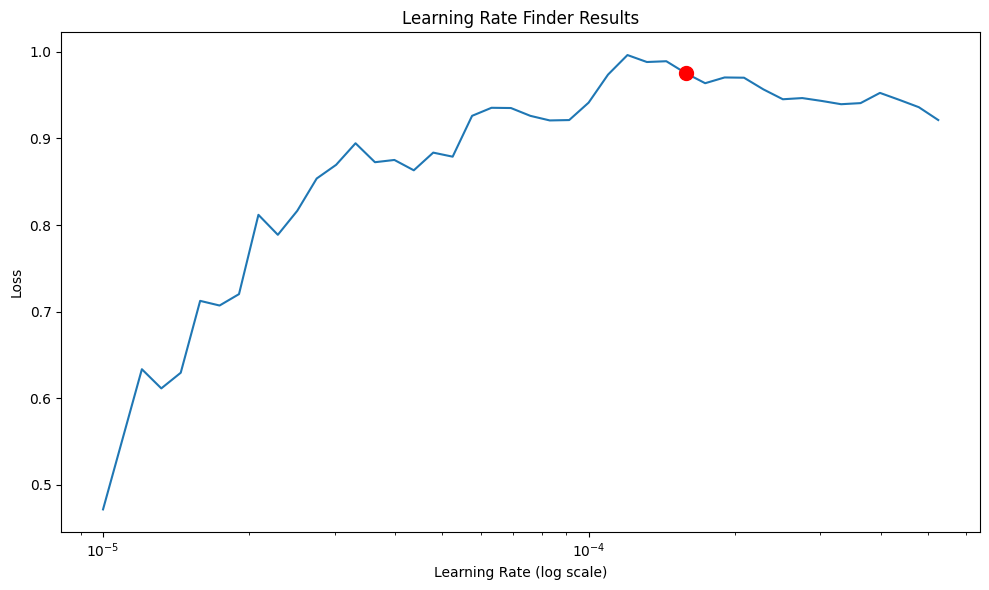

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00015849


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Evaluating models with 2 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.0004

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 2:
  learning_rate: 3.2608676315898125e-05
  hidden_size: 32
  num_layers: 1
  dropout: 0.1
  weight_decay: 0.0001
  batch_size: 32

Best hyperparameters for household_debt with lag 2:
  learning_rate: 0.0007053932086065256
  hidden_size: 128
  num_layers: 2
  dropout: 0.4
  weight_decay: 0.001
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 567.74it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_cc89482b-b1a4-4d9d-8482-c0702e6ebe4e.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_cc89482b-b1a4-4d9d-8482-c0702e6ebe4e.ckpt


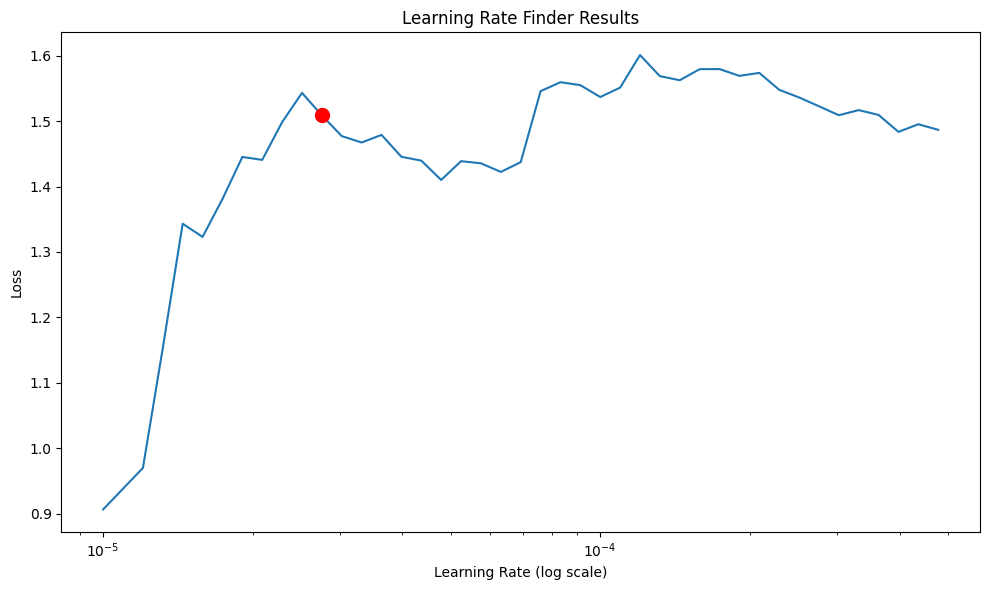

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 507.14it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_ada10800-9d93-4bd2-ad10-cfd2dbe9378e.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_ada10800-9d93-4bd2-ad10-cfd2dbe9378e.ckpt


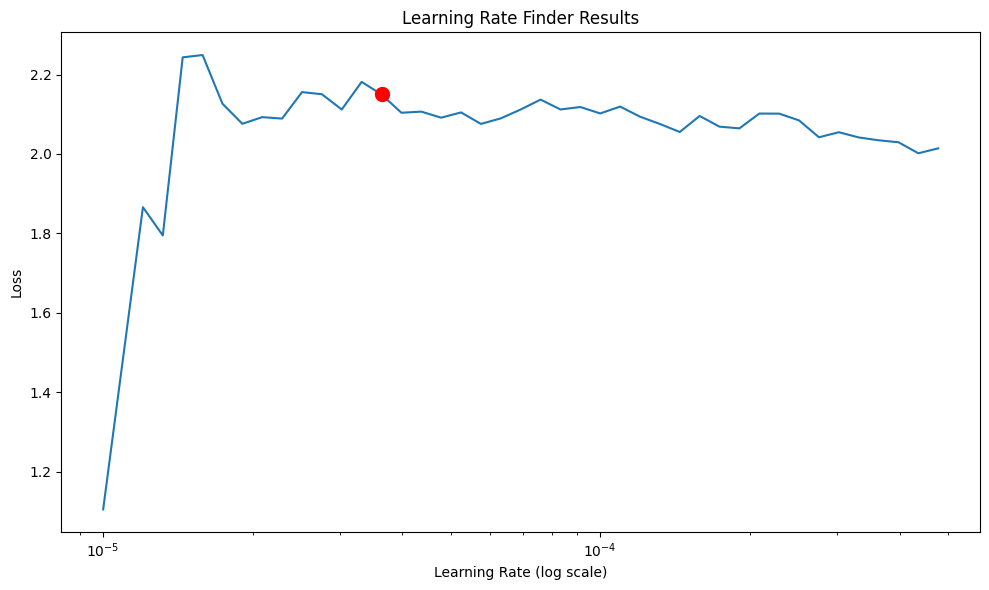

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Evaluating models with 3 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.0

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 3:
  learning_rate: 7.632650312419136e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.3
  weight_decay: 0.001
  batch_size: 128

Best hyperparameters for household_debt with lag 3:
  learning_rate: 0.002807989493033735
  hidden_size: 64
  num_layers: 2
  dropout: 0.3
  weight_decay: 0.001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 562.09it/s]
Learning rate set to 5.248074602497726e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_111a3a39-ec7e-4fbb-86d5-5917648306d5.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_111a3a39-ec7e-4fbb-86d5-5917648306d5.ckpt


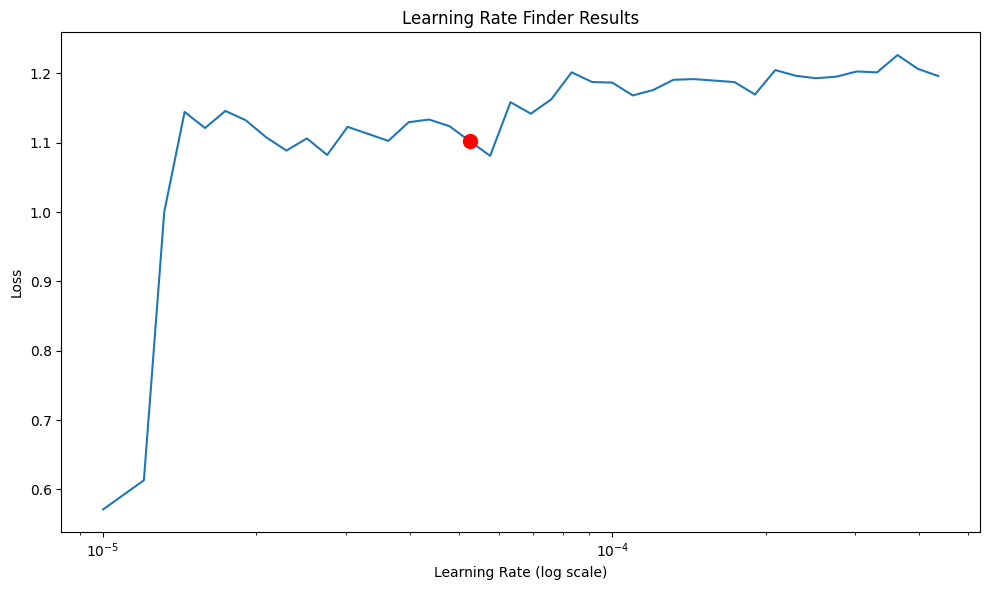

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00005248


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:  30%|███       | 30/100 [00:00<00:00, 292.04it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 292.58it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_e70a845a-504a-4758-aff4-cf9e905d2644.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_e70a845a-504a-4758-aff4-cf9e905d2644.ckpt


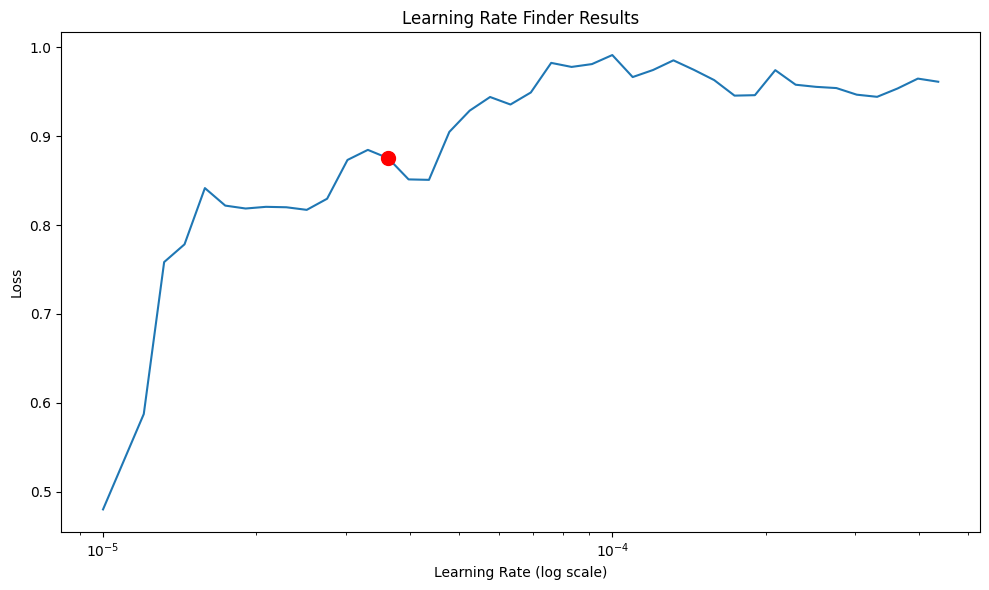

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Evaluating models with 4 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2 

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
Starting hyperparameter optimization for lag 4...
Optimizing hyperparameters for log_GDP


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 4:
  learning_rate: 0.008634130756078053
  hidden_size: 128
  num_layers: 2
  dropout: 0.4
  weight_decay: 0.01
  batch_size: 16

Best hyperparameters for household_debt with lag 4:
  learning_rate: 6.358676919106686e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.5
  weight_decay: 0.01
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:  33%|███▎      | 33/100 [00:00<00:00, 329.63it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 344.01it/s]
Learning rate set to 0.00019054607179632476
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8cb1f1f7-02f3-4ade-aecc-453c3d8ff845.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8cb1f1f7-02f3-4ade-aecc-453c3d8ff845.ckpt


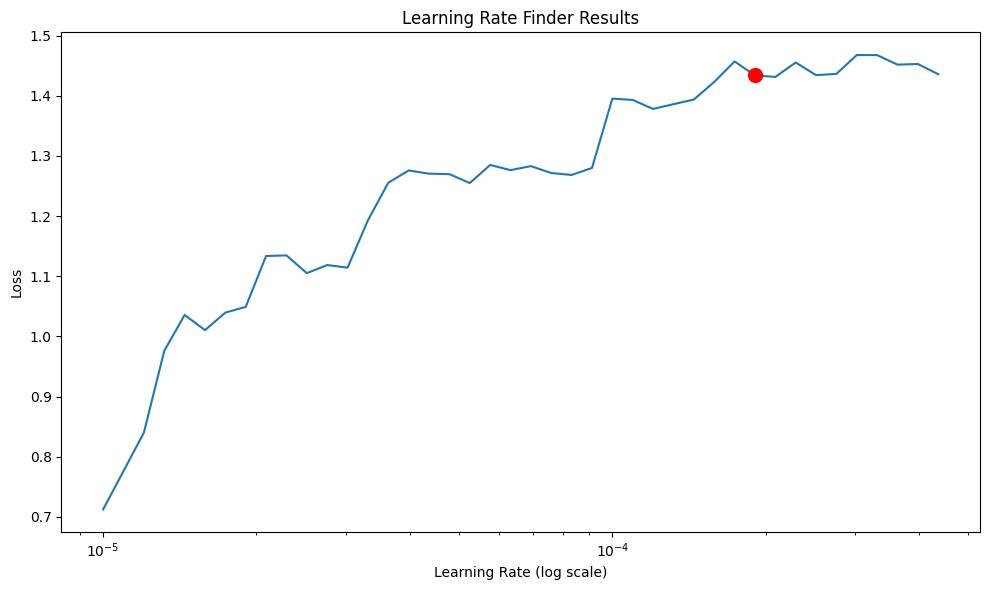

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00019055


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 628.46it/s]
Learning rate set to 3.981071705534973e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_075033b2-9960-463a-b833-74bdd42168c0.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_075033b2-9960-463a-b833-74bdd42168c0.ckpt


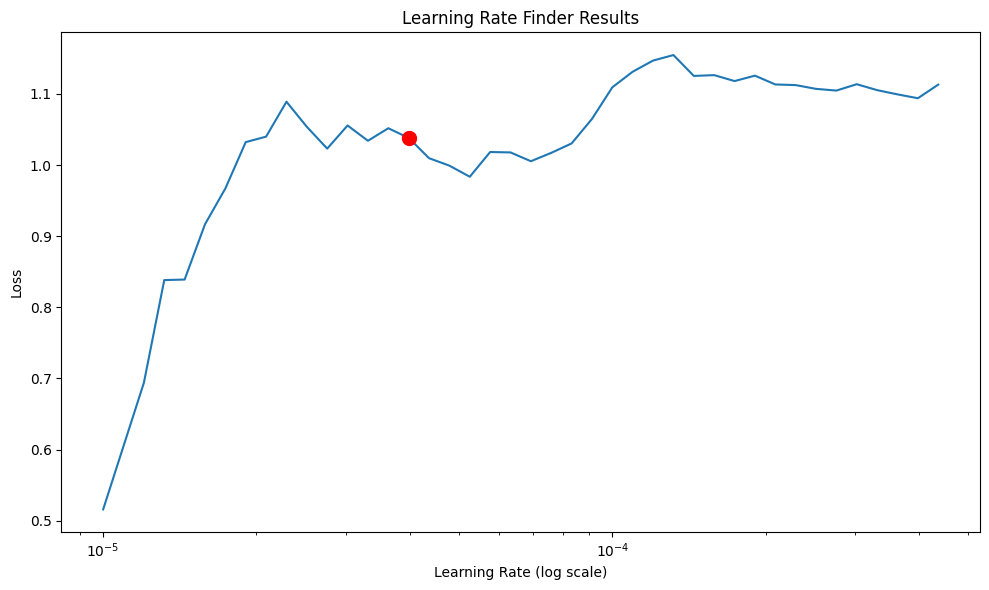

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003981


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 5 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 5:
  learning_rate: 0.000802393294134418
  hidden_size: 16
  num_layers: 3
  dropout: 0.1
  weight_decay: 1e-05
  batch_size: 16

Best hyperparameters for household_debt with lag 5:
  learning_rate: 3.341250538506166e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.4
  weight_decay: 1e-05
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 602.44it/s]
Learning rate set to 5.75439937337157e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_aaa24994-c7cf-453b-bcea-bf4c5bbfdeb7.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_aaa24994-c7cf-453b-bcea-bf4c5bbfdeb7.ckpt


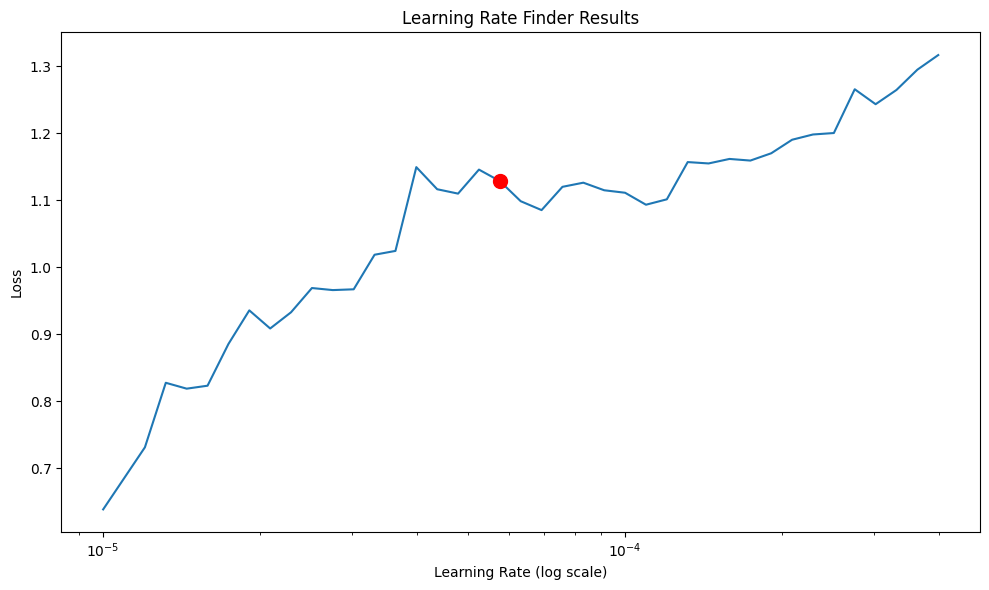

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 593.46it/s]
Learning rate set to 6.309573444801933e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_c5712736-5f48-4f9c-99ed-871ae60ea94e.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_c5712736-5f48-4f9c-99ed-871ae60ea94e.ckpt


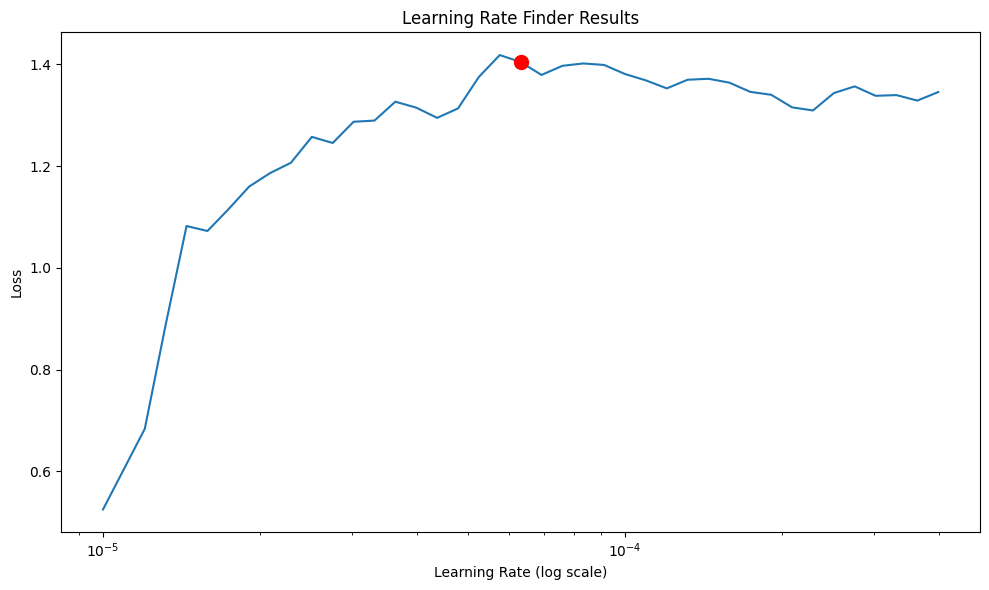

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00006310


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 6 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.1694

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 6:
  learning_rate: 0.0002941732902159602
  hidden_size: 32
  num_layers: 2
  dropout: 0.3
  weight_decay: 0.0001
  batch_size: 64

Best hyperparameters for household_debt with lag 6:
  learning_rate: 0.0021761010939584722
  hidden_size: 64
  num_layers: 2
  dropout: 0.4
  weight_decay: 0.0001
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 493.29it/s]
Learning rate set to 9.120108393559098e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_e7e5ad1e-fdc4-40cf-b387-4b34c8e944e8.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_e7e5ad1e-fdc4-40cf-b387-4b34c8e944e8.ckpt


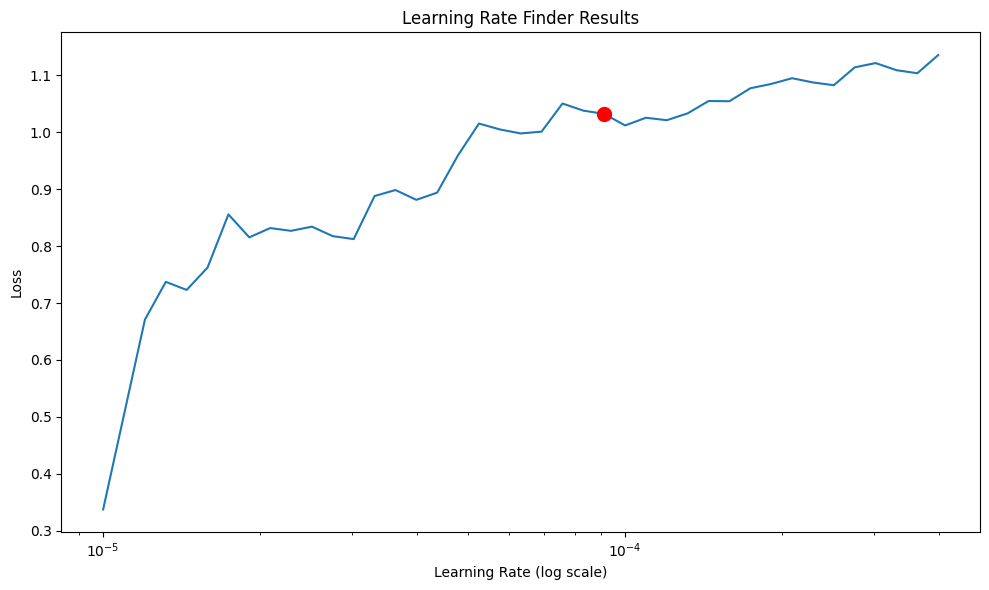

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00009120


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 576.31it/s]
Learning rate set to 0.00013182567385564074
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_7b0dc9eb-4b35-4b24-93d2-f23af6e6c112.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_7b0dc9eb-4b35-4b24-93d2-f23af6e6c112.ckpt


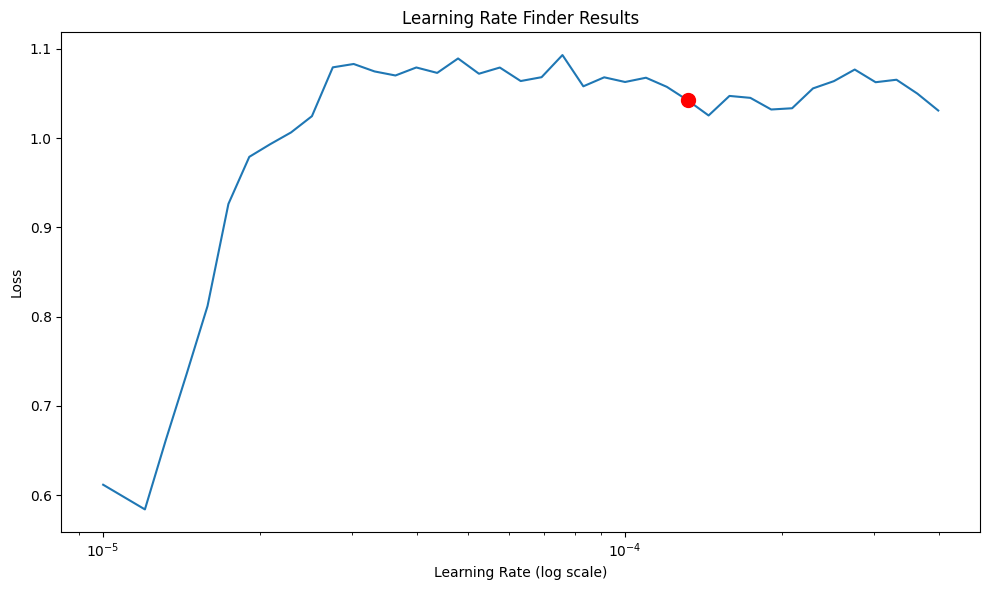

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00013183


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.


In [34]:

def evaluate_models_with_lags(final_detrend, train_dt_var, test_dt_var, variables, 
                             max_lags=6, n_trials=20, seed=42):
    """
    Evaluate VAR, Panel VAR, and DeepVAR models with different lag lengths
    
    Parameters:
    -----------
    final_detrend : DataFrame
        Detrended data
    train_dt_var : DataFrame
        Training data
    test_dt_var : DataFrame
        Test data
    variables : list
        List of variables to evaluate
    max_lags : int
        Maximum number of lags to evaluate
    n_trials : int
        Number of hyperparameter optimization trials
    seed : int
        Random seed for reproducibility
    
    Returns:
    --------
    tuple
        (results_dict, optimized_models_dict)
    """

    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    
    # Also set the seed for Optuna
    optuna.logging.set_verbosity(optuna.logging.WARNING)
    
    results = {
        'VAR': {var_name: {lag: {} for lag in range(1, max_lags+1)} for var_name in variables},
        'PVAR': {var_name: {lag: {} for lag in range(1, max_lags+1)} for var_name in variables},
        'DeepVAR': {var_name: {lag: {} for lag in range(1, max_lags+1)} for var_name in variables}
    }
    optimized_models_by_lag = {}
    
    for lag in range(1, max_lags+1):
        print(f"\nEvaluating models with {lag} lags...")
        
        # For each lag length, create a new lstm_df with the appropriate number of lags
        demeaned_df, cross_sectional_means, country_means = deepvar.prepare_data_with_fixed_effects(final_detrend, variables=variables)
        lstm_df = lstm.create_lstm_data(demeaned_df, lag)
        lstm_train, lstm_val, lstm_test = lstm.train_val_test_split(lstm_df)
        
        # Generate inputs for this lag specification
        inputs = lstm.get_lstm_input(final_detrend, lag)
        
        # 1. Evaluate VAR models
        for var_name in variables:
            var_metrics = var.get_test_errors(final_detrend, train_dt_var, test_dt_var, lag, var_name)
            results['VAR'][var_name][lag] = {
                'MSE': var_metrics[0],
                'RMSE': var_metrics[1],
                'MAE': var_metrics[2]
            }
        
        # 2. Evaluate Panel VAR models
        pvar_dict = {
            lag: f'./pvarcoefs_GDPHHD/coef{lag}_GDPHHD.xlsx'
        }
        
        # Create panel VAR data with appropriate lags
        panel_var_df = lstm.create_lstm_data(final_detrend, lag)
        
        # Run panel VAR predictions
        try:
            panel_var_pred, _ = run_panel_VAR_predict_new(panel_var_df, lstm_test, lag, pvar_dict)
            pvar_data_metrics_df = panel_var_pred + cross_sectional_means + country_means
            
            for var_name in variables:
                pvar_metrics = [
                    hp.calculate_mse(test_dt_var, pvar_data_metrics_df, var_name),
                    np.sqrt(hp.calculate_mse(test_dt_var, pvar_data_metrics_df, var_name)),
                    hp.calculate_mae(test_dt_var, pvar_data_metrics_df, var_name)
                ]
                results['PVAR'][var_name][lag] = {
                    'MSE': pvar_metrics[0],
                    'RMSE': pvar_metrics[1],
                    'MAE': pvar_metrics[2]
                }
        except Exception as e:
            print(f"Error evaluating Panel VAR with lag {lag}: {e}")
            # Set default values if Panel VAR fails
            for var_name in variables:
                results['PVAR'][var_name][lag] = {
                    'MSE': float('nan'),
                    'RMSE': float('nan'),
                    'MAE': float('nan')
                }
        
        # 3. Train and evaluate DeepVAR models with hyperparameter optimization
        print(f"Starting hyperparameter optimization for lag {lag}...")
        
        # Set seed for hyperparameter optimization
        lstm.set_seed(seed=seed)
        
        # Create a fixed seed for Optuna study
        optuna_seed = seed + lag  # Different seed for each lag to avoid identical results
        
        # Run hyperparameter optimization for all variables with fixed seed
        best_params = {}
        for variable in variables:
            print(f"Optimizing hyperparameters for {variable}")
            
            # Prepare data with fixed seed
            (X_train, y_train), (X_val, y_val), _, _, _ = lstm.prepare_lstm_data(lstm_df, inputs, [variable])
            
            # Create Optuna study with fixed seed
            sampler = optuna.samplers.TPESampler(seed=optuna_seed)
            study = optuna.create_study(direction="minimize", sampler=sampler)
            
            # Define objective function
            from functools import partial
            objective_func = partial(
                hyperopt.objective,
                X_train=X_train,
                y_train=y_train,
                X_val=X_val,
                y_val=y_val,
                input_size=X_train.shape[2]
            )
            
            # Run optimization
            study.optimize(objective_func, n_trials=n_trials)
            
            # Store best parameters
            best_params[variable] = study.best_params
                
        # print the best hyperparameters for each variable
        for var_name in variables:
            print(f"\nBest hyperparameters for {var_name} with lag {lag}:")
            for param_name, param_value in best_params[var_name].items():
                print(f"  {param_name}: {param_value}")
        
        
        optimized_model_dict = {}
        
        for var_name in variables:
            print(f"Training model for {var_name} with optimized hyperparameters...")
            params = best_params[var_name]
            
            # Reset seed before finding learning rate
            lstm.set_seed(seed=seed)
            
            # Find optimal learning rate
            best_lr = lstm.find_learning_rate(lstm_df, inputs, var_name, min_lr=1e-5, max_lr=1e-1)
            
            model_params = {
                'learning_rate': best_lr,
                'hidden_size': params['hidden_size'],
                'dropout': params['dropout'],
                'weight_decay': params['weight_decay'],
                'batch_size': params['batch_size'],
                'num_epochs': 500  # Use a fixed number of epochs
            }
            
            # Reset seed before training
            lstm.set_seed(seed=seed)
            
            # Train the model with the optimized parameters
            model, predictions, metrics, scaler_X, scaler_y = lstm.train_lstm_model(
                lstm_df, 
                inputs, 
                [var_name], 
                **model_params
            )
            
            # Store in the format expected by autoregressive_predict
            optimized_model_dict[var_name] = (model, predictions, metrics, scaler_X, scaler_y)
        
        optimized_models_by_lag[lag] = {
            'model_dict': optimized_model_dict,
            'inputs': inputs
        }

        # Evaluate DeepVAR models
        for var_name in variables:
            deepvar_metrics = test_errors(
                lstm_df, lstm_test, test_dt_var, var_name, 
                optimized_model_dict, inputs, lag, 
                cross_sectional_means, country_means
            )
            results['DeepVAR'][var_name][lag] = {
                'MSE': deepvar_metrics[0],
                'RMSE': deepvar_metrics[1],
                'MAE': deepvar_metrics[2]
            }
    
    return results, optimized_models_by_lag

def create_latex_table_from_results(results, variables):
    """
    Create a LaTeX table from the evaluation results
    """
    latex_tables = {}
    
    for var_name in variables:
        latex = "\\begin{table}[htbp]\n"
        latex += "\\centering\n"
        latex += f"\\caption{{Performance Comparison for {var_name}}}\n"
        latex += "\\begin{tabular}{lccccccc}\n"
        latex += "\\hline\n"
        latex += "\\textbf{Model} & \\textbf{Metric} & \\textbf{Lag 1} & \\textbf{Lag 2} & \\textbf{Lag 3} & \\textbf{Lag 4} & \\textbf{Lag 5} & \\textbf{Lag 6} \\\\\n"
        latex += "\\hline\n"
        
        for model in ['VAR', 'PVAR', 'DeepVAR']:
            # MSE row
            latex += f"{model} & MSE "
            for lag in range(1, 7):
                if lag in results[model][var_name]:
                    latex += f"& {results[model][var_name][lag]['MSE']:.6f} "
                else:
                    latex += "& - "
            latex += "\\\\\n"
            
            # RMSE row
            latex += f" & RMSE "
            for lag in range(1, 7):
                if lag in results[model][var_name]:
                    latex += f"& {results[model][var_name][lag]['RMSE']:.6f} "
                else:
                    latex += "& - "
            latex += "\\\\\n"
            
            # MAE row
            latex += f" & MAE "
            for lag in range(1, 7):
                if lag in results[model][var_name]:
                    latex += f"& {results[model][var_name][lag]['MAE']:.6f} "
                else:
                    latex += "& - "
            latex += "\\\\\n"
            
            
            if model != 'DeepVAR':
                latex += "\\hline\n"
        
        latex += "\\hline\n"
        latex += "\\end{tabular}\n"
        latex += "\\end{table}"
        
        latex_tables[var_name] = latex
    
    return latex_tables

max_lags_to_evaluate = 6
variables_to_evaluate = ['log_GDP', 'household_debt']

# takes a while to run
all_results, model_dict_1 = evaluate_models_with_lags(
    final_detrend, 
    train_dt_var, 
    test_dt_var, 
    variables_to_evaluate, 
    max_lags=max_lags_to_evaluate,
)



In [35]:
# Best hyperparameters for log_GDP with lag 1:
#   learning_rate: 0.000124530028757876
#   hidden_size: 16
#   num_layers: 3
#   dropout: 0.1
#   weight_decay: 0.01
#   batch_size: 64

# Best hyperparameters for household_debt with lag 1:
#   learning_rate: 2.2139290514335146e-05
#   hidden_size: 16
#   num_layers: 1
#   dropout: 0.4
#   weight_decay: 0.0001
#   batch_size: 128


# Best hyperparameters for log_GDP with lag 1:
#   learning_rate: 0.00023974709913404535
#   hidden_size: 16
#   num_layers: 3
#   dropout: 0.1
#   weight_decay: 0.0001
#   batch_size: 64

# Best hyperparameters for household_debt with lag 1:
#   learning_rate: 0.0003344036652141134
#   hidden_size: 64
#   num_layers: 1
#   dropout: 0.2
#   weight_decay: 1e-05
#   batch_size: 64

   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  log_GDP_lag5  \
0           0.0           0.0           0.0           0.0           0.0   

   log_GDP_lag6  household_debt_lag1  household_debt_lag2  \
0           0.0                  0.0                  0.0   

   household_debt_lag3  household_debt_lag4  household_debt_lag5  \
0                  0.0                  0.0                  0.0   

   household_debt_lag6  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  log_GDP_lag5  \
0           0.0           0.0           0.0           0.0           0.0   

   log_GDP_lag6  household_debt_lag1  household_debt_lag2  \
0           0.0                  0.0                  0.0   

   household_debt_lag3  household_debt_lag4  household_debt_lag5  \
0                  0.0                  0.0                  0.0   

   household_debt_lag6  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  log_GDP_lag5  \
0  

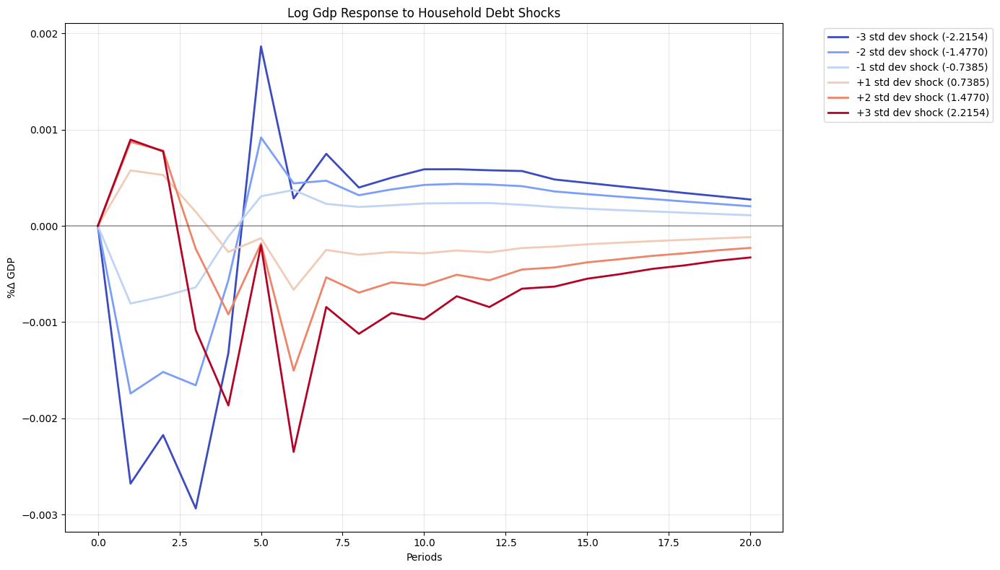

In [37]:
for lag in range(1,2):
    lag = 6
    lag_inputs = model_dict_1[lag]['inputs']
    df_zeros = pd.DataFrame(np.zeros((1, len(lag_inputs))), columns=lag_inputs)
    plot_irf_with_multiple_shocks(
        df_zeros, 
        lag_inputs,  
        'household_debt_lag1', 
        'log_GDP', 
        model_dict_1[lag]['model_dict'], 
        lag,  
        periods=20, 
        std_multipliers=std_multipliers
    )


Seed Robustness Check


Evaluating models with 1 lags...
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
      

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
Starting hyperparameter optimization for lag 1...
Optimizing hyperparameters for log_GDP


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 1:
  learning_rate: 3.679193455922983e-05
  hidden_size: 128
  num_layers: 2
  dropout: 0.2
  weight_decay: 0.001
  batch_size: 128

Best hyperparameters for household_debt with lag 1:
  learning_rate: 3.073406119970331e-05
  hidden_size: 64
  num_layers: 1
  dropout: 0.5
  weight_decay: 0.01
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 603.70it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_c337fb22-4fad-40d1-95c6-2a03d996ce68.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_c337fb22-4fad-40d1-95c6-2a03d996ce68.ckpt


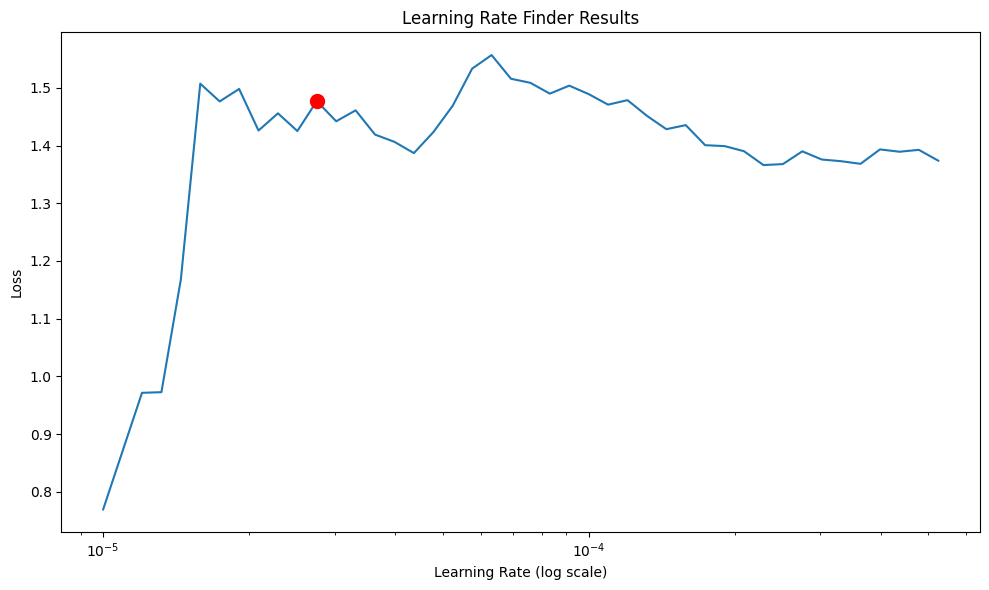

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 597.07it/s]
Learning rate set to 0.00015848931924611134
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_7da6ac8b-aa60-476c-9f98-ea1169f25bf0.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_7da6ac8b-aa60-476c-9f98-ea1169f25bf0.ckpt


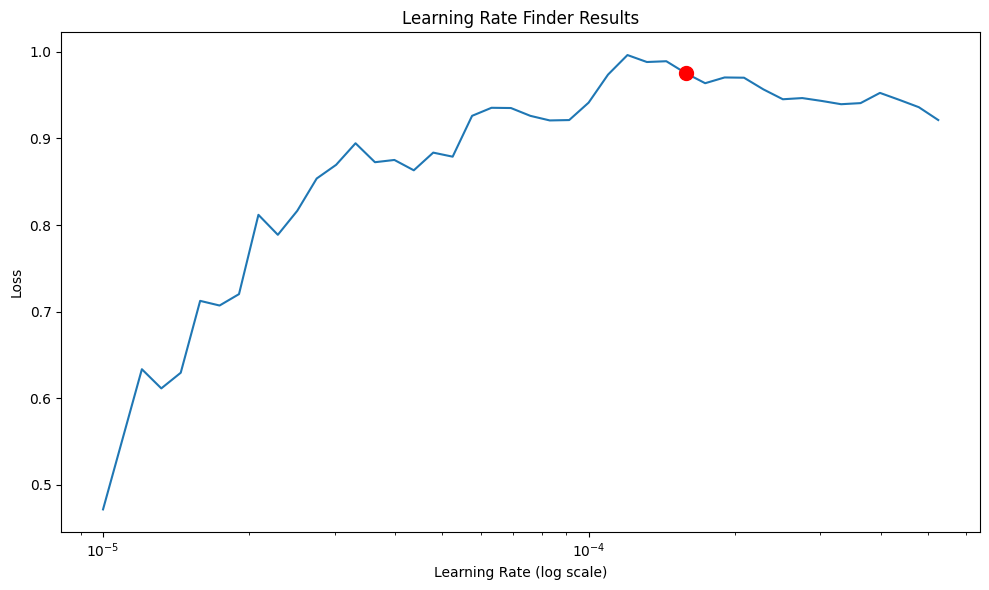

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00015849


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 2 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.0004

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/conn

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 2:
  learning_rate: 0.00031858376554709804
  hidden_size: 16
  num_layers: 3
  dropout: 0.4
  weight_decay: 0.001
  batch_size: 64

Best hyperparameters for household_debt with lag 2:
  learning_rate: 4.7769834248117706e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.1
  weight_decay: 1e-05
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 637.53it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_a2d1cccf-d506-42a4-99e5-cdcadb4dcde0.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_a2d1cccf-d506-42a4-99e5-cdcadb4dcde0.ckpt


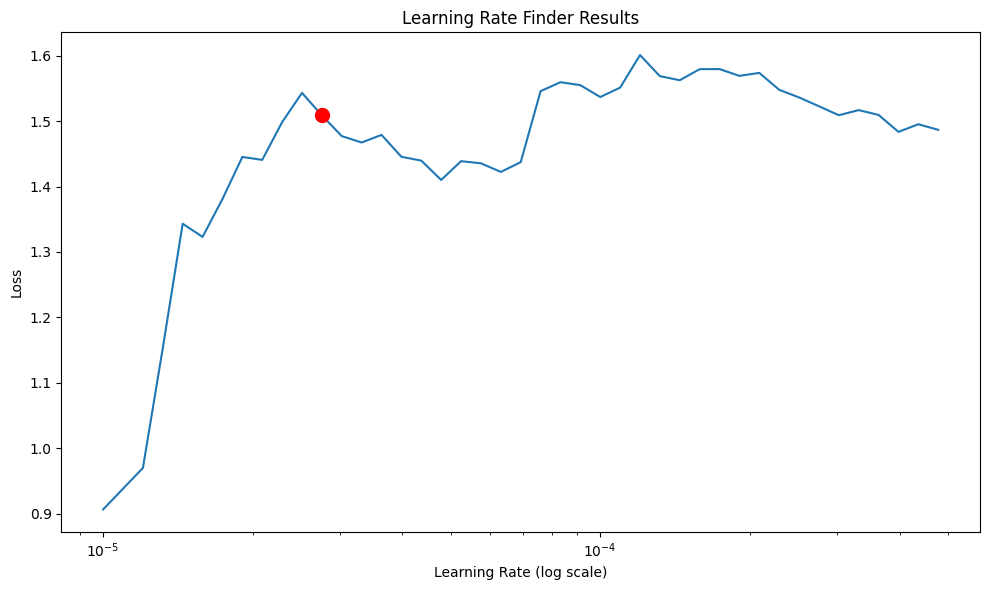

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 618.98it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_127952be-3fbc-4f7b-b40f-de8384bd4399.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_127952be-3fbc-4f7b-b40f-de8384bd4399.ckpt


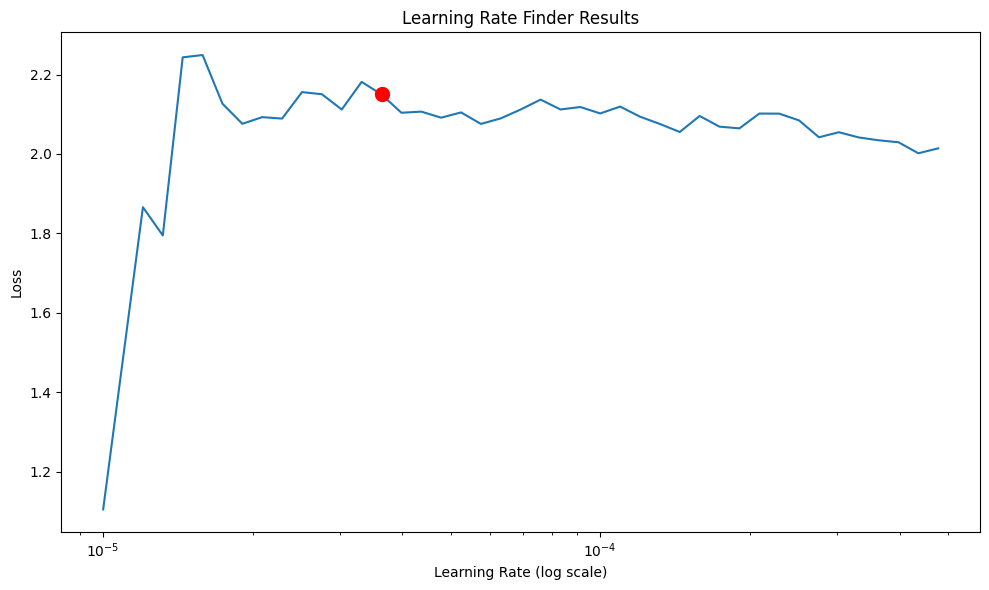

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 3 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.0

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 3:
  learning_rate: 1.4512882668183227e-05
  hidden_size: 128
  num_layers: 3
  dropout: 0.1
  weight_decay: 0.0001
  batch_size: 128

Best hyperparameters for household_debt with lag 3:
  learning_rate: 4.236471488452792e-05
  hidden_size: 128
  num_layers: 2
  dropout: 0.2
  weight_decay: 0.0001
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 425.06it/s]
Learning rate set to 5.248074602497726e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_f2302953-1d90-4715-aa22-e66cb6f02439.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_f2302953-1d90-4715-aa22-e66cb6f02439.ckpt


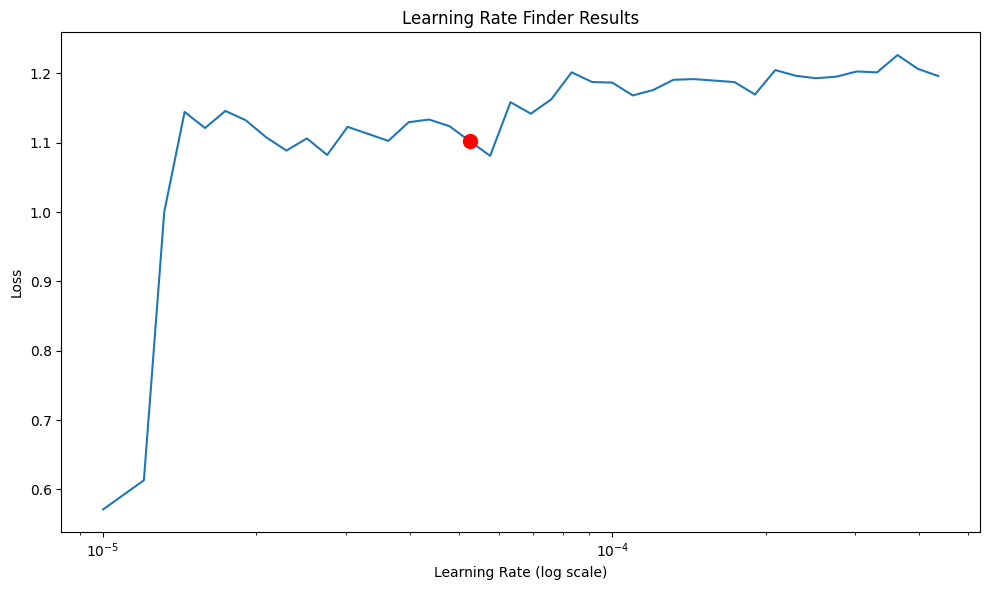

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005248


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 626.99it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_c44483ee-f509-4f42-a9f4-fd16b73bed42.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_c44483ee-f509-4f42-a9f4-fd16b73bed42.ckpt


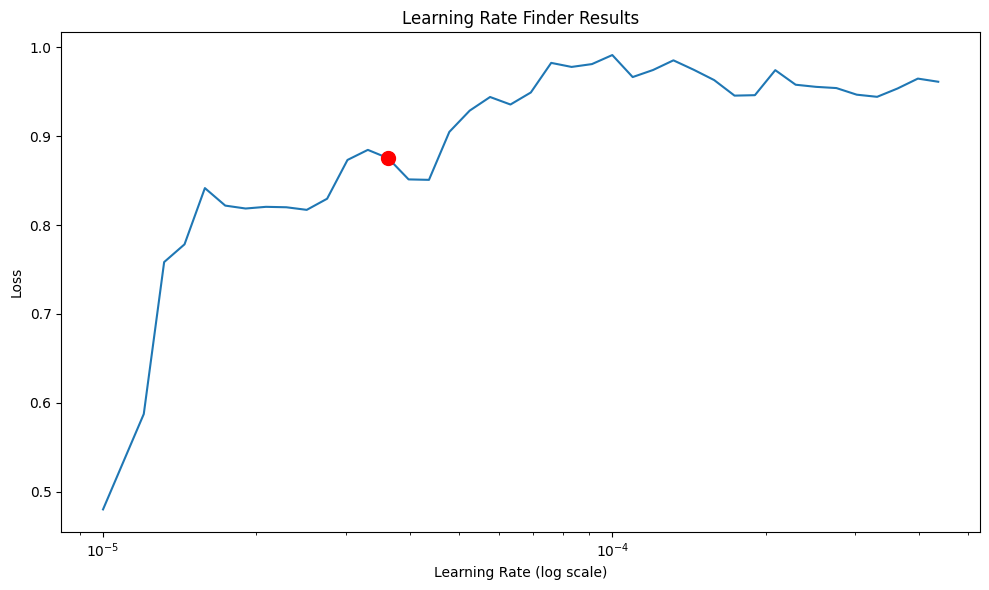

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 4 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2 

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 4:
  learning_rate: 9.031058983410327e-05
  hidden_size: 64
  num_layers: 2
  dropout: 0.4
  weight_decay: 0.0001
  batch_size: 128

Best hyperparameters for household_debt with lag 4:
  learning_rate: 0.0002563002124797259
  hidden_size: 128
  num_layers: 2
  dropout: 0.3
  weight_decay: 0.001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 622.52it/s]
Learning rate set to 0.00019054607179632476
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8a424530-21fc-4bda-82d6-c2a645be256d.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8a424530-21fc-4bda-82d6-c2a645be256d.ckpt


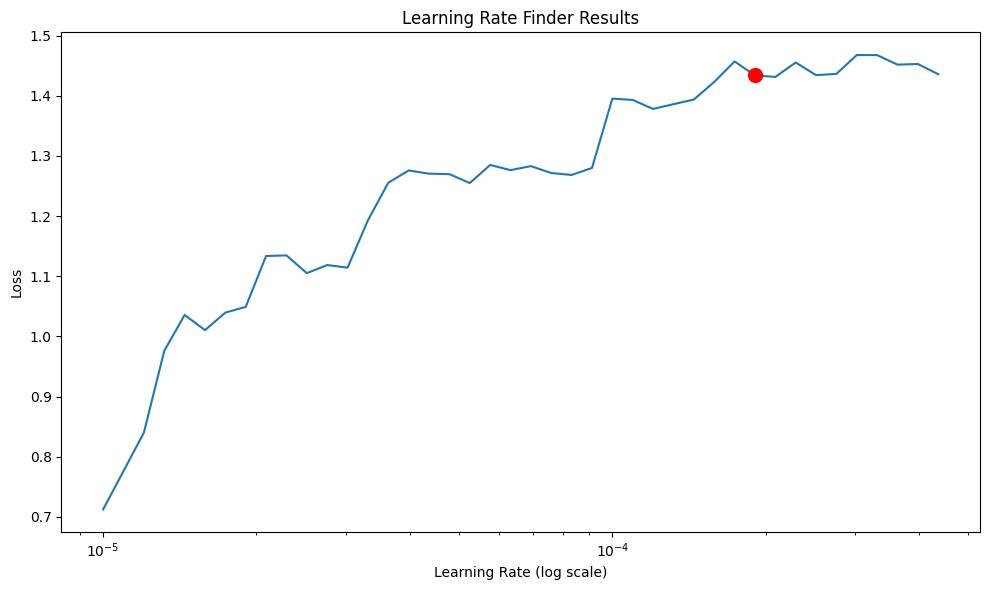

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00019055


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 585.54it/s]
Learning rate set to 3.981071705534973e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_65b4f111-67c3-4068-94d5-849df1ca8028.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_65b4f111-67c3-4068-94d5-849df1ca8028.ckpt


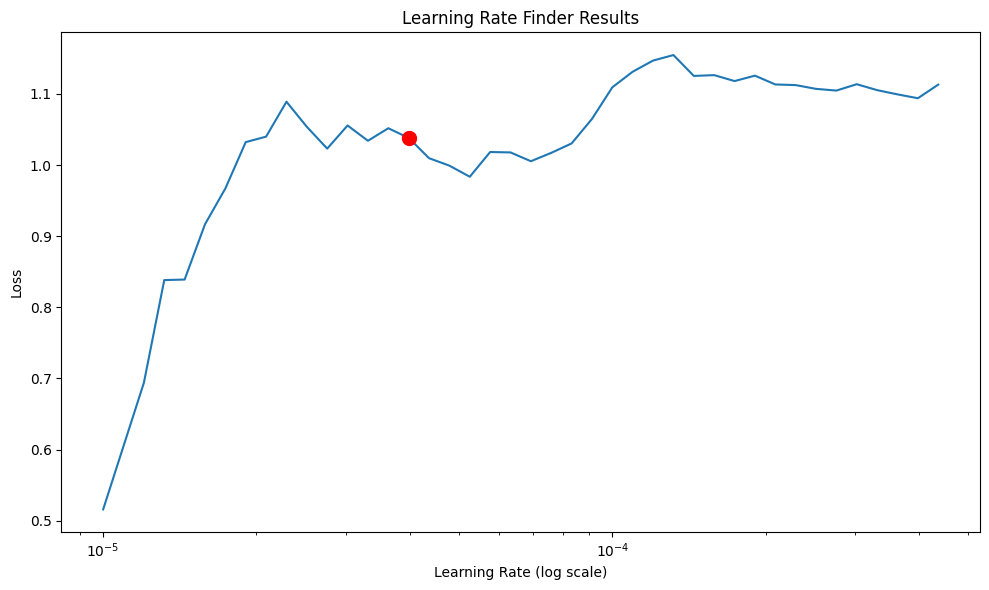

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003981


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 5 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 5:
  learning_rate: 5.3993003907165555e-05
  hidden_size: 16
  num_layers: 1
  dropout: 0.2
  weight_decay: 0.001
  batch_size: 16

Best hyperparameters for household_debt with lag 5:
  learning_rate: 0.003738520093354776
  hidden_size: 128
  num_layers: 1
  dropout: 0.3
  weight_decay: 0.0001
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 630.96it/s]
Learning rate set to 5.75439937337157e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8c46804c-c2b7-42e9-92b6-8ca0c68bd59b.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8c46804c-c2b7-42e9-92b6-8ca0c68bd59b.ckpt


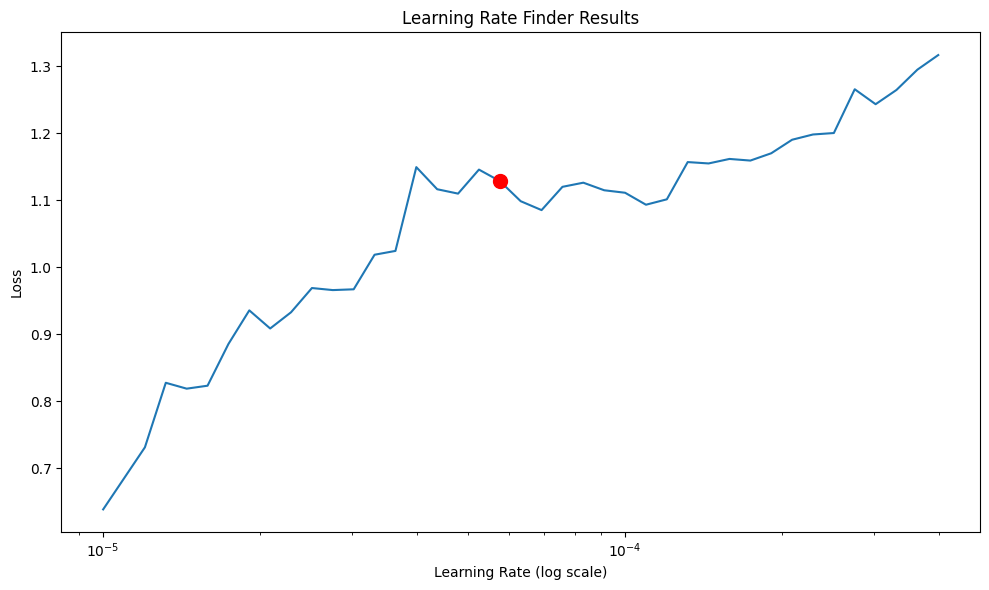

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 635.14it/s]
Learning rate set to 6.309573444801933e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_5cd91361-5092-4b9a-a528-2df7fc5330a3.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_5cd91361-5092-4b9a-a528-2df7fc5330a3.ckpt


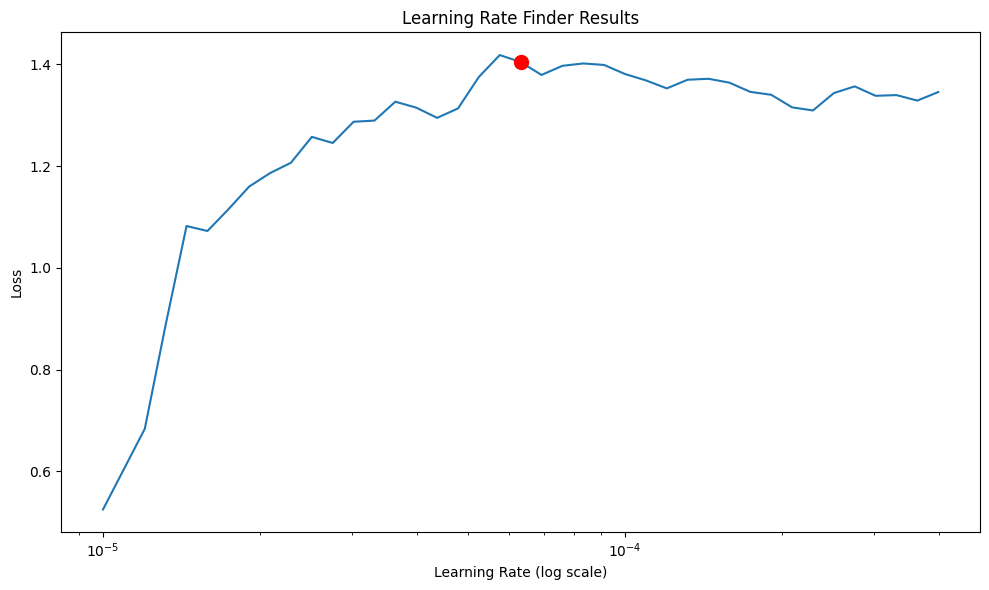

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00006310


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 6 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
Starting hyperparameter optimization for lag 6...
Optimizing hyperparameters for log_GDP


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 6:
  learning_rate: 3.902317872566152e-05
  hidden_size: 64
  num_layers: 3
  dropout: 0.3
  weight_decay: 0.01
  batch_size: 64

Best hyperparameters for household_debt with lag 6:
  learning_rate: 0.00018216874155881654
  hidden_size: 64
  num_layers: 1
  dropout: 0.1
  weight_decay: 0.001
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 619.41it/s]
Learning rate set to 9.120108393559098e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8ea2b002-e9fc-4fc9-b105-0cd3200df03e.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8ea2b002-e9fc-4fc9-b105-0cd3200df03e.ckpt


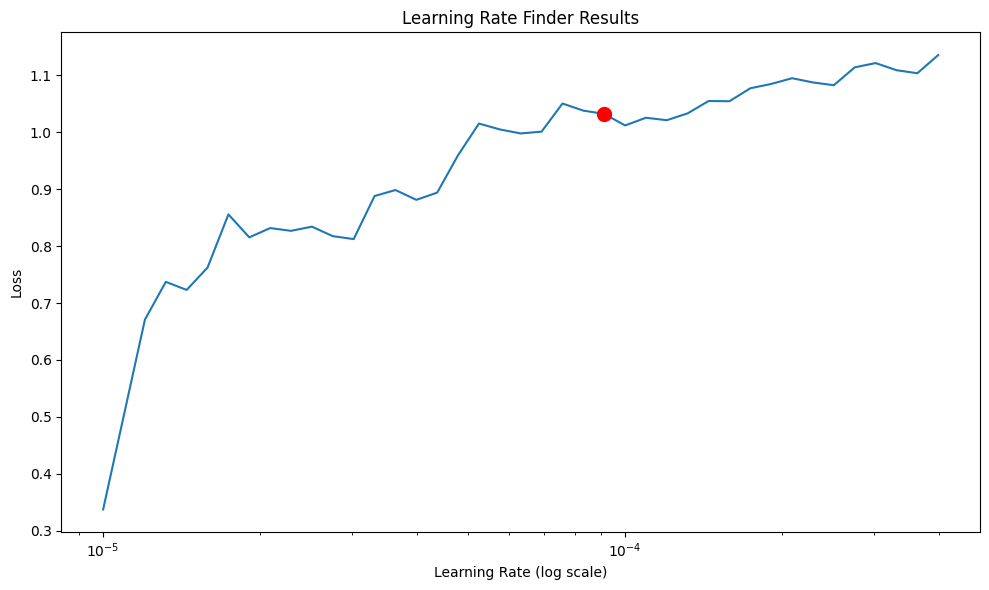

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00009120


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 585.56it/s]
Learning rate set to 0.00013182567385564074
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_79593f54-2806-429f-9198-aa5d67f1caa1.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_79593f54-2806-429f-9198-aa5d67f1caa1.ckpt


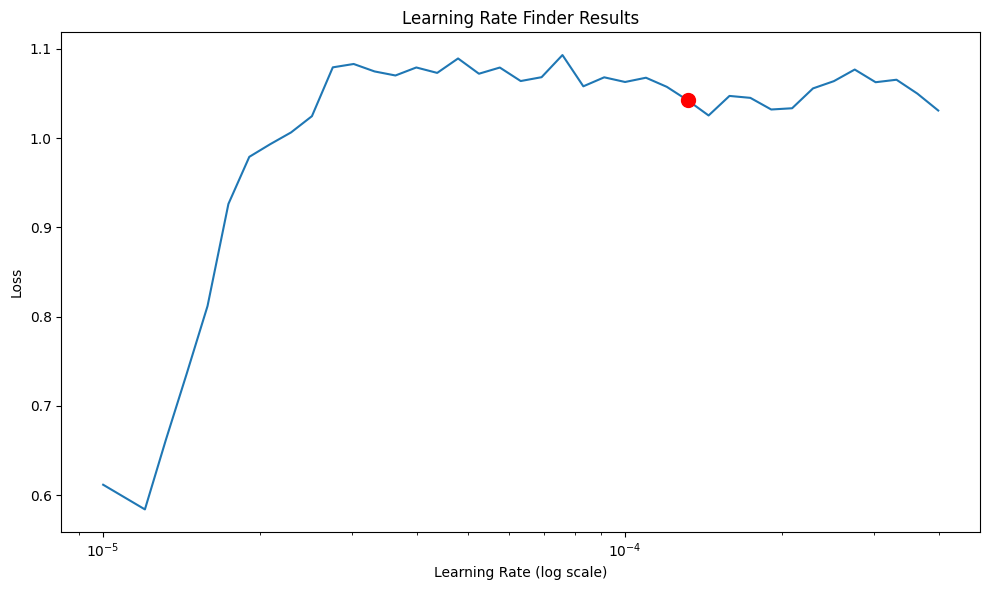

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00013183


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.


In [38]:
 
variables_to_evaluate = ['log_GDP', 'household_debt']
from var import var
# takes a while to run
robust_check_results, robustness_dict = evaluate_models_with_lags(
    final_detrend, 
    train_dt_var, 
    test_dt_var, 
    variables_to_evaluate, 
    max_lags=max_lags_to_evaluate,
    seed = 16
)




In [39]:
# # Fix for the IRF prediction error
# shock = 3
# lag_rob = 1  # The lag you want to use

# # Make sure to use the inputs from the same lag specification
# inputs = model_dict_1[lag_rob]['inputs']  # Get inputs for lag_rob
# df_zeros = pd.DataFrame(np.zeros((1, len(inputs))), columns=inputs)

# # Use the model dictionary from the same lag specification
# dictionary_rob_test = model_dict_1[lag_rob]['model_dict']  # Use model from lag_rob

# # Now run the IRF prediction
# plot1_irf_results = irf.predict(df_zeros, inputs, 'household_debt_lag1', household_debt_shocks[shock], 'log_GDP', 20, dictionary_rob_test, lag_rob)
# plot1_title = f'%Δ GDP Impulse Response Function (Shock: {shock} Std Deviation)'
# plot1_var = '%Δ GDP'
# irf.plot(plot1_irf_results, 'log_hhd', plot1_title, plot1_var)
# sum(plot1_irf_results)

# # For the second IRF (GDP shock to household debt)
# plot2_irf_results = irf.predict(df_zeros, inputs, 'log_GDP_lag1', log_gdp_shocks[shock], 'household_debt', 20, dictionary_rob_test, lag_rob)
# plot2_title = f'Household Debt Response to GDP Shock (Shock: {shock} Std Deviation)'
# plot2_var = 'Δ Household Debt'
# irf.plot(plot2_irf_results, 'GDP', plot2_title, plot2_var)
# sum(plot2_irf_results)


Evaluating models with 1 lags...
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
      

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
Starting hyperparameter optimization for lag 1...
Optimizing hyperparameters for log_GDP


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 1:
  learning_rate: 7.339576861289311e-05
  hidden_size: 64
  num_layers: 2
  dropout: 0.2
  weight_decay: 1e-05
  batch_size: 16

Best hyperparameters for household_debt with lag 1:
  learning_rate: 3.330668179960056e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.5
  weight_decay: 1e-05
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 457.36it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_11af7a2e-fa5f-4425-acb4-8088529c5083.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_11af7a2e-fa5f-4425-acb4-8088529c5083.ckpt


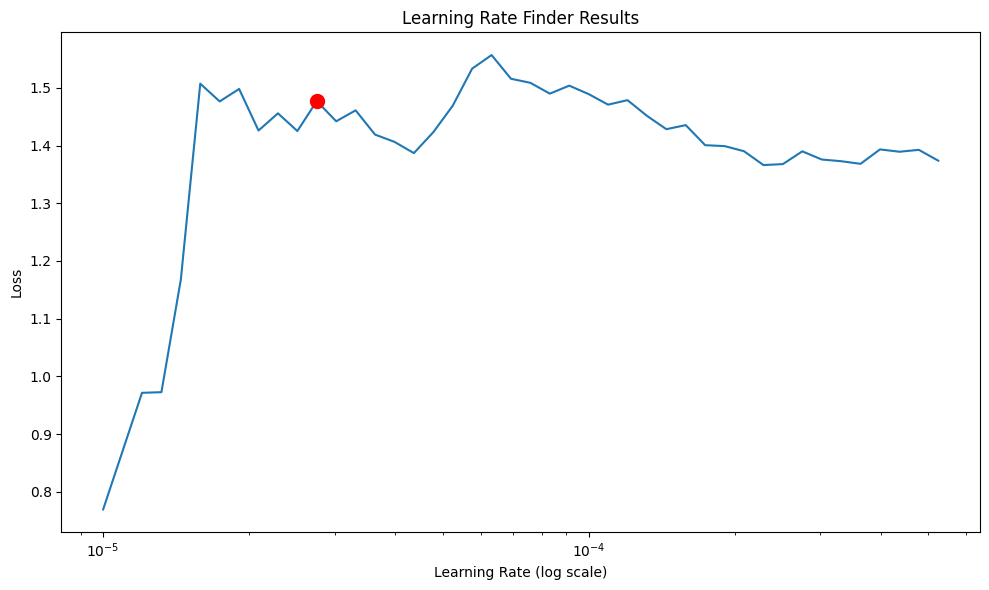

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 601.31it/s]
Learning rate set to 0.00015848931924611134
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_5968c807-66b1-4d88-b446-c65f7220b885.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_5968c807-66b1-4d88-b446-c65f7220b885.ckpt


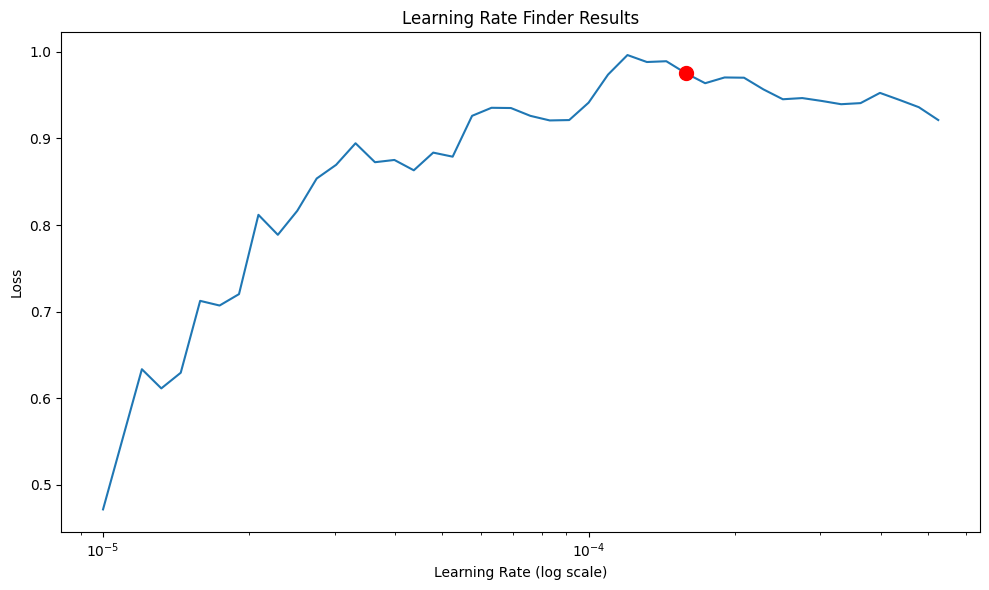

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00015849


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 2 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.0004

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 2:
  learning_rate: 0.0008826390686920679
  hidden_size: 16
  num_layers: 2
  dropout: 0.4
  weight_decay: 0.01
  batch_size: 64

Best hyperparameters for household_debt with lag 2:
  learning_rate: 0.0002977388965188921
  hidden_size: 128
  num_layers: 3
  dropout: 0.5
  weight_decay: 0.0001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 627.54it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_b886a321-7ee8-4952-a17a-faf6831a133c.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_b886a321-7ee8-4952-a17a-faf6831a133c.ckpt


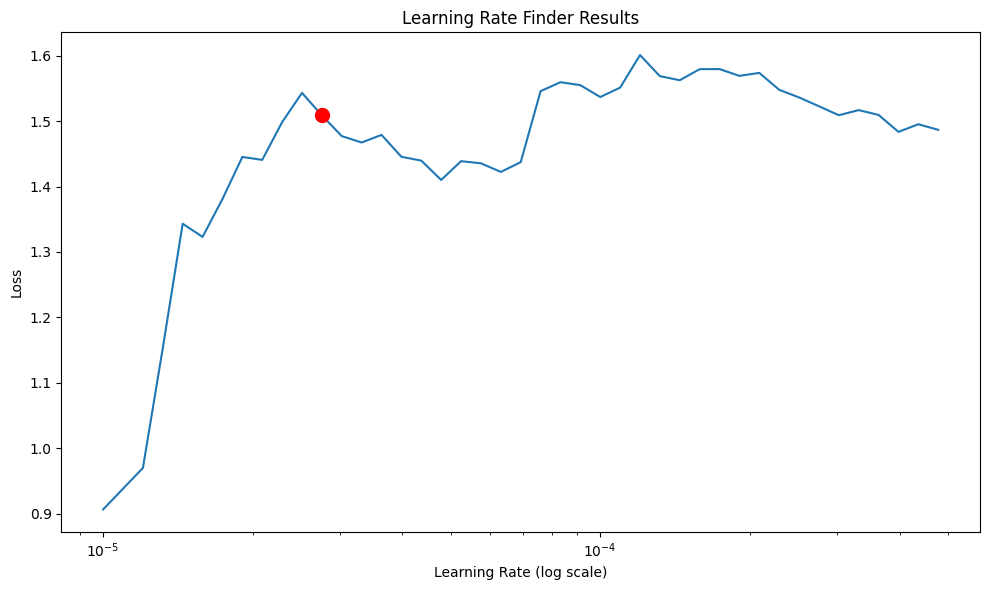

Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_datal

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 512.07it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_52112e66-238d-4091-a526-ee0f3ad42f65.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_52112e66-238d-4091-a526-ee0f3ad42f65.ckpt


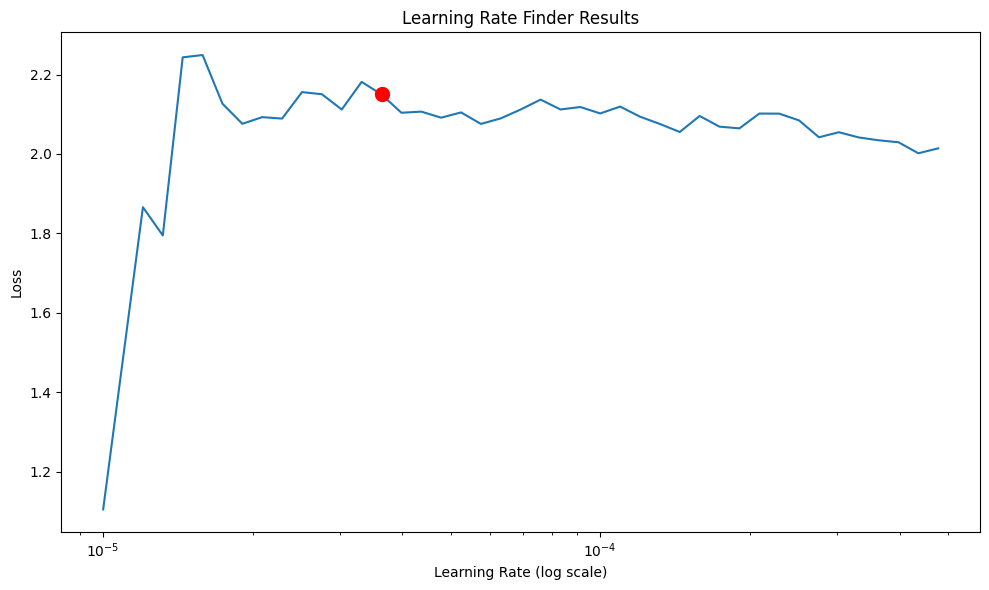

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 3 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.0

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/conn

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 3:
  learning_rate: 8.008212983797164e-05
  hidden_size: 32
  num_layers: 2
  dropout: 0.4
  weight_decay: 1e-05
  batch_size: 16

Best hyperparameters for household_debt with lag 3:
  learning_rate: 0.0007663677654048468
  hidden_size: 128
  num_layers: 3
  dropout: 0.2
  weight_decay: 0.01
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 433.72it/s]
Learning rate set to 5.248074602497726e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_528f6687-80e5-4b30-9f82-6c403d708a7b.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_528f6687-80e5-4b30-9f82-6c403d708a7b.ckpt


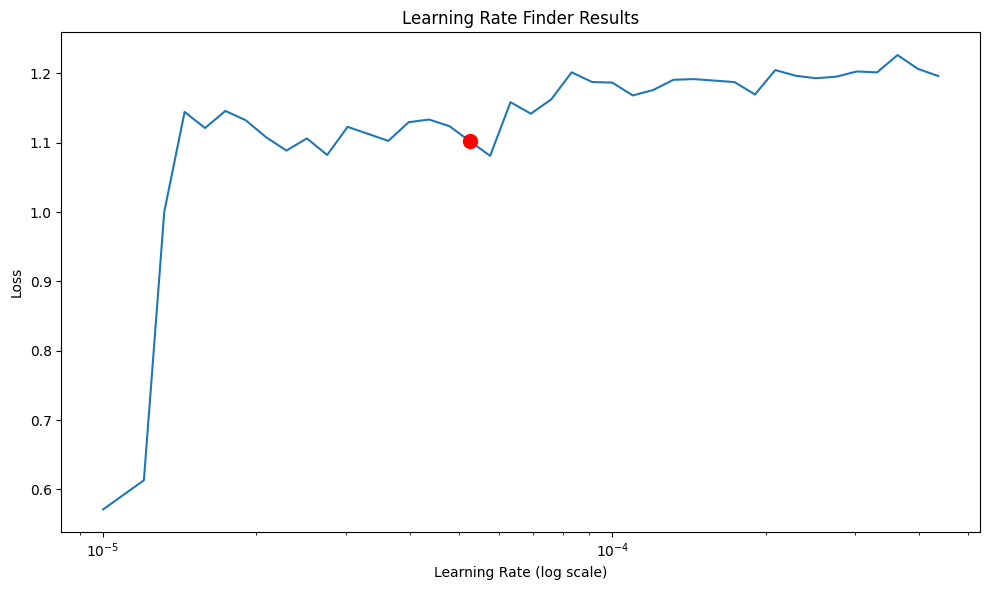

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005248


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 574.28it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_0fb88977-c05c-45a2-8565-a3c2b35ba571.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_0fb88977-c05c-45a2-8565-a3c2b35ba571.ckpt


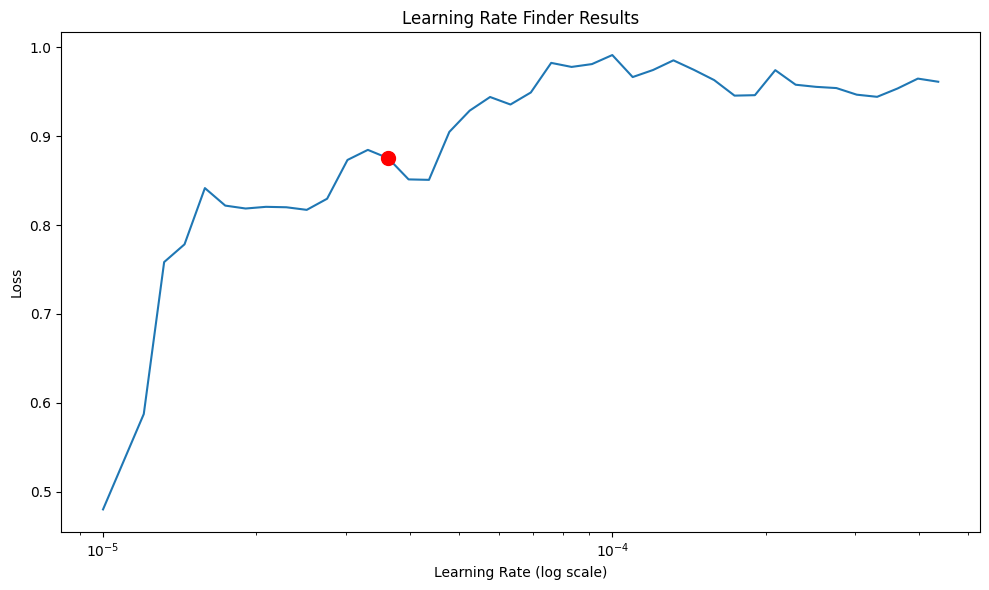

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 4 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2 

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 4:
  learning_rate: 8.54456699355818e-05
  hidden_size: 128
  num_layers: 3
  dropout: 0.1
  weight_decay: 0.01
  batch_size: 16

Best hyperparameters for household_debt with lag 4:
  learning_rate: 0.000795480618177434
  hidden_size: 64
  num_layers: 2
  dropout: 0.3
  weight_decay: 0.001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 582.65it/s]
Learning rate set to 0.00019054607179632476
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_3cbf5f07-9f83-4fa6-814e-53b6b206968d.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_3cbf5f07-9f83-4fa6-814e-53b6b206968d.ckpt


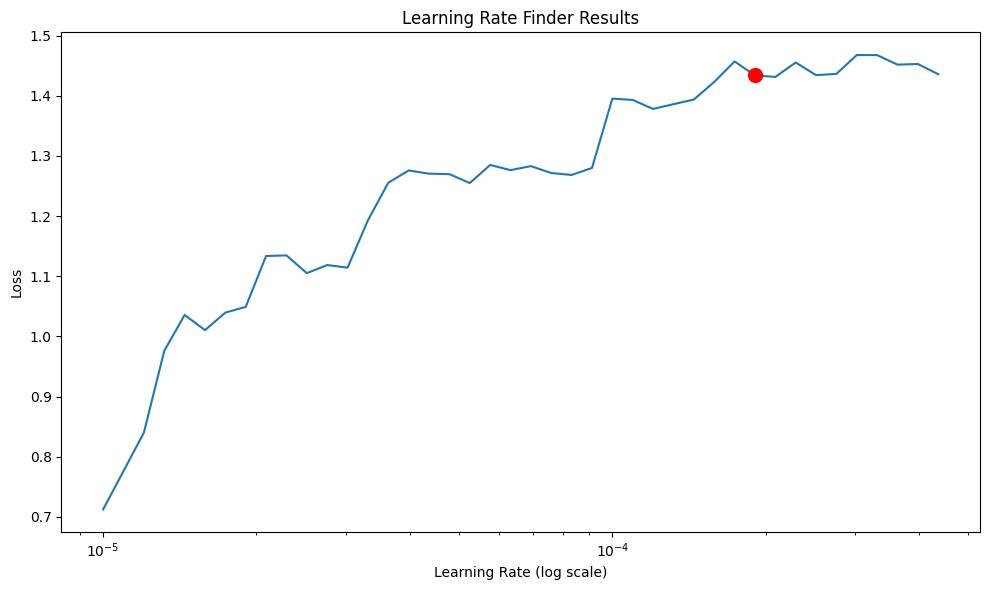

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00019055


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 487.69it/s]
Learning rate set to 3.981071705534973e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_4d2775cb-ebad-408a-9d51-2d0cdc946e7d.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_4d2775cb-ebad-408a-9d51-2d0cdc946e7d.ckpt


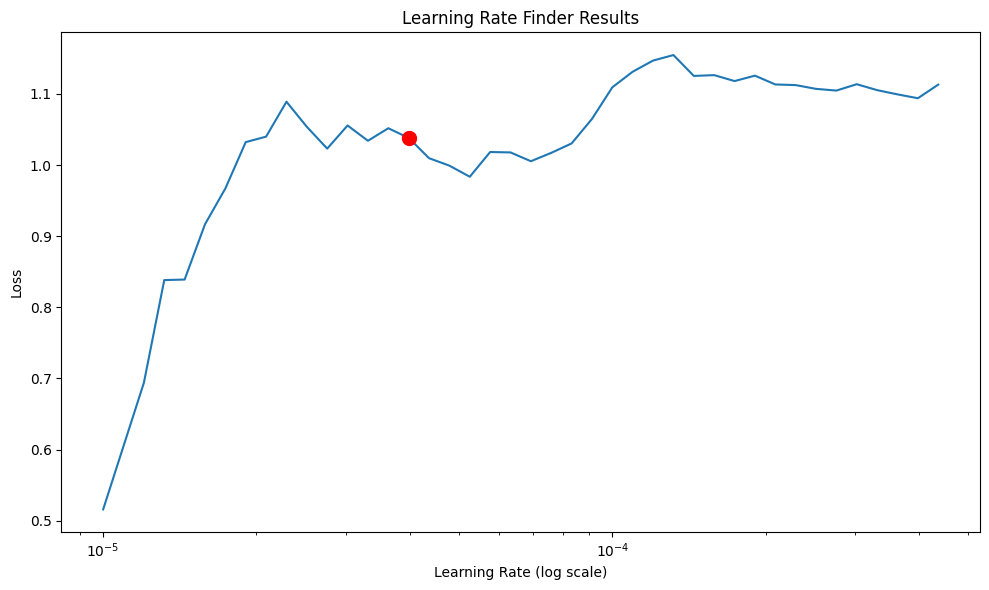

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003981


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 5 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/conn

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 5:
  learning_rate: 1.7832809560278204e-05
  hidden_size: 32
  num_layers: 2
  dropout: 0.2
  weight_decay: 0.01
  batch_size: 16

Best hyperparameters for household_debt with lag 5:
  learning_rate: 0.00040407410619067765
  hidden_size: 128
  num_layers: 2
  dropout: 0.1
  weight_decay: 1e-05
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 597.08it/s]
Learning rate set to 5.75439937337157e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8a5ab68c-6211-4c68-b209-329b9062c492.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_8a5ab68c-6211-4c68-b209-329b9062c492.ckpt


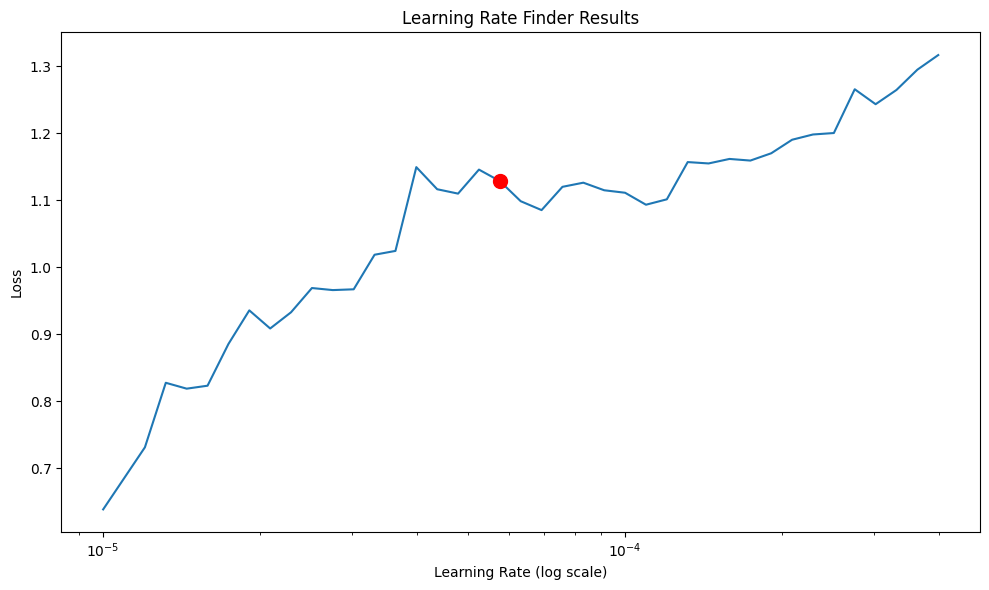

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 639.80it/s]
Learning rate set to 6.309573444801933e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_289a30a8-ab26-4f1e-b41f-c5ec4ff05d31.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_289a30a8-ab26-4f1e-b41f-c5ec4ff05d31.ckpt


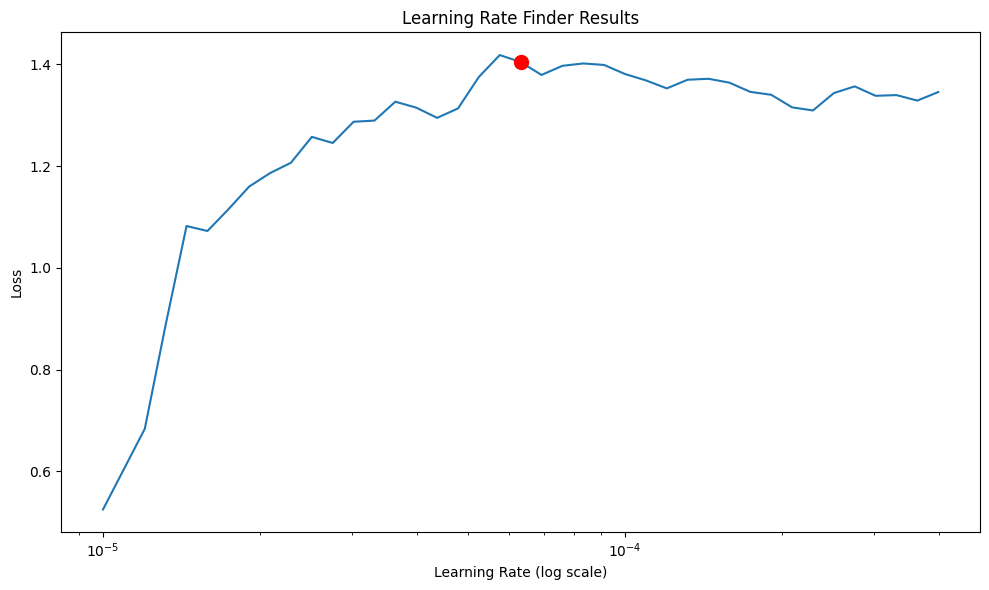

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00006310


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 6 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/conn

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 6:
  learning_rate: 5.798559262398683e-05
  hidden_size: 128
  num_layers: 2
  dropout: 0.3
  weight_decay: 0.001
  batch_size: 32

Best hyperparameters for household_debt with lag 6:
  learning_rate: 0.0013472372745702546
  hidden_size: 128
  num_layers: 1
  dropout: 0.1
  weight_decay: 0.001
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 543.05it/s]
Learning rate set to 9.120108393559098e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_a449ca02-cd41-48f0-aae8-42d03ca2d2f8.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_a449ca02-cd41-48f0-aae8-42d03ca2d2f8.ckpt


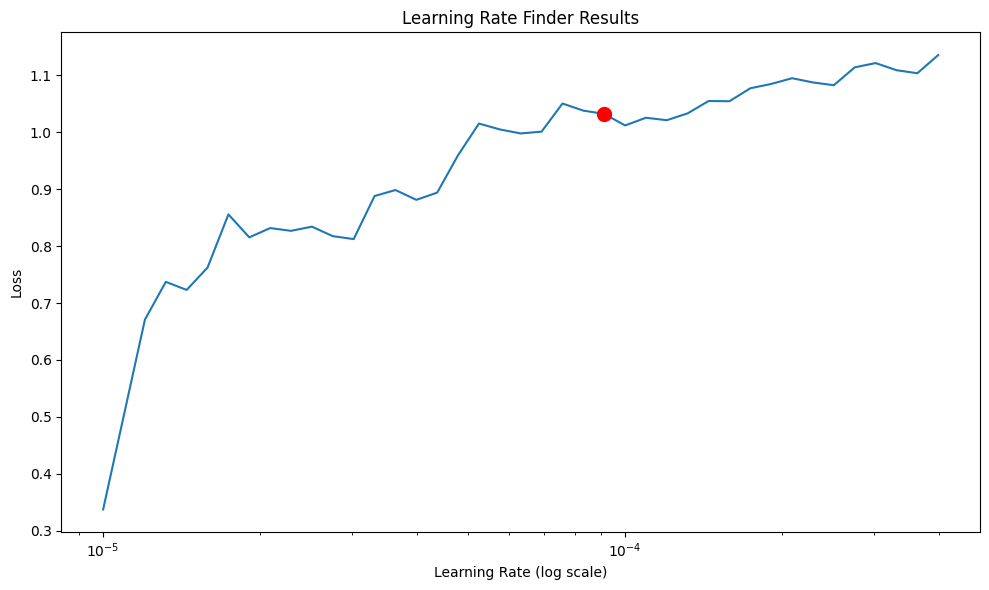

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00009120


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 514.73it/s]
Learning rate set to 0.00013182567385564074
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_cc450f36-e36f-497f-93c3-9dc8e8687c0b.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_cc450f36-e36f-497f-93c3-9dc8e8687c0b.ckpt


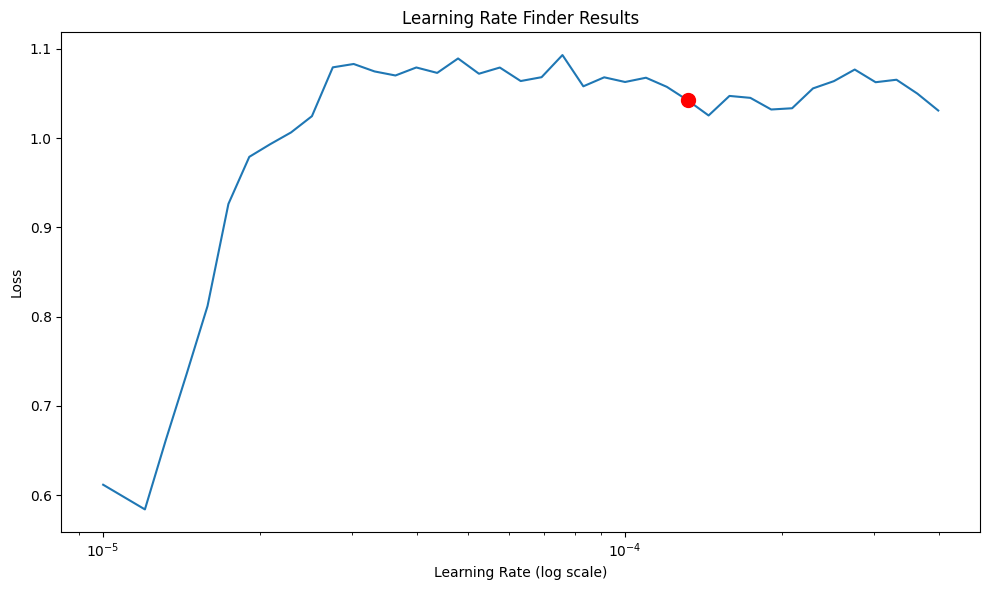

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00013183


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.


In [40]:
# max_lags_to_evaluate = 1  
variables_to_evaluate = ['log_GDP', 'household_debt']
from var import var
# takes a while to run
robust_check_results2, robustness_dict2 = evaluate_models_with_lags(
    final_detrend, 
    train_dt_var, 
    test_dt_var, 
    variables_to_evaluate, 
    max_lags=max_lags_to_evaluate,
    seed = 100
)


Evaluating models with 1 lags...
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
      

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq  

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 1:
  learning_rate: 0.00466187035569852
  hidden_size: 32
  num_layers: 3
  dropout: 0.4
  weight_decay: 0.01
  batch_size: 16

Best hyperparameters for household_debt with lag 1:
  learning_rate: 0.0015248805612076224
  hidden_size: 128
  num_layers: 2
  dropout: 0.1
  weight_decay: 0.0001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 649.64it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_4d26d010-9eb5-4863-ac71-29deed6805b5.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_4d26d010-9eb5-4863-ac71-29deed6805b5.ckpt


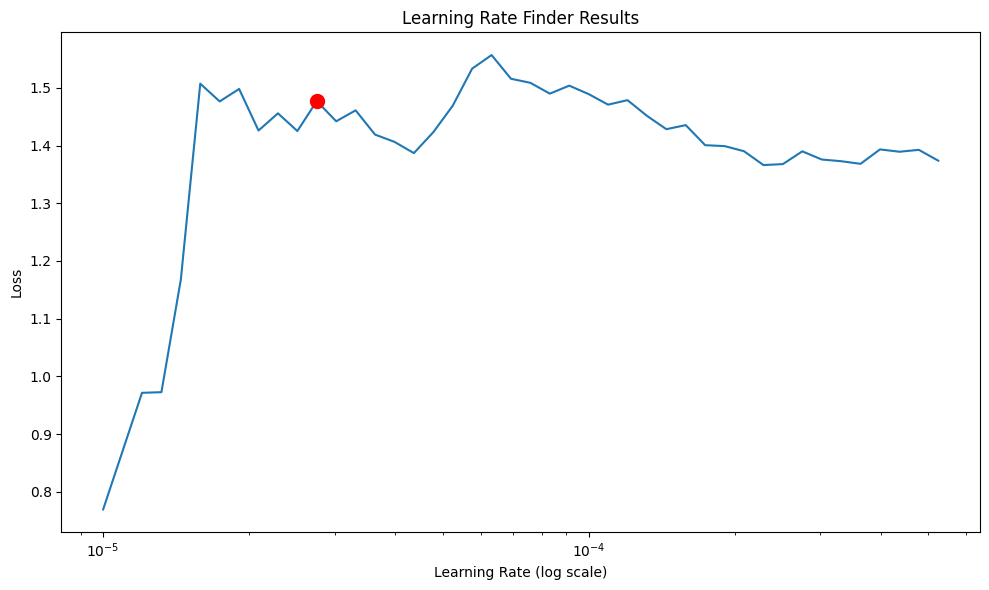

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 648.76it/s]
Learning rate set to 0.00015848931924611134
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_fe7036ba-1ade-4d9c-83dd-247c53dfe2ea.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_fe7036ba-1ade-4d9c-83dd-247c53dfe2ea.ckpt


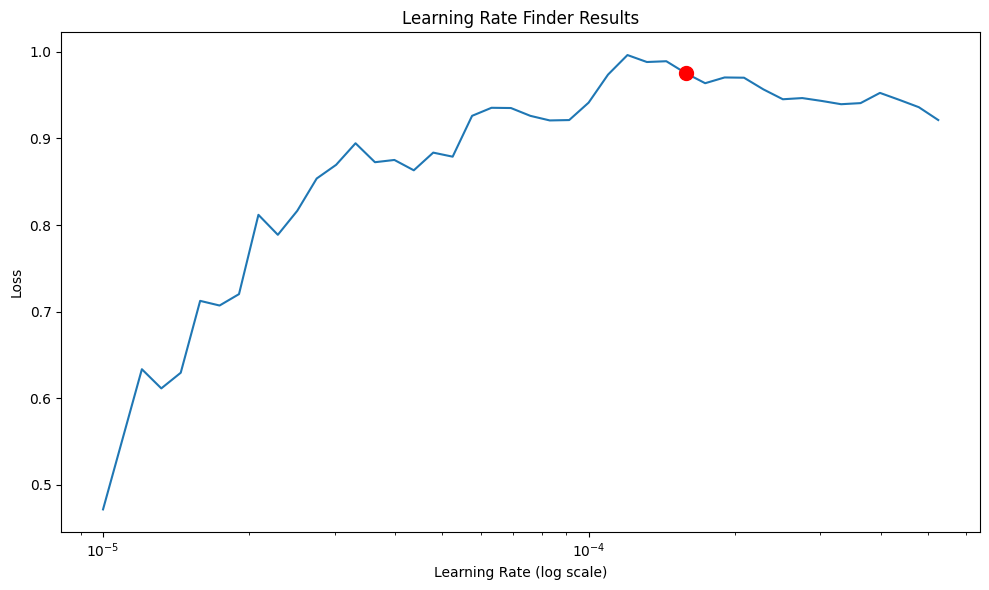

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00015849


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 2 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.0004

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 2:
  learning_rate: 0.00042734928314193914
  hidden_size: 64
  num_layers: 1
  dropout: 0.3
  weight_decay: 0.01
  batch_size: 128

Best hyperparameters for household_debt with lag 2:
  learning_rate: 0.0004491523825137995
  hidden_size: 128
  num_layers: 1
  dropout: 0.5
  weight_decay: 0.0001
  batch_size: 16
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 661.22it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_69cdb49d-740e-4a6f-85c1-a4e830e182d9.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_69cdb49d-740e-4a6f-85c1-a4e830e182d9.ckpt


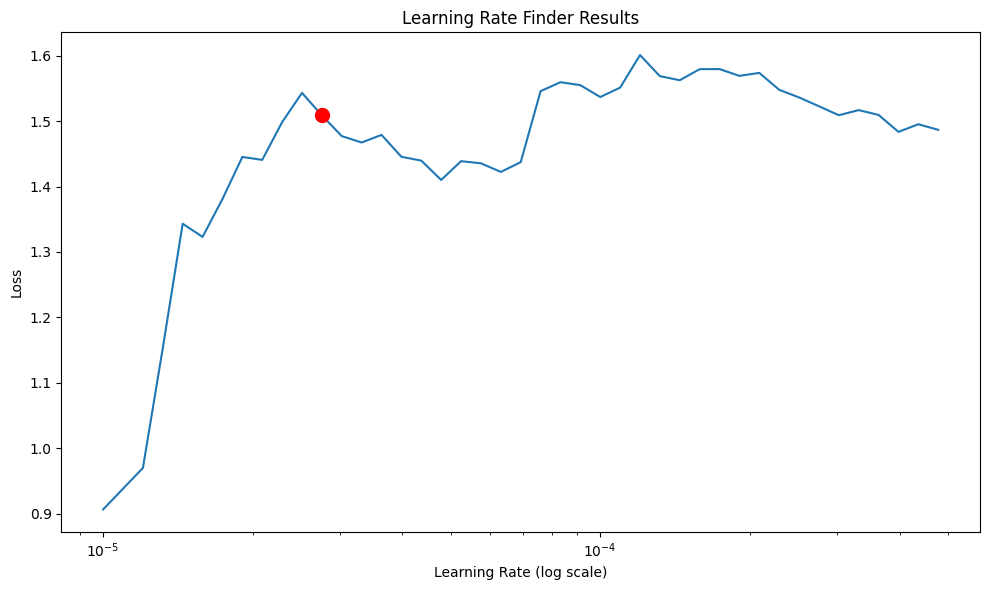

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 653.15it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_bf89c60c-8228-46cc-bacb-c0efde52e14c.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_bf89c60c-8228-46cc-bacb-c0efde52e14c.ckpt


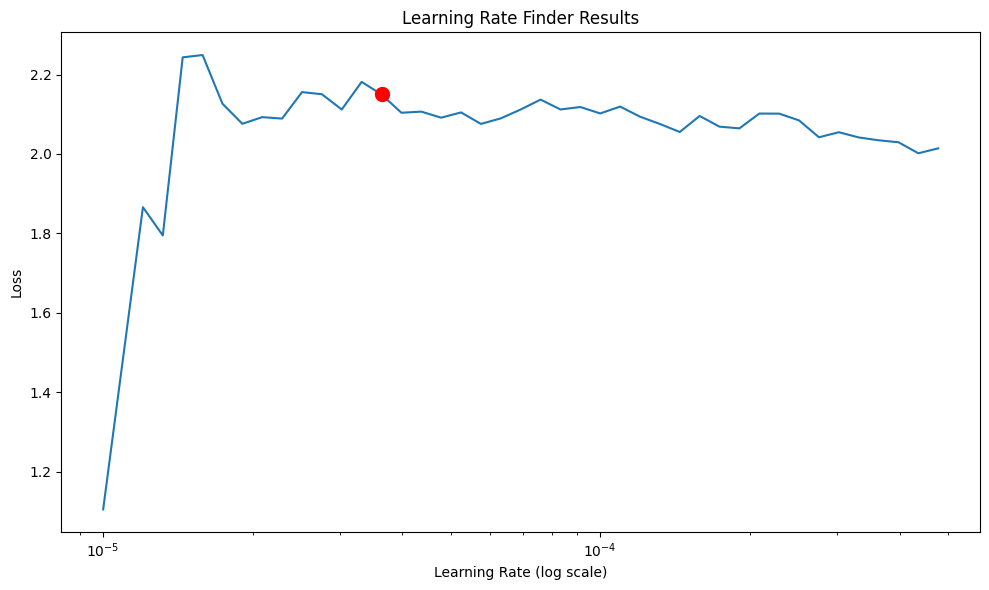

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 3 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.0

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 3:
  learning_rate: 0.0005187093958651712
  hidden_size: 16
  num_layers: 1
  dropout: 0.2
  weight_decay: 0.0001
  batch_size: 128

Best hyperparameters for household_debt with lag 3:
  learning_rate: 0.0007425171998694688
  hidden_size: 128
  num_layers: 3
  dropout: 0.5
  weight_decay: 0.0001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 643.39it/s]
Learning rate set to 5.248074602497726e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_d9c04ce4-f444-4b48-b517-7e20ee903d0a.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_d9c04ce4-f444-4b48-b517-7e20ee903d0a.ckpt


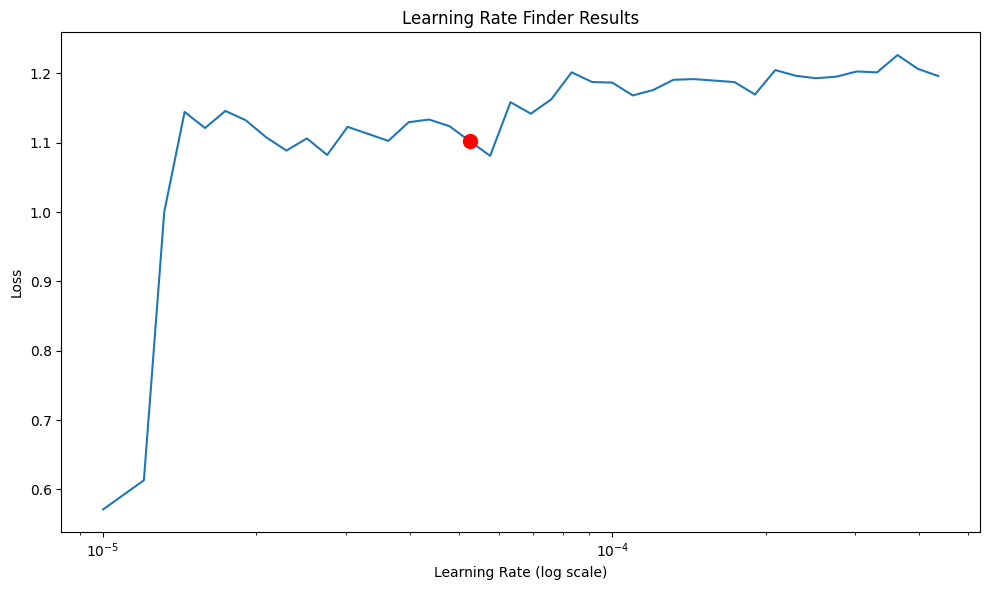

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005248


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 500.64it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_1ba69a80-d7d6-428e-b877-cf54c417d404.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_1ba69a80-d7d6-428e-b877-cf54c417d404.ckpt


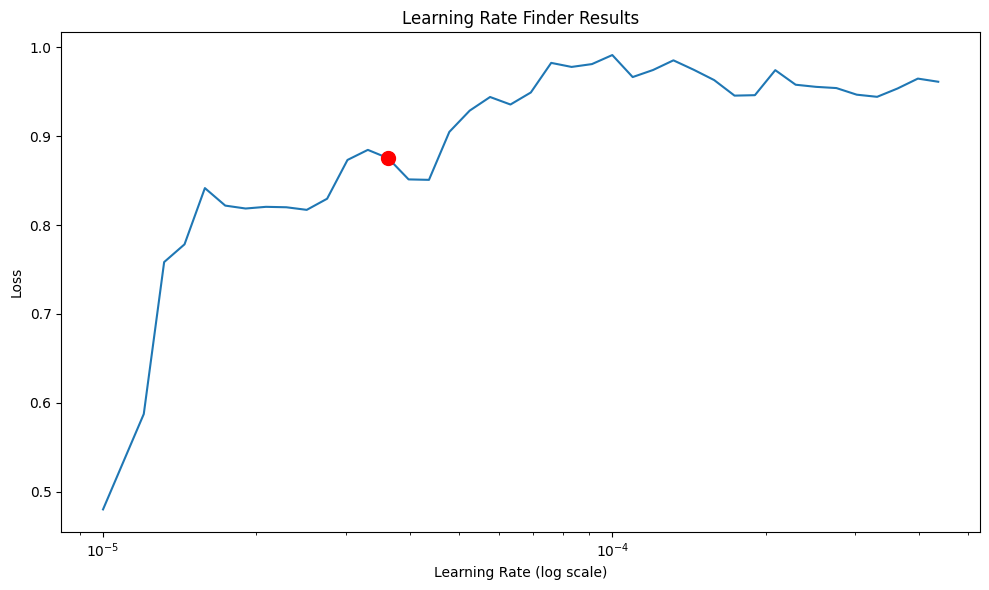

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 4 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2 

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 4:
  learning_rate: 4.215059275138853e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.4
  weight_decay: 0.001
  batch_size: 64

Best hyperparameters for household_debt with lag 4:
  learning_rate: 0.0012847724976496264
  hidden_size: 128
  num_layers: 2
  dropout: 0.5
  weight_decay: 1e-05
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 571.95it/s]
Learning rate set to 0.00019054607179632476
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_5bc9ee01-a13b-43a5-b4db-7e1d254136bc.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_5bc9ee01-a13b-43a5-b4db-7e1d254136bc.ckpt


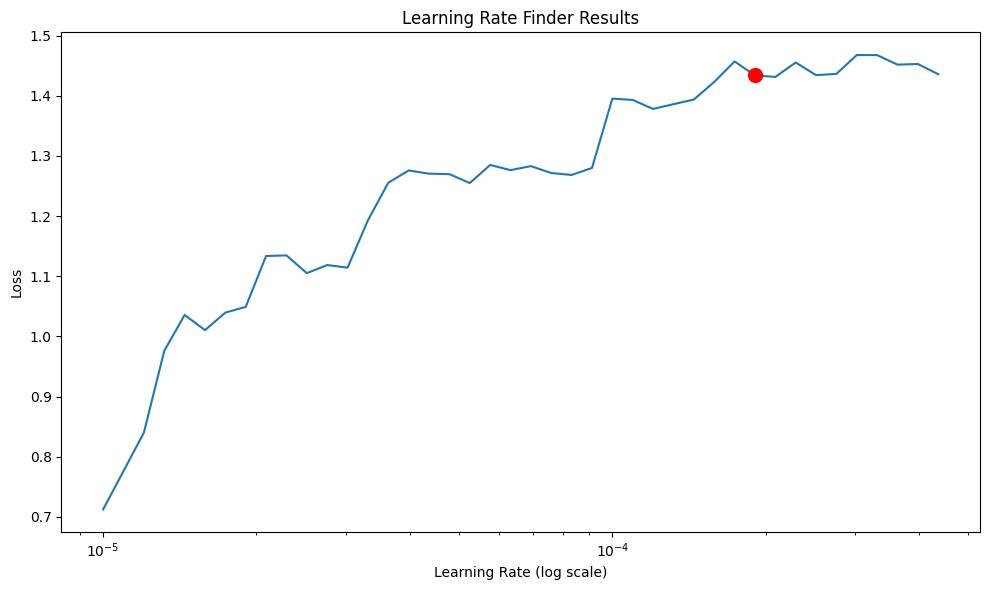

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00019055


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 636.55it/s]
Learning rate set to 3.981071705534973e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_96b7f879-89a6-4646-b743-48c4a1202ebe.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_96b7f879-89a6-4646-b743-48c4a1202ebe.ckpt


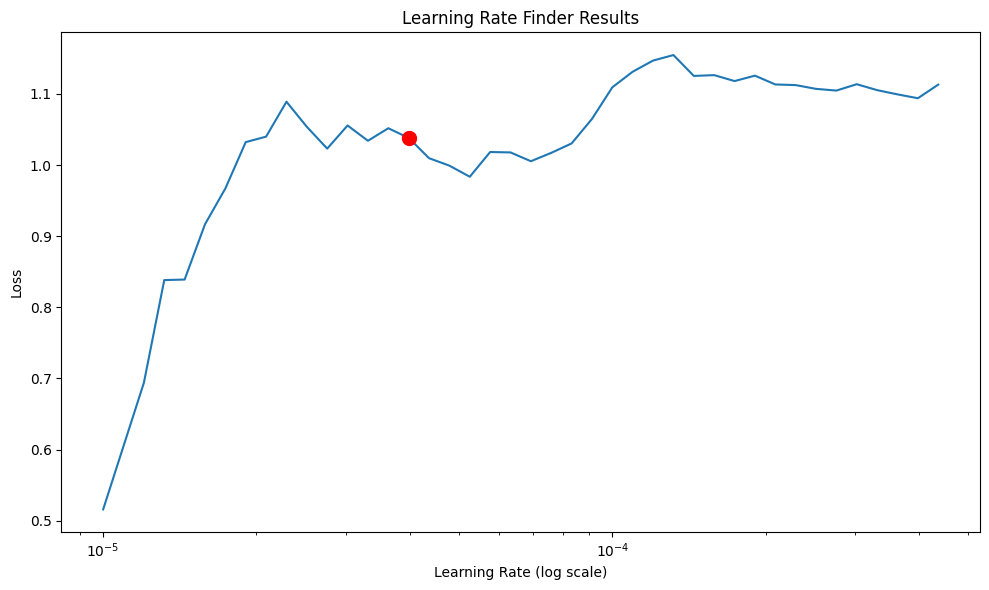

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003981


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 5 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 5:
  learning_rate: 5.4343554411162884e-05
  hidden_size: 64
  num_layers: 2
  dropout: 0.5
  weight_decay: 0.001
  batch_size: 16

Best hyperparameters for household_debt with lag 5:
  learning_rate: 0.0015526273047026084
  hidden_size: 128
  num_layers: 3
  dropout: 0.2
  weight_decay: 1e-05
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 595.57it/s]
Learning rate set to 5.75439937337157e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_2cfc44e8-80de-4d60-9a4b-3c00242e0f7d.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_2cfc44e8-80de-4d60-9a4b-3c00242e0f7d.ckpt


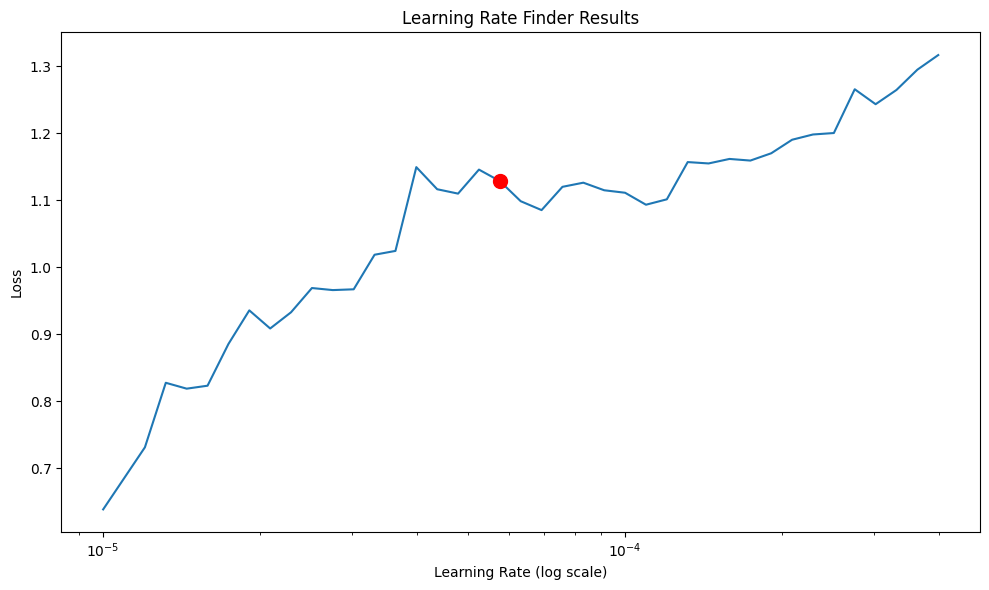

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 630.80it/s]
Learning rate set to 6.309573444801933e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_ca874d9c-9d92-4320-bccc-6b8267ee7e0e.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_ca874d9c-9d92-4320-bccc-6b8267ee7e0e.ckpt


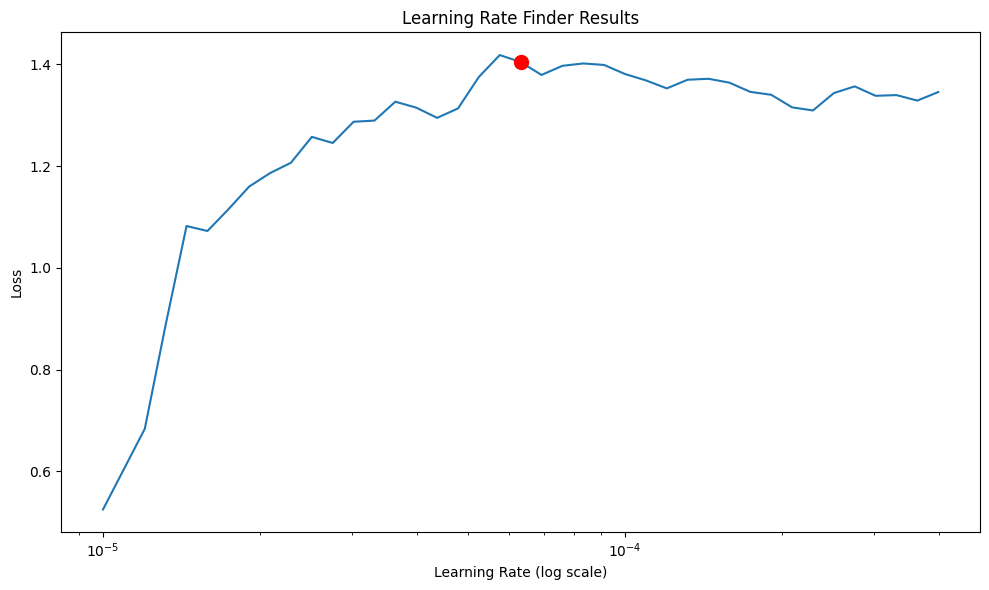

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00006310


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 6 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.1694

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 6:
  learning_rate: 3.978656340034899e-05
  hidden_size: 32
  num_layers: 2
  dropout: 0.3
  weight_decay: 0.01
  batch_size: 64

Best hyperparameters for household_debt with lag 6:
  learning_rate: 1.6940447095242732e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.4
  weight_decay: 0.001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 643.69it/s]
Learning rate set to 9.120108393559098e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_7b1be65e-8211-4079-bace-4f09ac5159db.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_7b1be65e-8211-4079-bace-4f09ac5159db.ckpt


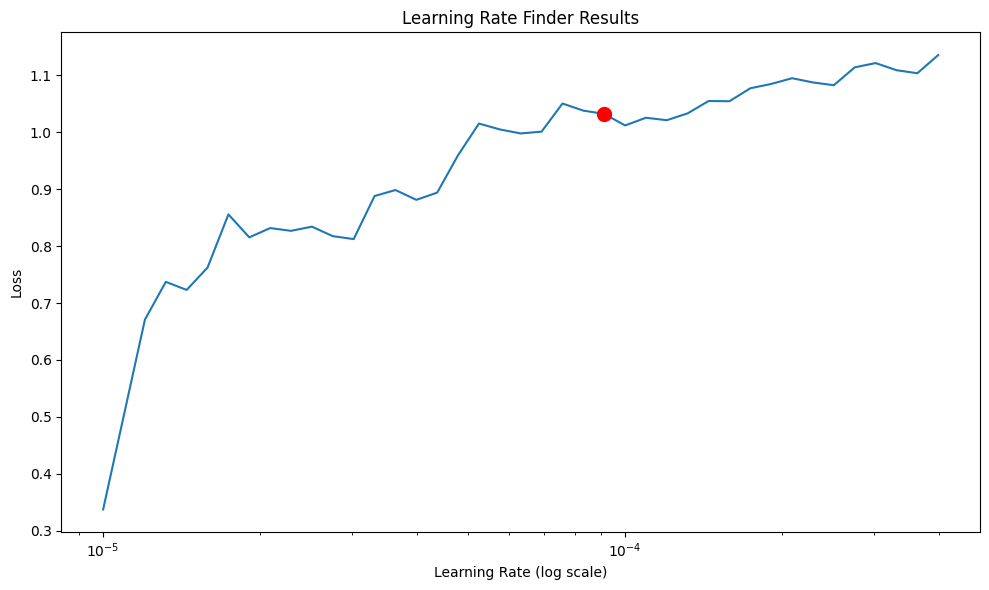

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00009120


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 644.98it/s]
Learning rate set to 0.00013182567385564074
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_2f9c87ce-219b-4e02-a6e2-ee92fc2f881e.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_2f9c87ce-219b-4e02-a6e2-ee92fc2f881e.ckpt


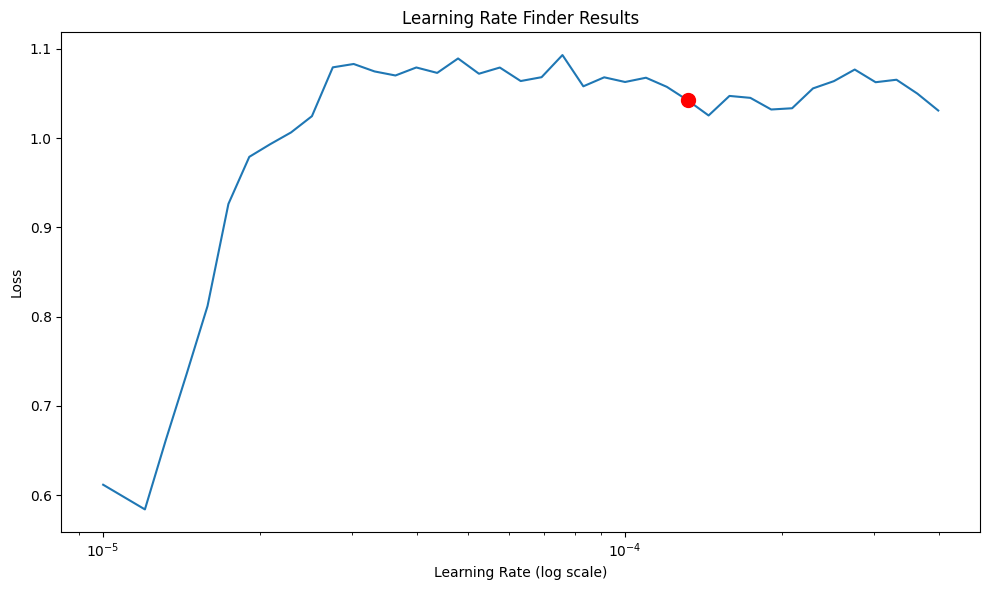

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00013183


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.


In [41]:
# max_lags_to_evaluate = 1  
variables_to_evaluate = ['log_GDP', 'household_debt']
from var import var
# takes a while to run
robust_check_results3, robustness_dict3 = evaluate_models_with_lags(
    final_detrend, 
    train_dt_var, 
    test_dt_var, 
    variables_to_evaluate, 
    max_lags=max_lags_to_evaluate,
    seed = 1
)



Evaluating models with 1 lags...
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
      

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
        l_GDP_dif_L1  hd_dif_L1
GDP_eq      0.052306   0.002383
HD_eq      -5.547507   0.315929
Starting hyperparameter optimization for lag 1...
Optimizing hyperparameters for log_GDP


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 1:
  learning_rate: 0.00023974709913404535
  hidden_size: 16
  num_layers: 3
  dropout: 0.1
  weight_decay: 0.0001
  batch_size: 64

Best hyperparameters for household_debt with lag 1:
  learning_rate: 0.0003344036652141134
  hidden_size: 64
  num_layers: 1
  dropout: 0.2
  weight_decay: 1e-05
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 638.39it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_9ce2c541-d27c-4564-9b00-ca783ff630c0.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_9ce2c541-d27c-4564-9b00-ca783ff630c0.ckpt


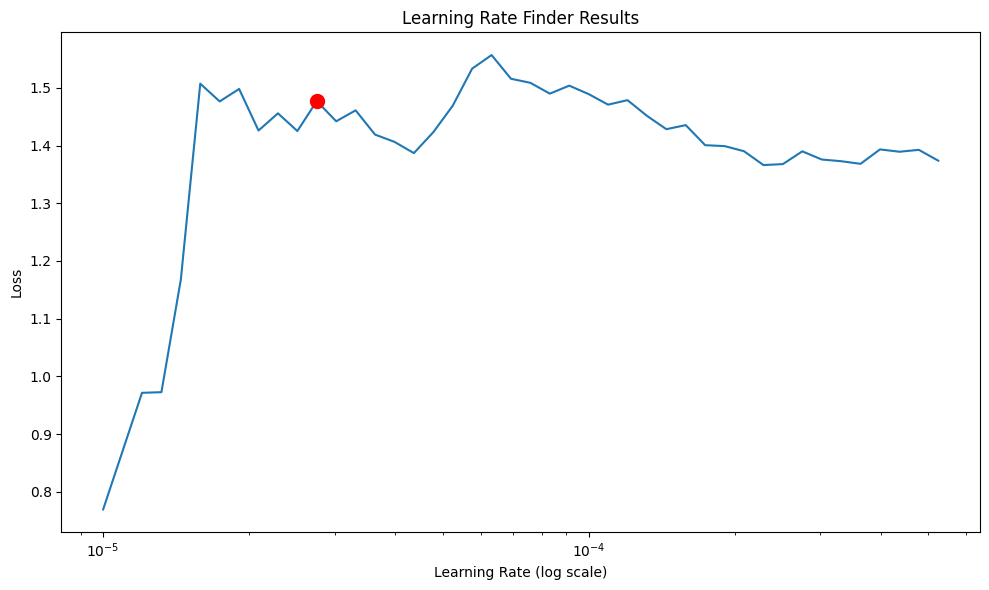

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 43 steps due to diverging loss.
Finding best initial lr:  43%|████▎     | 43/100 [00:00<00:00, 579.90it/s]
Learning rate set to 0.00015848931924611134
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_e0557891-7379-447f-bc27-40f771e40f3c.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_e0557891-7379-447f-bc27-40f771e40f3c.ckpt


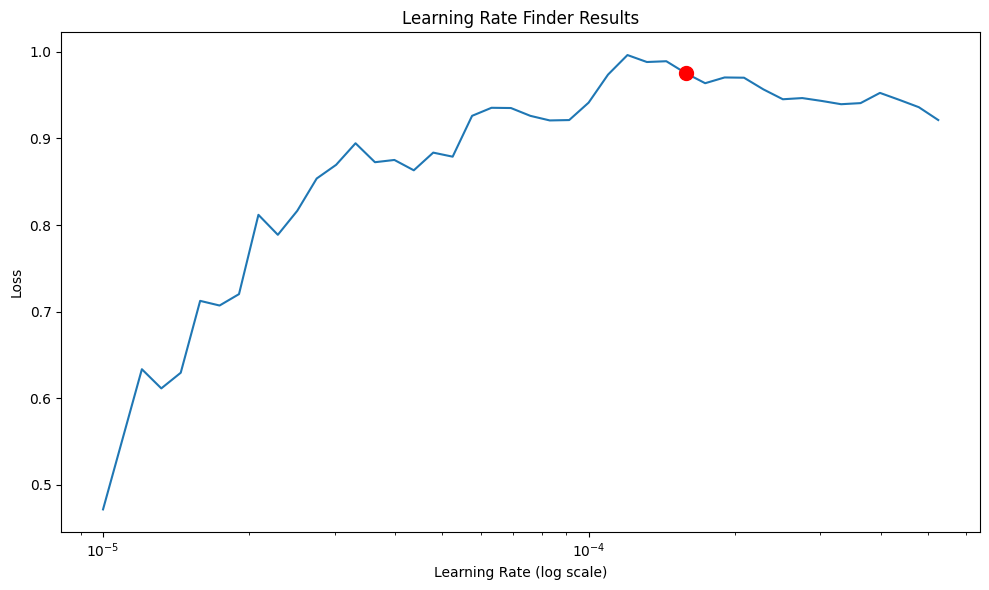

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00015849


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 2 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.0004

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869988   0.297132   0.074815
        l_GDP_dif_L1  l_GDP_dif_L2  hd_dif_L1  hd_dif_L2
GDP_eq      0.056775      0.173126   0.002446   0.000458
HD_eq      -5.913163     -4.869

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 2:
  learning_rate: 1.0080948836039468e-05
  hidden_size: 64
  num_layers: 3
  dropout: 0.1
  weight_decay: 0.01
  batch_size: 128

Best hyperparameters for household_debt with lag 2:
  learning_rate: 0.00043330063919999595
  hidden_size: 128
  num_layers: 2
  dropout: 0.4
  weight_decay: 0.01
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 635.43it/s]
Learning rate set to 2.7542287033381663e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_d6102802-1ecb-4ece-9dfc-c1e7a412d2db.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_d6102802-1ecb-4ece-9dfc-c1e7a412d2db.ckpt


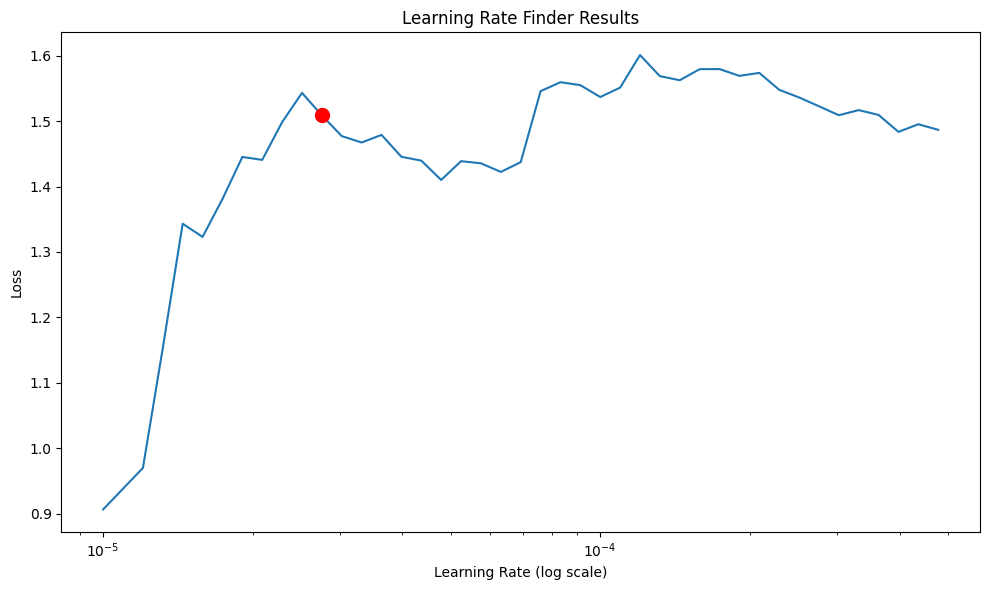

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00002754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 42 steps due to diverging loss.
Finding best initial lr:  42%|████▏     | 42/100 [00:00<00:00, 618.67it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_00c0b61e-37f0-4df4-b1a4-24f9d60a9abb.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_00c0b61e-37f0-4df4-b1a4-24f9d60a9abb.ckpt


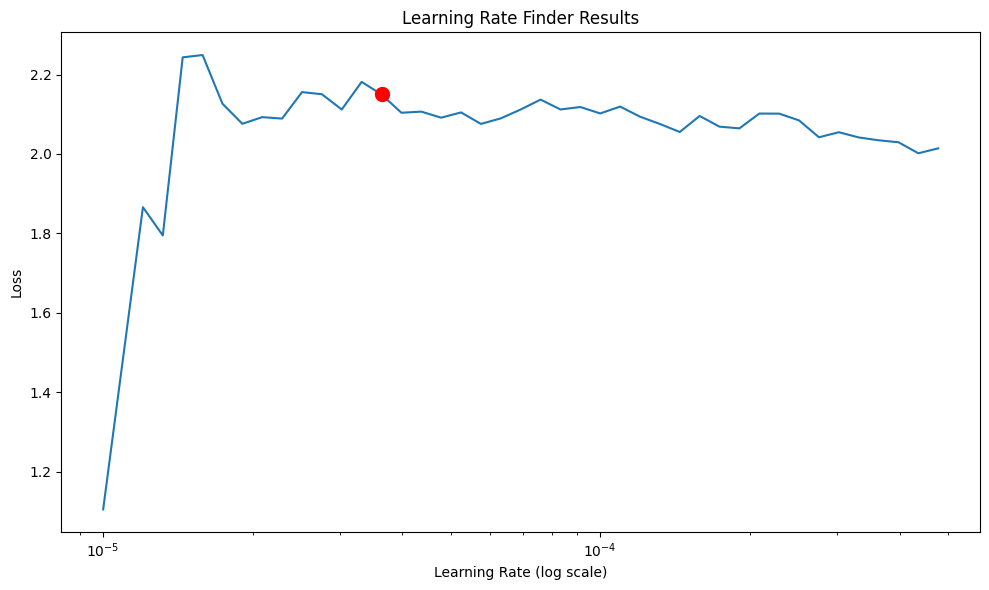

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 3 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.095202   0.001251  -0.001002   
HD_eq      -1.396906     -1.179989     -4.120100   0.535320   0.224350   

        hd_dif_L3  
GDP_eq  -0.000374  
HD_eq   -0.024859  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  hd_dif_L1  hd_dif_L2  \
GDP_eq     -0.113475     -0.016498      0.0

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/conn

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 3:
  learning_rate: 4.6120618200541694e-05
  hidden_size: 16
  num_layers: 3
  dropout: 0.3
  weight_decay: 0.0001
  batch_size: 32

Best hyperparameters for household_debt with lag 3:
  learning_rate: 0.0006214660294931885
  hidden_size: 128
  num_layers: 3
  dropout: 0.1
  weight_decay: 1e-05
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 591.87it/s]
Learning rate set to 5.248074602497726e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_31d7680e-63db-4fcf-ae5a-f541f8794778.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_31d7680e-63db-4fcf-ae5a-f541f8794778.ckpt


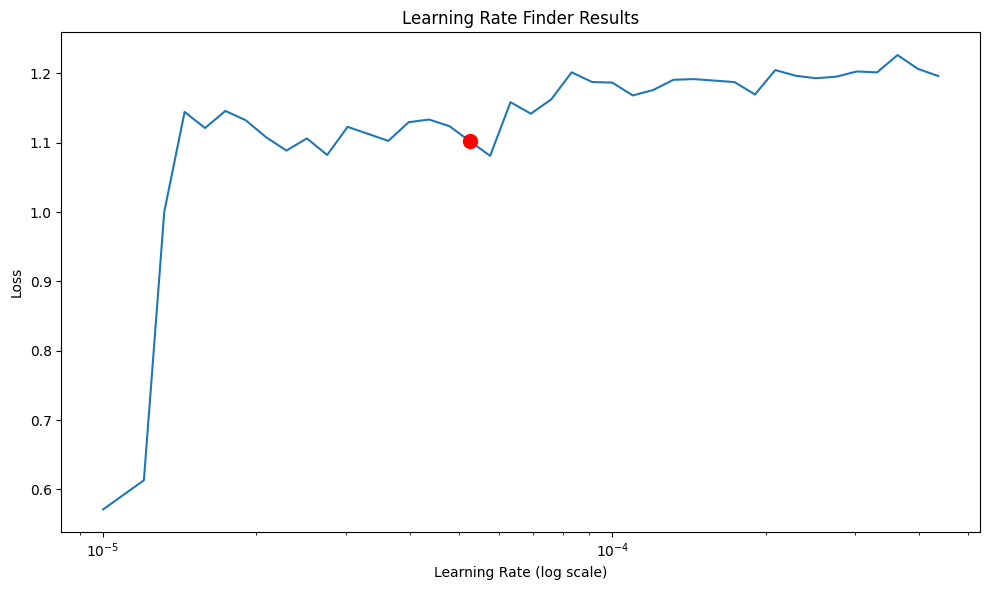

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005248


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 635.03it/s]
Learning rate set to 3.630780547701014e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_77615042-7837-477e-a701-3fb24a1cf9d2.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_77615042-7837-477e-a701-3fb24a1cf9d2.ckpt


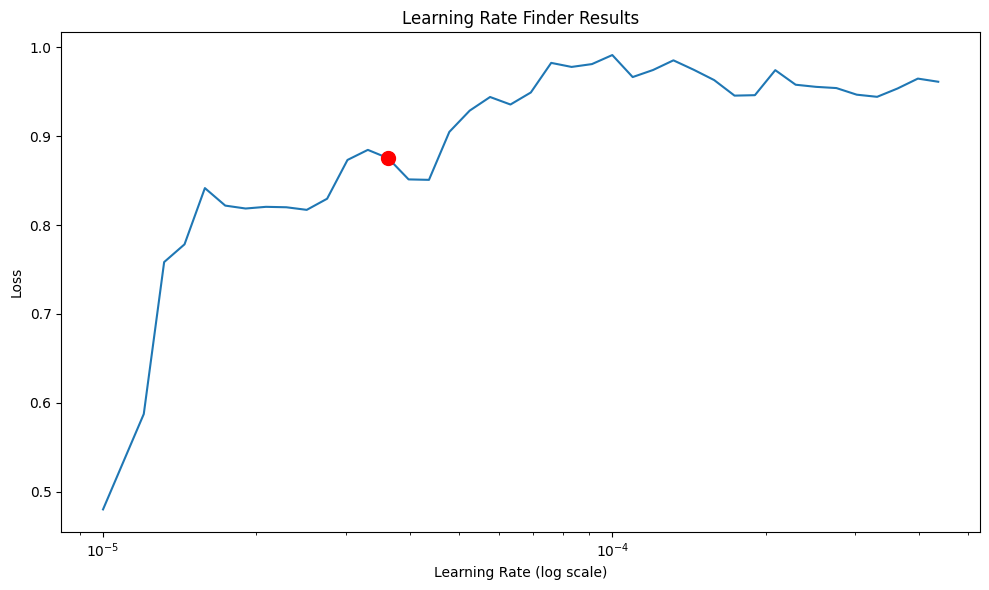

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003631


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 4 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2 

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0.000919  -0.000285  -0.000416  
HD_eq    0.204735  -0.082308   0.167814  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  hd_dif_L1  \
GDP_eq     -0.125174     -0.011762      0.112509      0.106034   0.001254   
HD_eq      -0.771875      0.139706     -3.128526      6.020989   0.565836   

        hd_dif_L2  hd_dif_L3  hd_dif_L4  
GDP_eq  -0

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 4:
  learning_rate: 1.246971534799908e-05
  hidden_size: 32
  num_layers: 3
  dropout: 0.5
  weight_decay: 1e-05
  batch_size: 16

Best hyperparameters for household_debt with lag 4:
  learning_rate: 0.007262011480129237
  hidden_size: 64
  num_layers: 2
  dropout: 0.4
  weight_decay: 0.0001
  batch_size: 128
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 632.36it/s]
Learning rate set to 0.00019054607179632476
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_faf76e8f-fdb6-421c-ab4f-5d610c0e0721.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_faf76e8f-fdb6-421c-ab4f-5d610c0e0721.ckpt


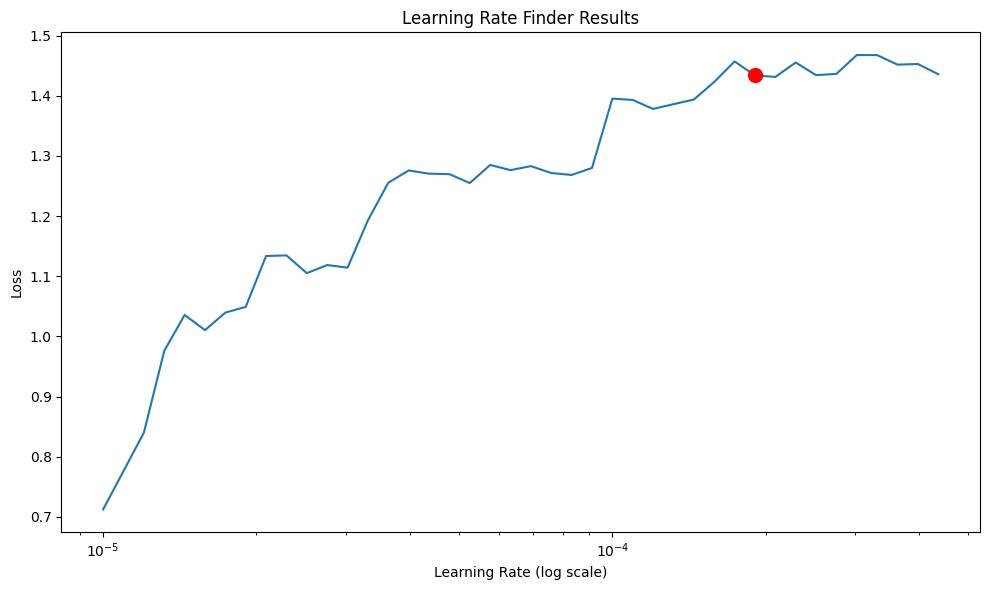

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00019055


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 41 steps due to diverging loss.
Finding best initial lr:  41%|████      | 41/100 [00:00<00:00, 644.45it/s]
Learning rate set to 3.981071705534973e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_16afcf77-dd6f-4a8e-b74c-3e2078566d6c.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_16afcf77-dd6f-4a8e-b74c-3e2078566d6c.ckpt


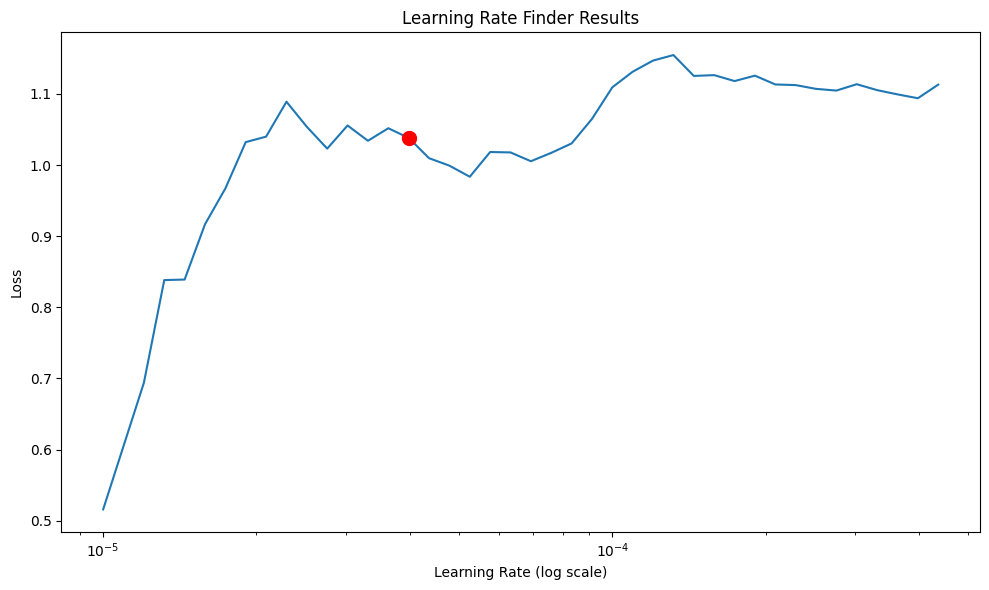

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00003981


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 5 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027

GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.127027     -0.013727      0.116121      0.115208      0.016451   
HD_eq      -1.378339     -0.075586     -2.716329      6.994519      2.604851   

        hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  
GDP_eq   0.001358  -0.000896  -0.000278  -0.000435  -0.000257  
HD_eq    0.557092   0.228419  -0.062226   0.162755  -0.057998  
Starting hyperparameter optimization for lag 5...
Optimizing hyperparameters for log_GDP


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 5:
  learning_rate: 3.871943481745073e-05
  hidden_size: 32
  num_layers: 1
  dropout: 0.2
  weight_decay: 0.0001
  batch_size: 16

Best hyperparameters for household_debt with lag 5:
  learning_rate: 1.5508452275713884e-05
  hidden_size: 128
  num_layers: 1
  dropout: 0.4
  weight_decay: 0.001
  batch_size: 32
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 539.01it/s]
Learning rate set to 5.75439937337157e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_2c913e99-2674-4ae9-8cdf-6e45d1ea113b.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_2c913e99-2674-4ae9-8cdf-6e45d1ea113b.ckpt


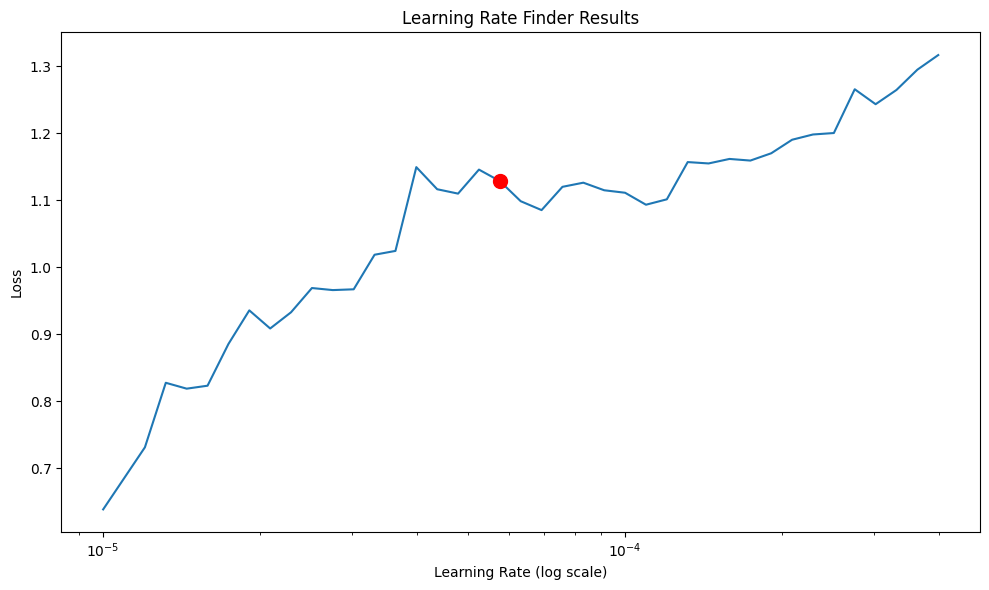

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00005754


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 621.98it/s]
Learning rate set to 6.309573444801933e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_15a55284-77c3-4245-885a-f03d952d3fb8.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_15a55284-77c3-4245-885a-f03d952d3fb8.ckpt


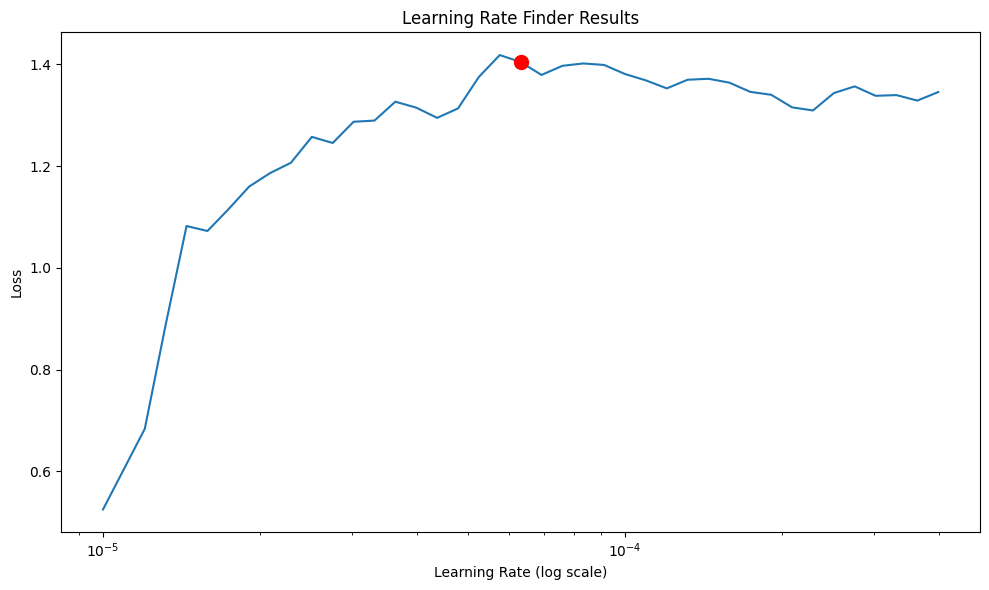

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.4 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00006310


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.



Evaluating models with 6 lags...
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.1 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.169424  -0.046451   

        hd_dif_L6  
GDP_eq  -0.001021  
HD_eq   -0.026896  
        l_GDP_dif_L1  l_GDP_dif_L2  l_GDP_dif_L3  l_GDP_dif_L4  l_GDP_dif_L5  \
GDP_eq     -0.133169     -0.010807      0.118113      0.115032      0.027343   
HD_eq      -1.495857     -0.203613     -2.920635      6.869987      2.746122   

        l_GDP_dif_L6  hd_dif_L1  hd_dif_L2  hd_dif_L3  hd_dif_L4  hd_dif_L5  \
GDP_eq      0.024131   0.001188  -0.000744  -0.000384  -0.000372   0.000212   
HD_eq       0.002029   0.548276   0.228165  -0.065949   0.1694

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 

Optimizing hyperparameters for household_debt


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider 


Best hyperparameters for log_GDP with lag 6:
  learning_rate: 0.009646893551270642
  hidden_size: 64
  num_layers: 1
  dropout: 0.3
  weight_decay: 0.01
  batch_size: 32

Best hyperparameters for household_debt with lag 6:
  learning_rate: 0.003138340750690519
  hidden_size: 128
  num_layers: 1
  dropout: 0.3
  weight_decay: 0.0001
  batch_size: 64
Training model for log_GDP with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 531.36it/s]
Learning rate set to 9.120108393559098e-05
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_dfb40cee-35bb-49c7-8fcd-5f3fe509941a.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_dfb40cee-35bb-49c7-8fcd-5f3fe509941a.ckpt


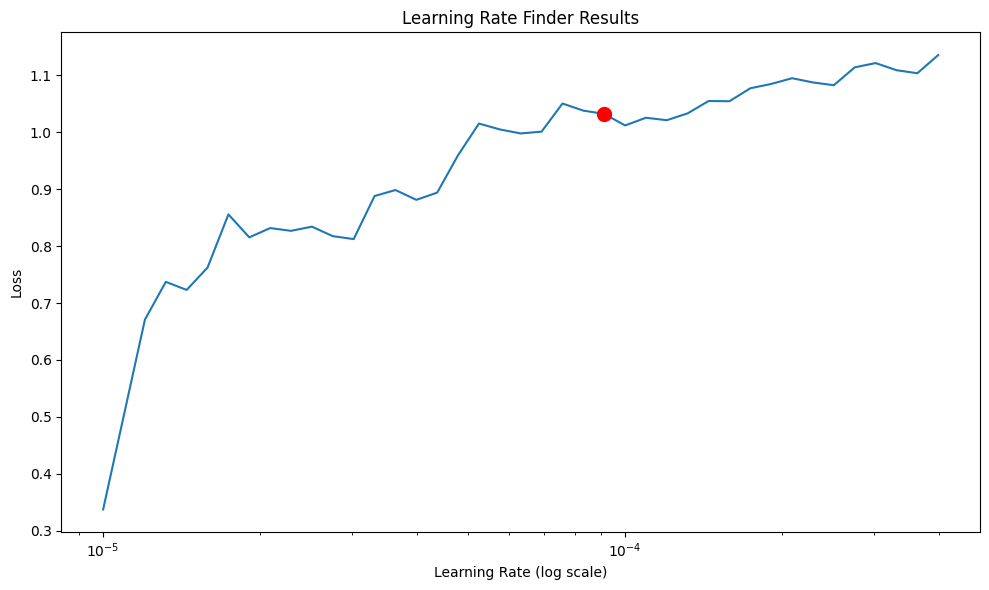

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00009120


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU ava

Training model for household_debt with optimized hyperparameters...
Finding optimal learning rate...


Finding best initial lr:   0%|          | 0/100 [00:00<?, ?it/s]`Trainer.fit` stopped: `max_epochs=1` reached.
LR finder stopped early after 40 steps due to diverging loss.
Finding best initial lr:  40%|████      | 40/100 [00:00<00:00, 610.10it/s]
Learning rate set to 0.00013182567385564074
Restoring states from the checkpoint path at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_68d9d97e-7360-4a93-a7ad-3b1c954587d3.ckpt
Restored all states from the checkpoint at /Users/bram/Desktop/Honors Draft for Reviewers/Honors-DeepVAR-Household-Debt-Analysis/Results/experiments/HHD_GDP/.lr_find_68d9d97e-7360-4a93-a7ad-3b1c954587d3.ckpt


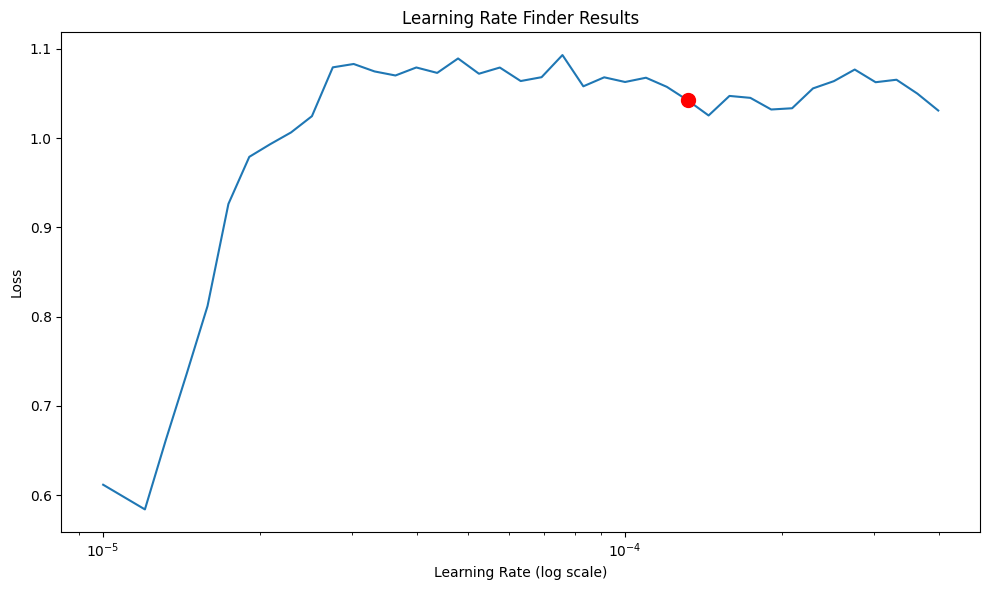

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.3 and num_layers=1
  warnings.warn(
GPU available: True (mps), used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/setup.py:177: GPU available but not used. You can set it by doing `Trainer(accelerator='gpu')`.


Suggested learning rate: 0.00013183


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=9` in the `DataLoader` to improve performance.


In [42]:
variables_to_evaluate = ['log_GDP', 'household_debt']
from var import var
# takes a while to run
robust_check_results4, robustness_dict4 = evaluate_models_with_lags(
    final_detrend, 
    train_dt_var, 
    test_dt_var, 
    variables_to_evaluate, 
    max_lags=max_lags_to_evaluate,
    seed = 1000
)

In [43]:
def calculate_model_improvements(results_dict, base_model='DeepVAR', compare_models=None):
    improvements = {}
    
    variables = list(results_dict[base_model].keys())
    
    for variable in variables:
        improvements[variable] = {}
        
        for lag in results_dict[base_model][variable].keys():
        # for lag in range(5,6):
            improvements[variable][lag] = {}
            
            for compare_model in compare_models:
                if compare_model not in results_dict:
                    continue
                    
                if variable not in results_dict[compare_model]:
                    continue
                    
                if lag not in results_dict[compare_model][variable]:
                    continue
                
                improvements[variable][lag][compare_model] = {}
                
                # calculate improvment
                for metric in ['MSE', 'RMSE', 'MAE']:
                    print(base_model, variable,lag,metric)
                    base_value = results_dict[base_model][variable][lag][metric]
                    compare_value = results_dict[compare_model][variable][lag][metric]
                    
                    if compare_value != 0:
                        # positive % change means base_model has lower error
                        improvement = ((compare_value - base_value) / compare_value) * 100
                        improvements[variable][lag][compare_model][metric] = improvement
                    else:
                        improvements[variable][lag][compare_model][metric] = None
    
    return improvements

improvements = calculate_model_improvements(all_results)

TypeError: 'NoneType' object is not iterable

In [45]:
all_results

{'VAR': {'log_GDP': {1: {'MSE': 6.595682563832944e-05,
    'RMSE': 0.008121380771662504,
    'MAE': 0.005019438668488517},
   2: {'MSE': 6.776145482146734e-05,
    'RMSE': 0.008231734618017477,
    'MAE': 0.005177812235255311},
   3: {'MSE': 6.845213540187435e-05,
    'RMSE': 0.00827358056719546,
    'MAE': 0.005202971521574132},
   4: {'MSE': 7.007236893199493e-05,
    'RMSE': 0.008370924019007396,
    'MAE': 0.005389215484757611},
   5: {'MSE': 7.12586558822402e-05,
    'RMSE': 0.008441484222708717,
    'MAE': 0.005309516423884655},
   6: {'MSE': 7.64756046211953e-05,
    'RMSE': 0.008745033140085593,
    'MAE': 0.005581262803357211}},
  'household_debt': {1: {'MSE': 0.5887579123743388,
    'RMSE': 0.7673056186255506,
    'MAE': 0.5607985700564985},
   2: {'MSE': 0.5046727016669035,
    'RMSE': 0.7104031965489059,
    'MAE': 0.5065668825445805},
   3: {'MSE': 0.522135332041974,
    'RMSE': 0.7225893246111335,
    'MAE': 0.5150604788267046},
   4: {'MSE': 0.7329909582765527,
    'RMSE

In [48]:
results = [all_results, robust_check_results, robust_check_results2, robust_check_results3, robust_check_results4]
for result in results:
    improvements = calculate_model_improvements(result)
    for variable in improvements:
        print(f"\nImprovements for {variable}:")
        for lag in range(1,6):
            print(f"  Lag {lag}:")
            for compare_model in improvements[variable][lag]:
                print(f"    vs {compare_model}:")
                for metric, value in improvements[variable][lag][compare_model].items():
                    print(f"      {metric}: {value:.2f}%")

DeepVAR log_GDP 1 MSE
DeepVAR log_GDP 1 RMSE
DeepVAR log_GDP 1 MAE
DeepVAR log_GDP 1 MSE
DeepVAR log_GDP 1 RMSE
DeepVAR log_GDP 1 MAE
DeepVAR log_GDP 2 MSE
DeepVAR log_GDP 2 RMSE
DeepVAR log_GDP 2 MAE
DeepVAR log_GDP 2 MSE
DeepVAR log_GDP 2 RMSE
DeepVAR log_GDP 2 MAE
DeepVAR log_GDP 3 MSE
DeepVAR log_GDP 3 RMSE
DeepVAR log_GDP 3 MAE
DeepVAR log_GDP 3 MSE
DeepVAR log_GDP 3 RMSE
DeepVAR log_GDP 3 MAE
DeepVAR log_GDP 4 MSE
DeepVAR log_GDP 4 RMSE
DeepVAR log_GDP 4 MAE
DeepVAR log_GDP 4 MSE
DeepVAR log_GDP 4 RMSE
DeepVAR log_GDP 4 MAE
DeepVAR log_GDP 5 MSE
DeepVAR log_GDP 5 RMSE
DeepVAR log_GDP 5 MAE
DeepVAR log_GDP 5 MSE
DeepVAR log_GDP 5 RMSE
DeepVAR log_GDP 5 MAE
DeepVAR log_GDP 6 MSE
DeepVAR log_GDP 6 RMSE
DeepVAR log_GDP 6 MAE
DeepVAR log_GDP 6 MSE
DeepVAR log_GDP 6 RMSE
DeepVAR log_GDP 6 MAE
DeepVAR household_debt 1 MSE
DeepVAR household_debt 1 RMSE
DeepVAR household_debt 1 MAE
DeepVAR household_debt 1 MSE
DeepVAR household_debt 1 RMSE
DeepVAR household_debt 1 MAE
DeepVAR household_de

   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0

/var/folders/mg/jjtr9hhj5zj6g0svf83l817h0000gn/T/ipykernel_74146/327921358.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=figsize)


   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0        

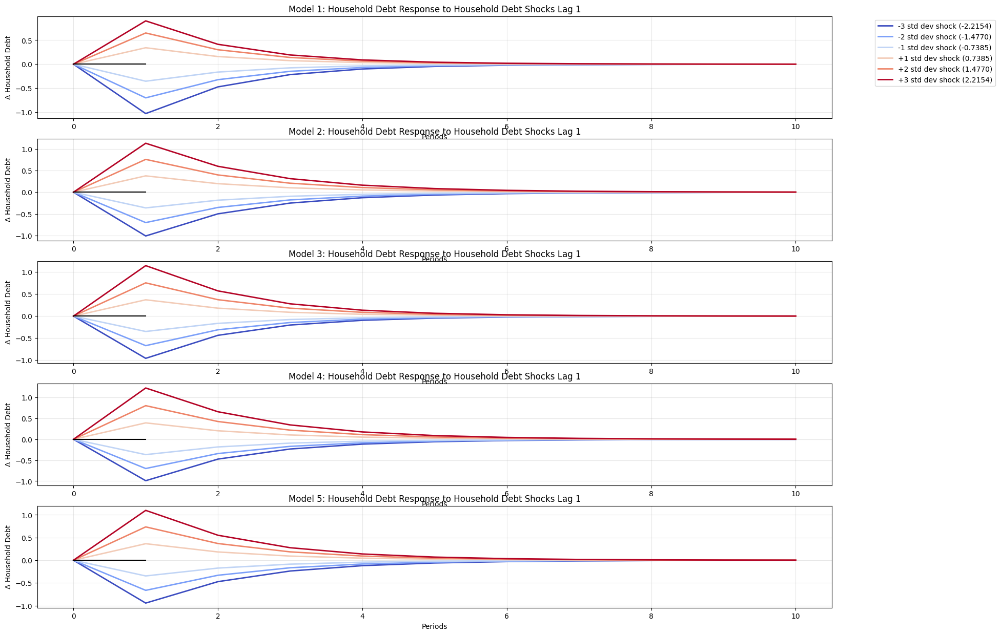

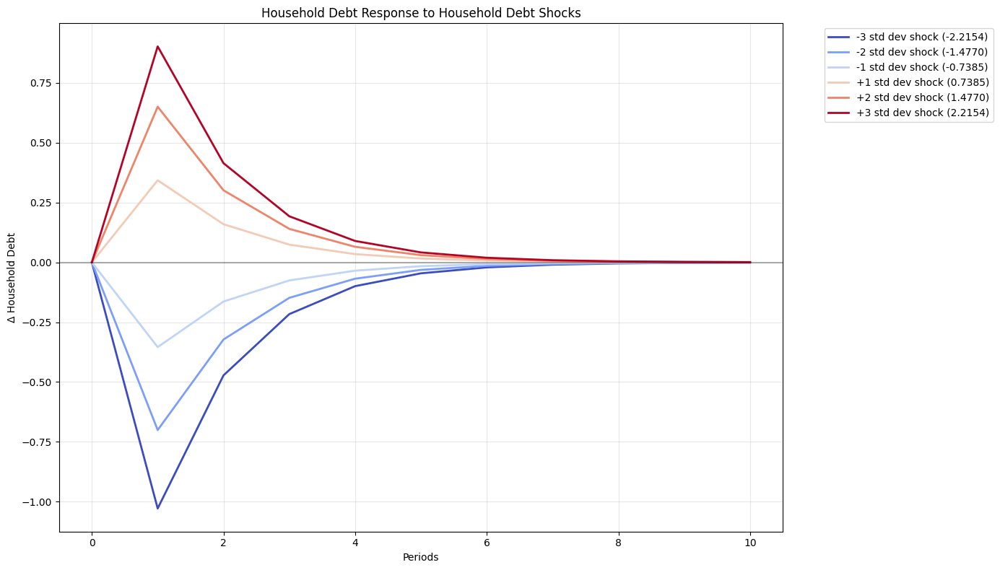

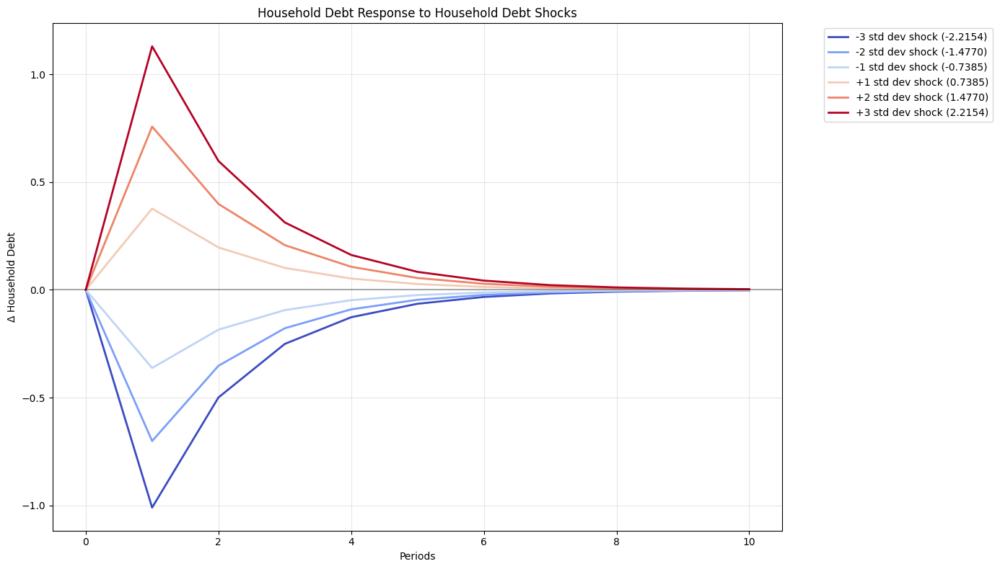

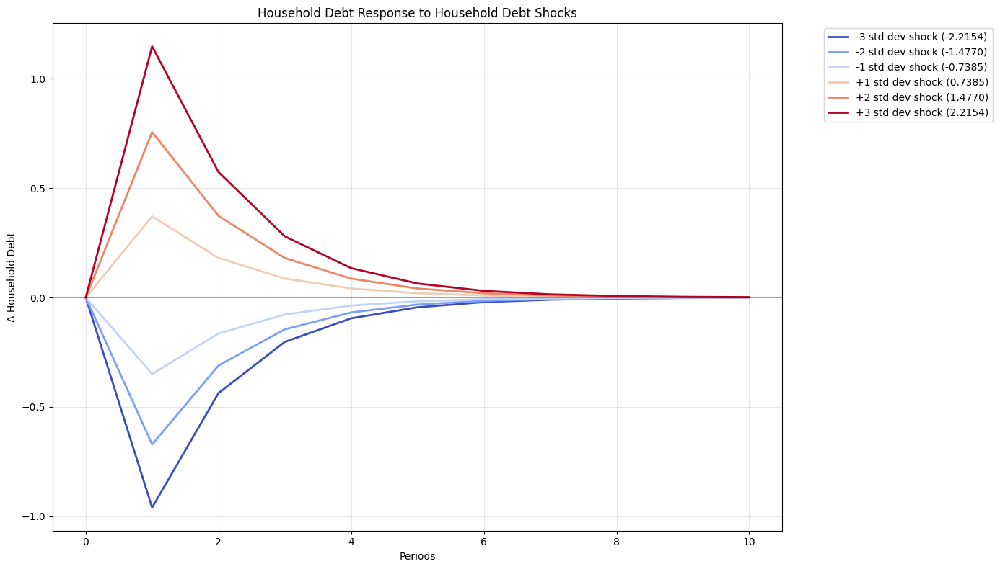

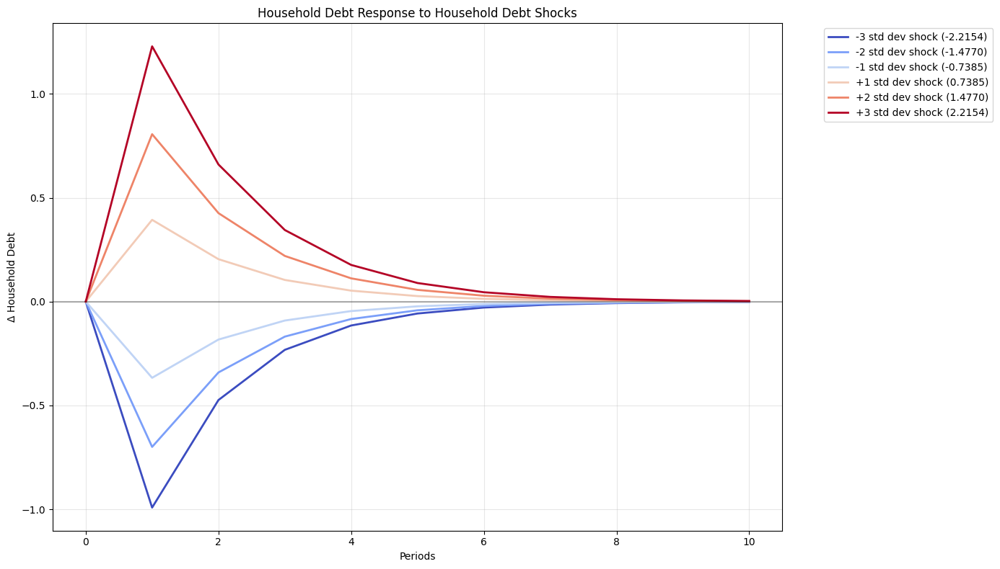

...

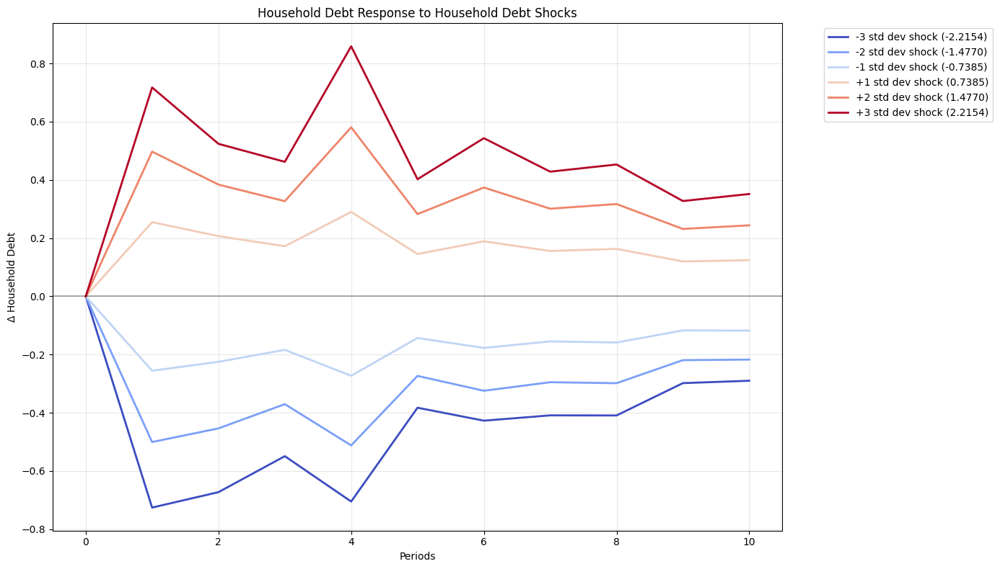

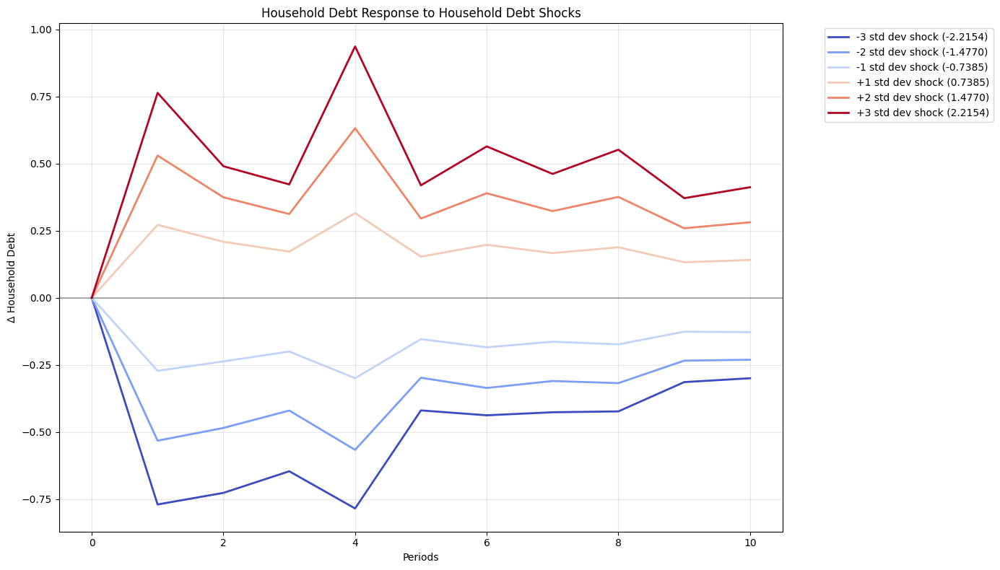

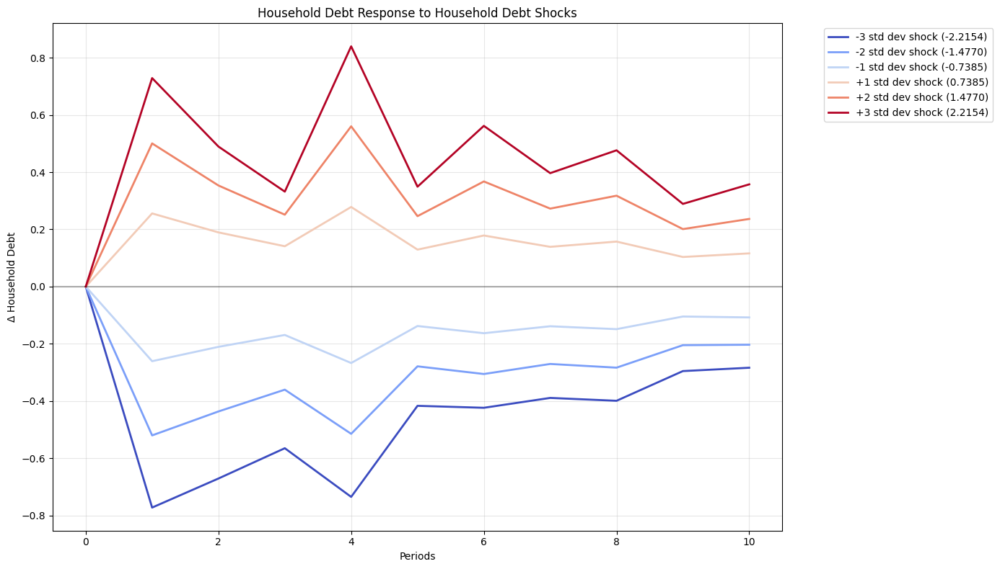

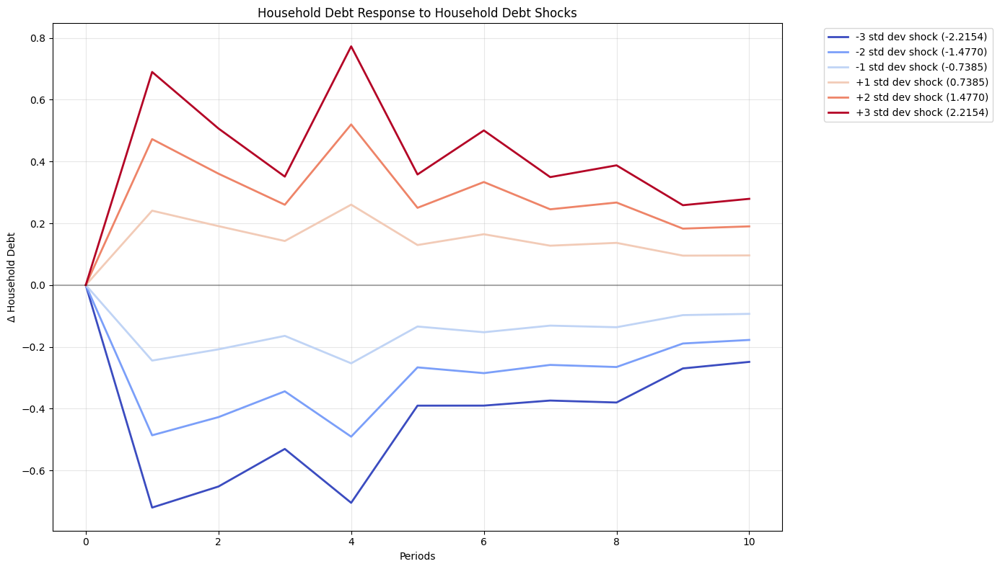

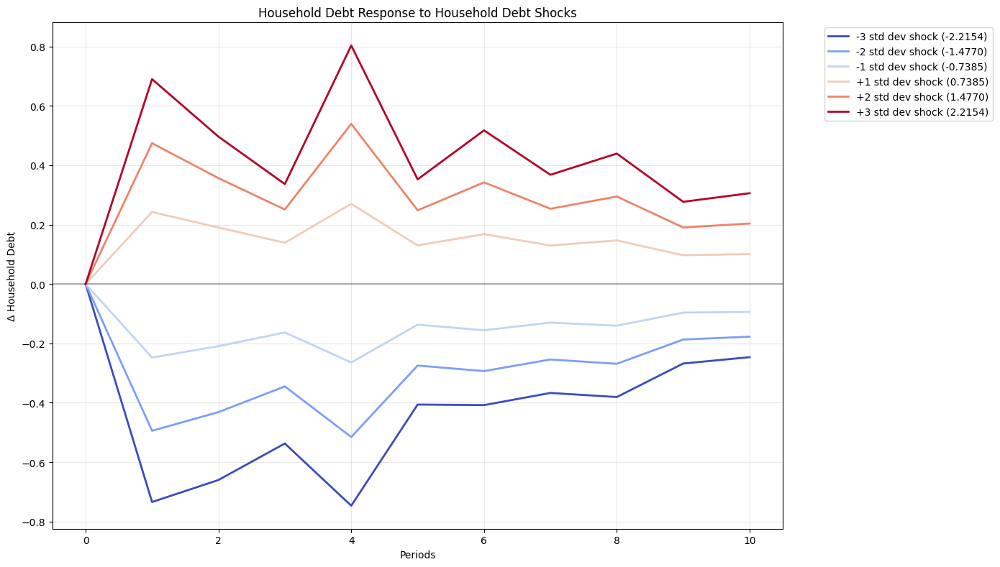

In [52]:
def plot_irf_with_multiple_shocks(df_zeros, inputs, shock_var, response_var, 
                                 model_dict, lags, periods=10, 
                                 std_multipliers=None, figsize=(14, 8), show_plot=True):
    """
    Plot Impulse Response Functions for multiple shock sizes.
    
    Parameters:
    -----------
    df_zeros : DataFrame
        DataFrame with zeros for all input variables
    inputs : list
        List of input variable names
    shock_var : str
        Variable name to shock (e.g., 'household_debt_lag1')
    response_var : str
        Variable name to measure response (e.g., 'log_GDP')
    model_dict : dict
        Dictionary containing trained models
    lags : int
        Number of lags in the model
    periods : int
        Number of periods to forecast
    std_multipliers : list, optional
        List of standard deviation multipliers for shock sizes
        Default is [-3, -2, -1, 1, 2, 3]
    figsize : tuple, optional
        Figure size (width, height)
    show_plot : bool, optional
        Whether to display the plot immediately (default: True)
        
    Returns:
    --------
    matplotlib.figure.Figure
        The created figure object
    """
    # Get standard deviation of the variable to shock
    base_var = shock_var.split('_lag')[0]
    response_base_var = response_var
    
    # Get standard deviations from the data
    std_devs = lstm_df[[base_var]].std()
    
    # Define standardized shock sizes if not provided
    if std_multipliers is None:
        std_multipliers = [-3, -2, -1, 1, 2, 3]
    
    # Sort multipliers from negative to positive
    std_multipliers.sort()
    
    # Create shock sizes
    shock_sizes = [std_devs[base_var] * float(m) for m in std_multipliers]
    # Create figure
    fig, ax = plt.subplots(figsize=figsize)
    
    # Create color map
    colors = plt.cm.coolwarm(np.linspace(0, 1, len(std_multipliers)))
    
    # Plot IRFs for different shock sizes
    for i, (mult, shock, color) in enumerate(zip(std_multipliers, shock_sizes, colors)):
        
        irf_result = irf.predict(df_zeros, inputs, shock_var, shock, response_var, periods, model_dict, lags)
        label = f'{mult:+d} std dev shock ({shock:.4f})'
        ax.plot(irf_result, label=label, color=color, linewidth=2)
    
    
    ax.axhline(y=0, color='k', linestyle='-', alpha=0.3)
    
    # Set title and labels
    shock_name = base_var.replace('_', ' ').title()
    response_name = response_var.replace('_', ' ').title()
    
    if response_var == 'log_GDP':
        response_label = '%Δ GDP'
    else:
        response_label = f'Δ {response_name}'
        
    ax.set_title(f'{response_name} Response to {shock_name} Shocks')
    ax.set_xlabel('Periods')
    ax.set_ylabel(response_label)
    
    
    ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    ax.grid(True, alpha=0.3)
    
    plt.tight_layout()
    
    if show_plot:
        plt.show()
    
    return fig, ax

def create_irf_grid(models, lag, shock_var, shocked_var, periods=20, std_multipliers=None, figsize=(20, 15)):
    """
    Create a grid of IRF plots for multiple models.
    
    Parameters:
    -----------
    models : list
        List of model dictionaries
    lag : int
        Lag specification to use
    periods : int
        Number of periods to forecast
    std_multipliers : list, optional
        List of standard deviation multipliers for shock sizes
    figsize : tuple, optional
        Figure size for the entire grid
        
    Returns:
    --------
    matplotlib.figure.Figure
        The created figure object
    """
    # Number of models
    n_models = len(models)
    
    # Create a grid with n_models rows and 1 column
    fig, axes = plt.subplots(n_models, 1, figsize=figsize)
    
    # If there's only one model, make axes iterable
    if n_models == 1:
        axes = [axes]
    
    # Get inputs for the specified lag
    lag_inputs = models[0][lag]['inputs']
    df_zeros = pd.DataFrame(np.zeros((1, len(lag_inputs))), columns=lag_inputs)
    
    # Create IRF plots for each model
    for i, model in enumerate(models):
        # Generate IRF plot
        _, ax = plot_irf_with_multiple_shocks(
            df_zeros, 
            lag_inputs,  
            shock_var, 
            shocked_var, 
            model[lag]['model_dict'], 
            lag,  
            periods=periods, 
            std_multipliers=std_multipliers,
            show_plot=False
        )
        
        # Copy the plot to the grid
        axes[i].clear()
        for line in ax.lines:
            axes[i].plot(line.get_xdata(), line.get_ydata(), 
                        color=line.get_color(), 
                        linestyle=line.get_linestyle(),
                        linewidth=line.get_linewidth(),
                        label=line.get_label())
        
        # Copy other elements
        axes[i].set_title(f'Model {i+1}: {ax.get_title()} Lag {lag}')
        axes[i].set_xlabel(ax.get_xlabel())
        axes[i].set_ylabel(ax.get_ylabel())
        axes[i].grid(True, alpha=0.3)
        
        
        if i == 0:  
            axes[i].legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    
    plt.tight_layout()
    plt.subplots_adjust(hspace=0.4)  
    
    return fig

models = [model_dict_1, robustness_dict, robustness_dict2, robustness_dict3, robustness_dict4]
lag_to_use = 6
std_multipliers = [-3, -2, -1, 1, 2, 3]

for lag in range(1,7):
    irf_grid = create_irf_grid(models, lag, 'household_debt_lag1', 'household_debt', periods=10, std_multipliers=std_multipliers)


   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0

/var/folders/mg/jjtr9hhj5zj6g0svf83l817h0000gn/T/ipykernel_74146/1725835814.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=figsize)


   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0        

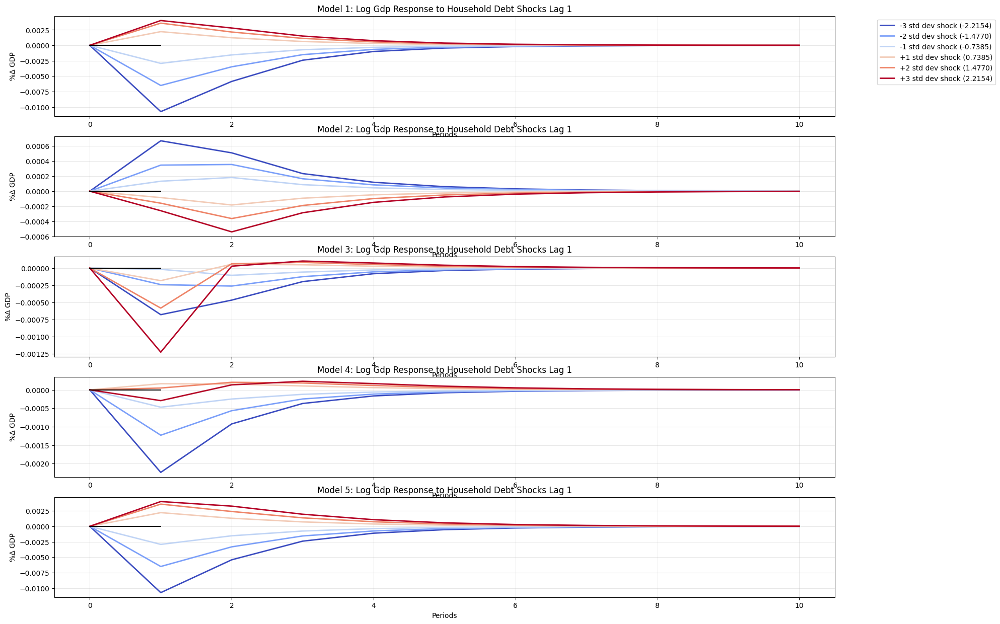

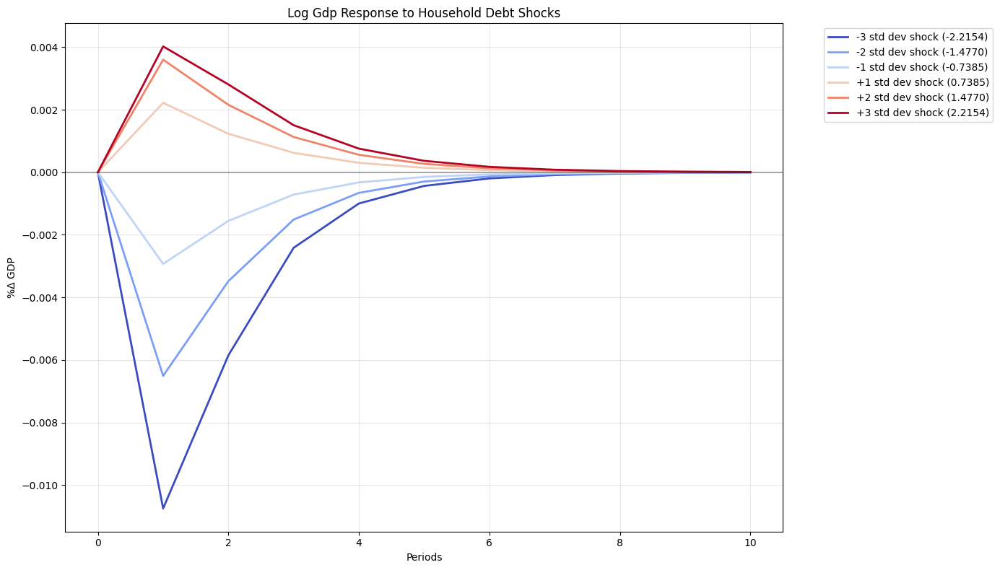

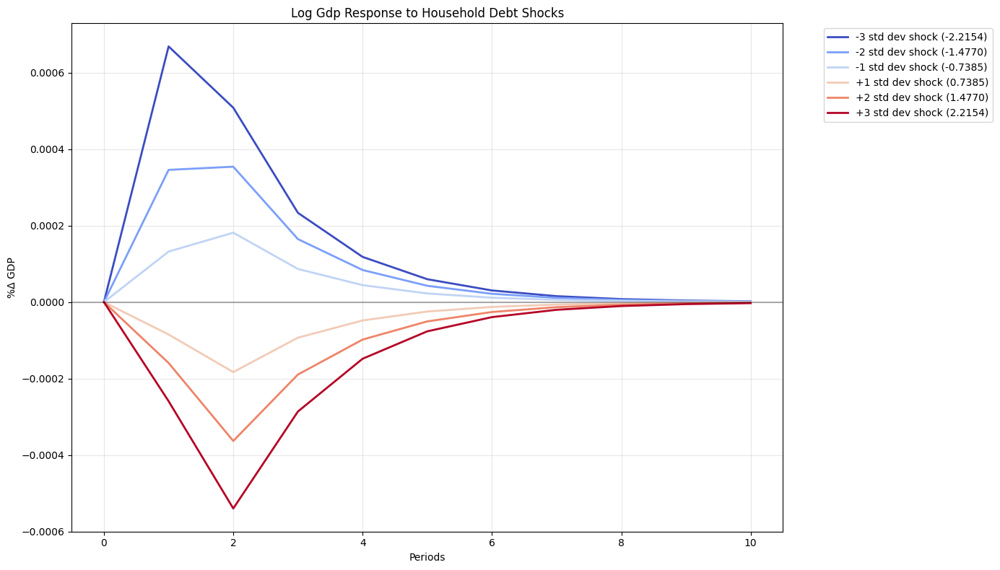

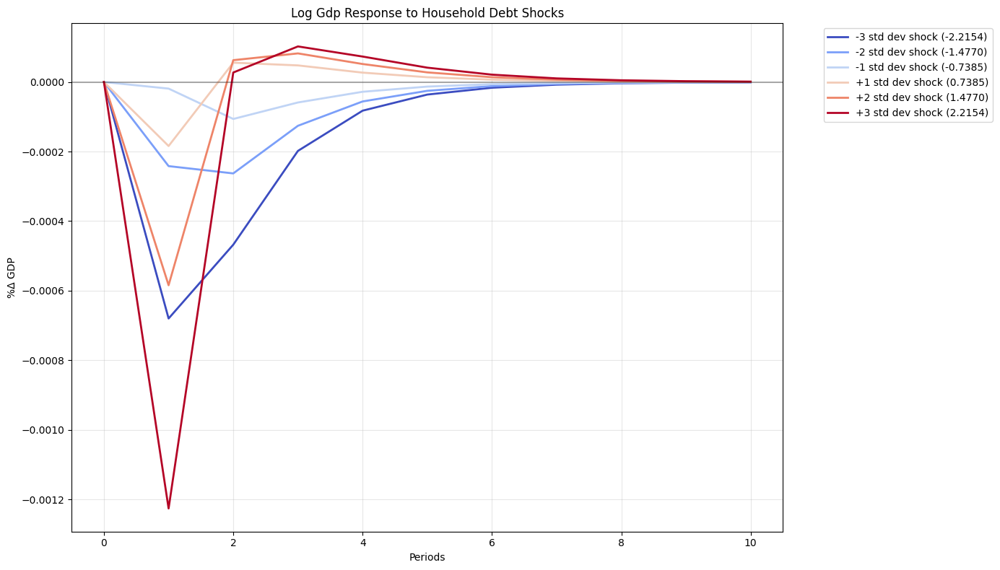

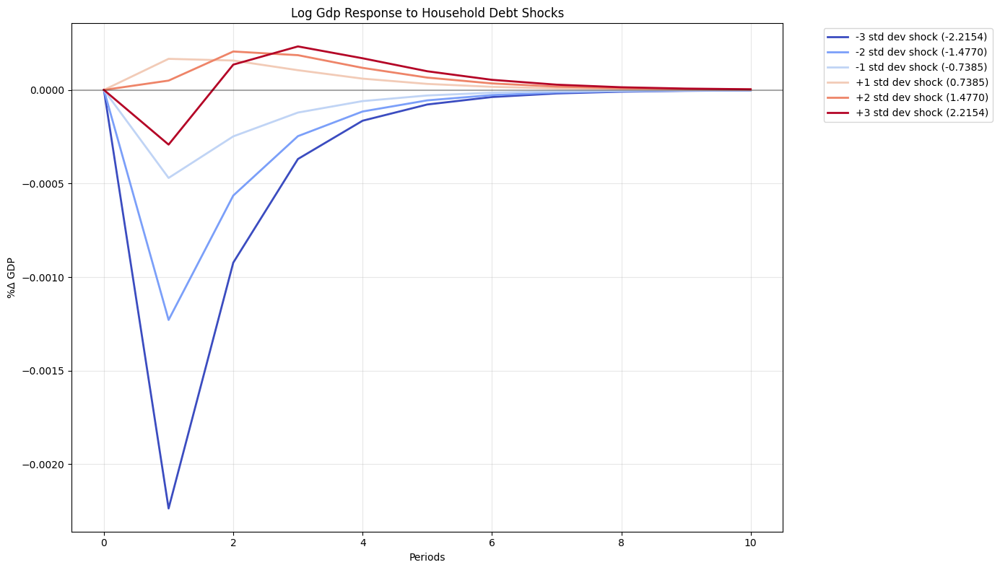

...

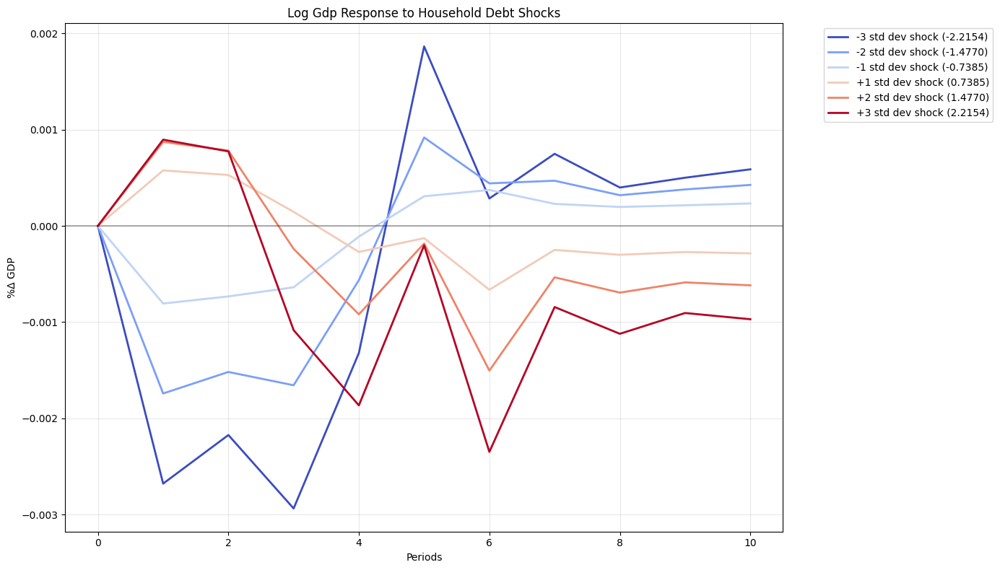

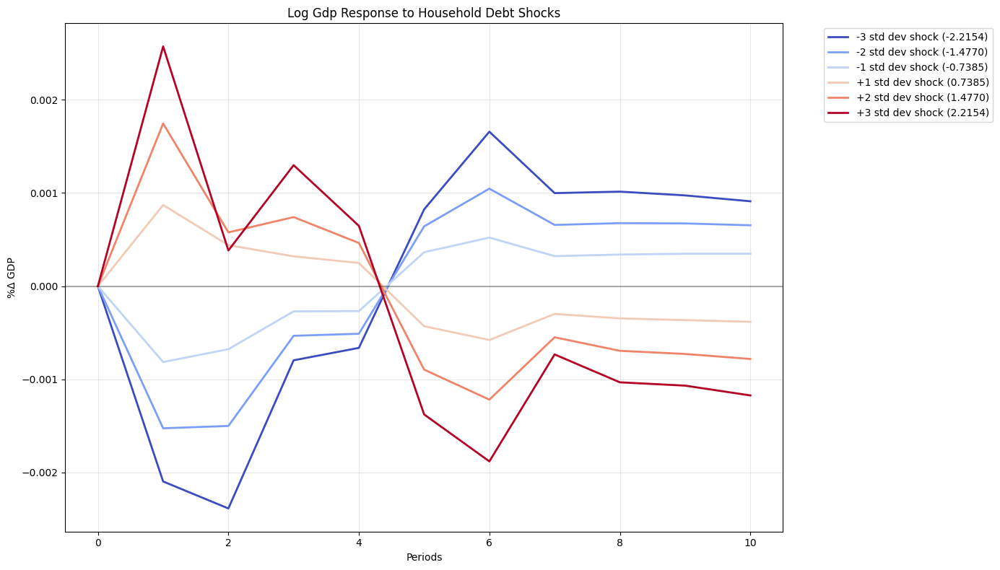

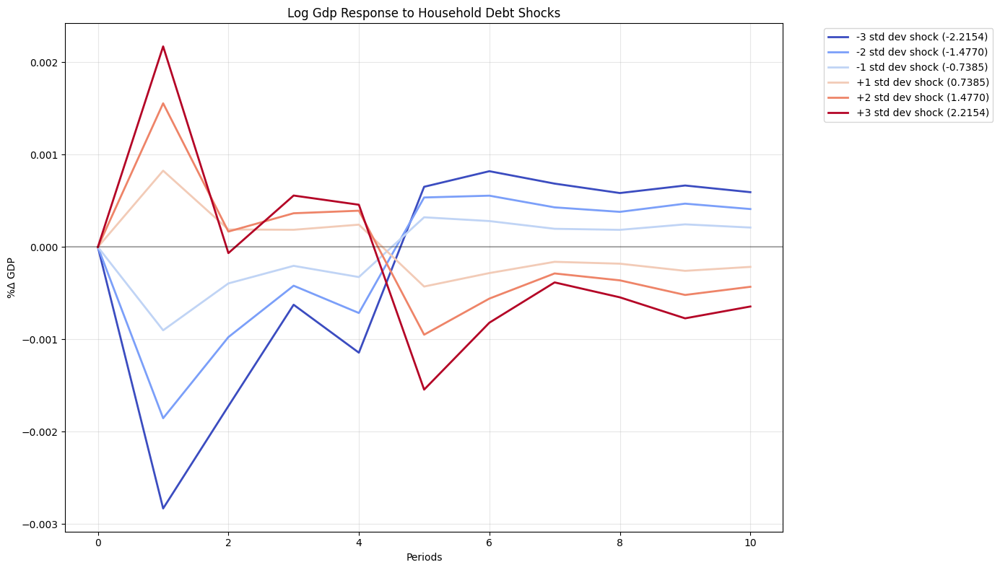

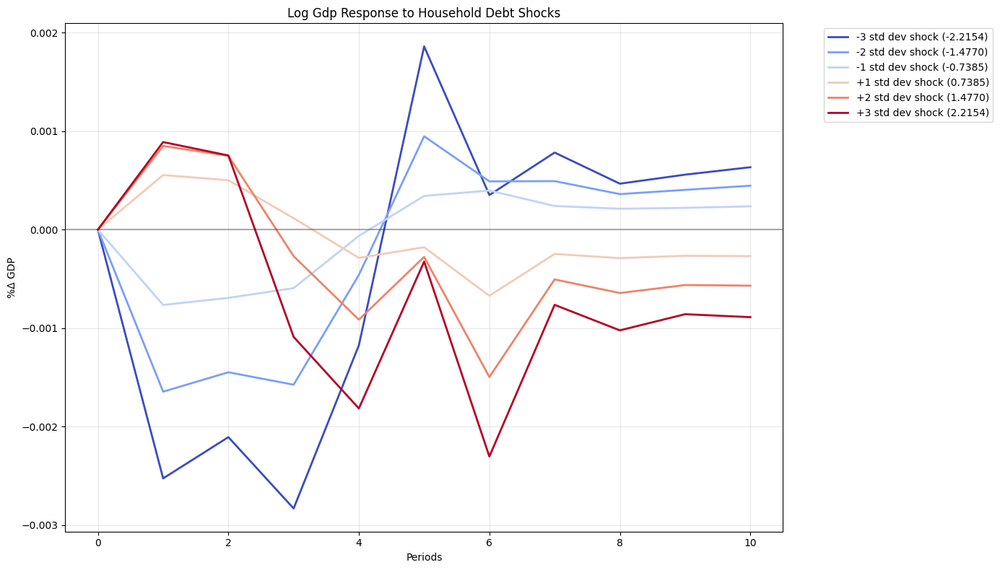

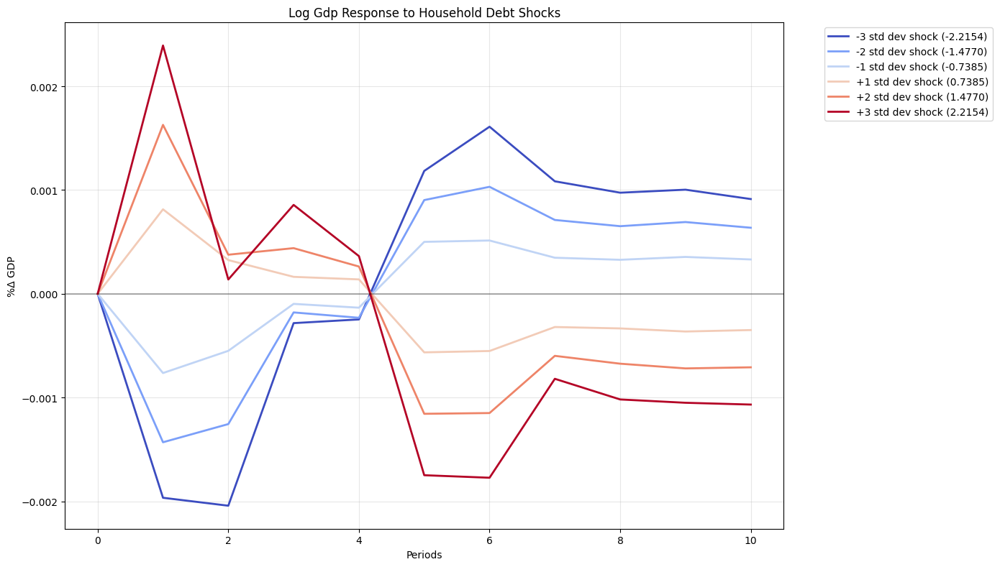

In [49]:

for lag in range(1,7):
    irf_grid = create_irf_grid(models, lag, 'household_debt_lag1', 'log_GDP', periods=10, std_multipliers=std_multipliers)


   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0           0.0                  0.0
   log_GDP_lag1  household_debt_lag1
0

/var/folders/mg/jjtr9hhj5zj6g0svf83l817h0000gn/T/ipykernel_74146/327921358.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=figsize)


   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0           0.0           0.0           0.0           0.0   

   household_debt_lag1  household_debt_lag2  household_debt_lag3  \
0                  0.0                  0.0                  0.0   

   household_debt_lag4  
0                  0.0  
   log_GDP_lag1  log_GDP_lag2  log_GDP_lag3  log_GDP_lag4  \
0        

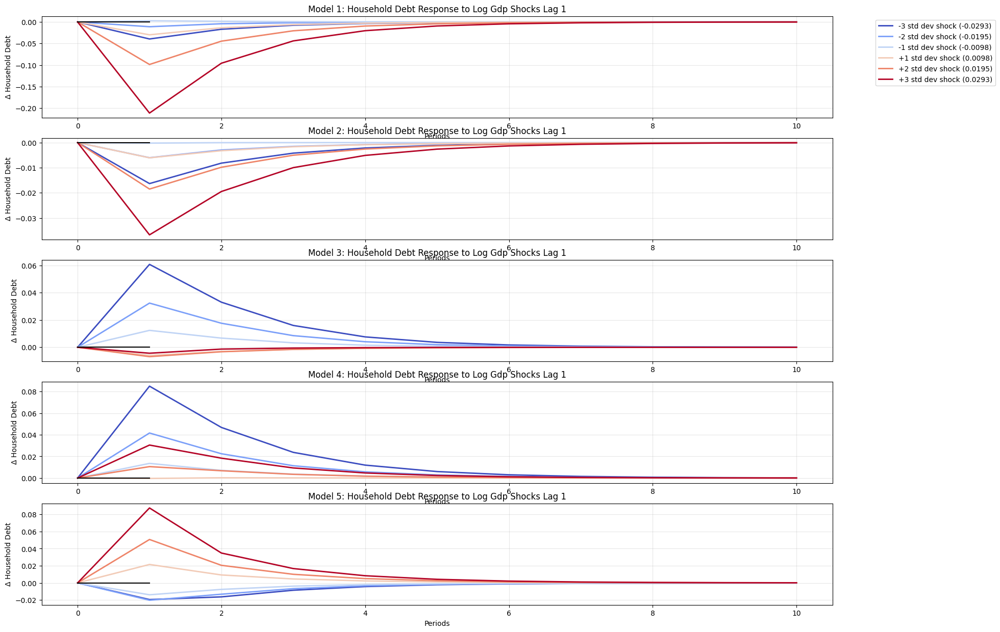

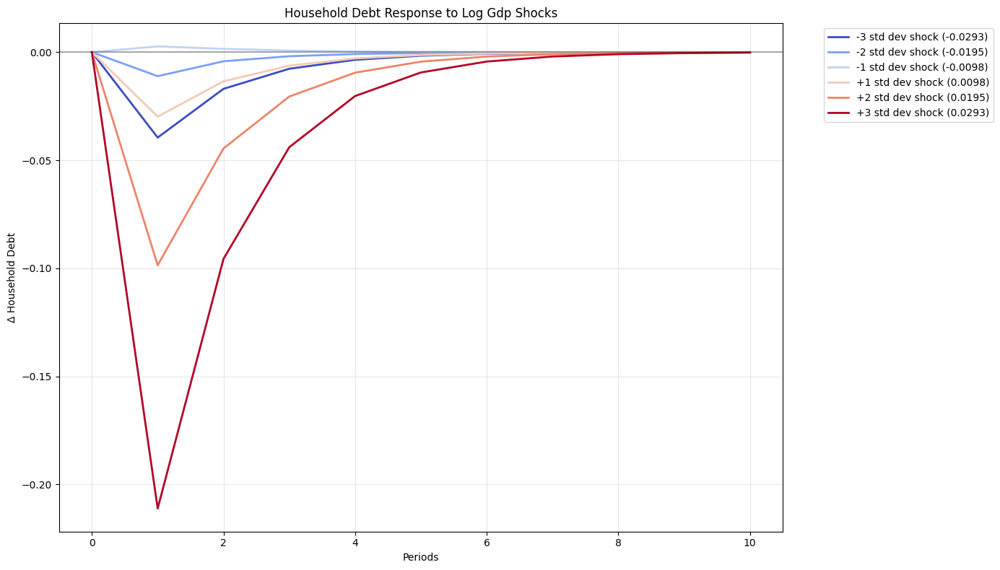

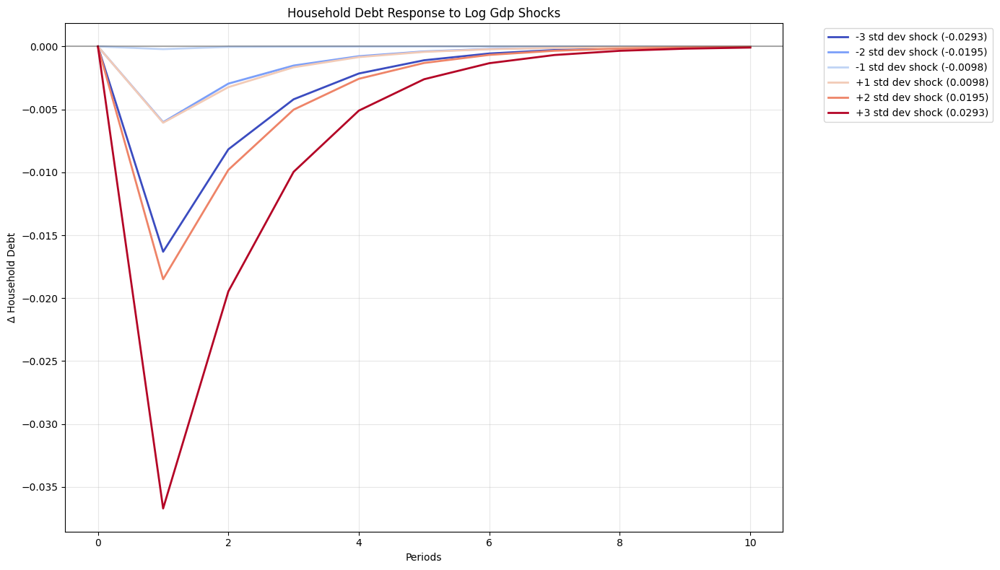

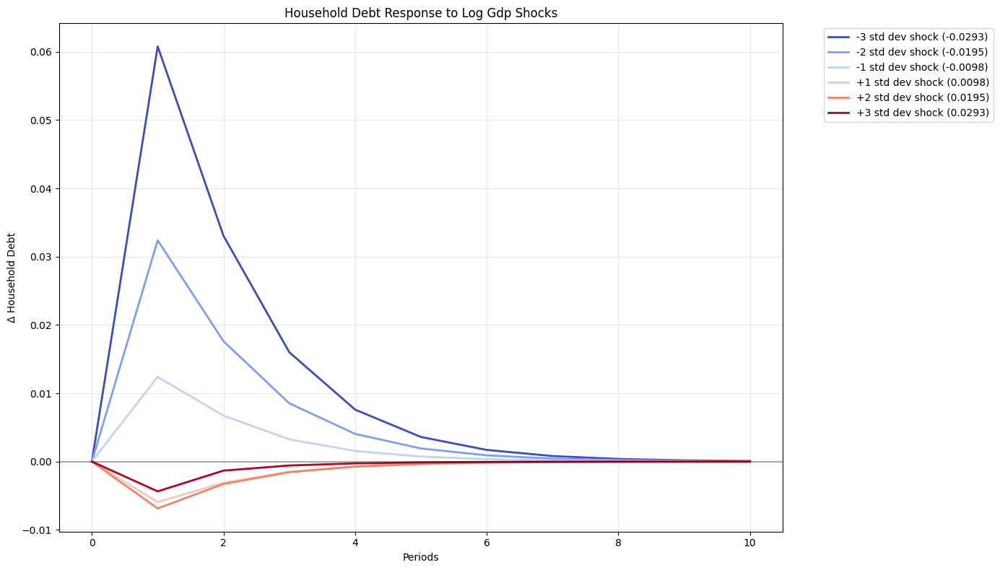

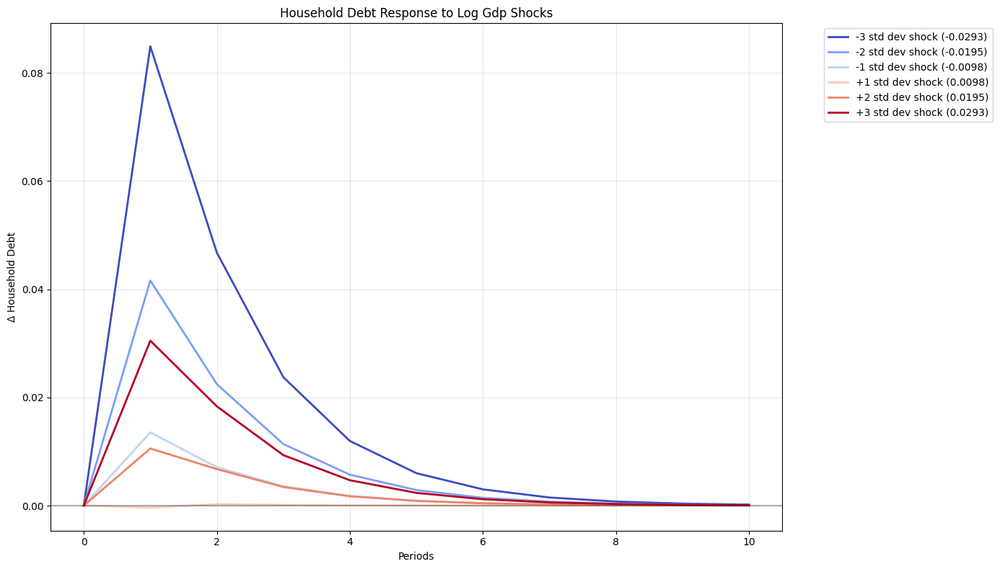

...

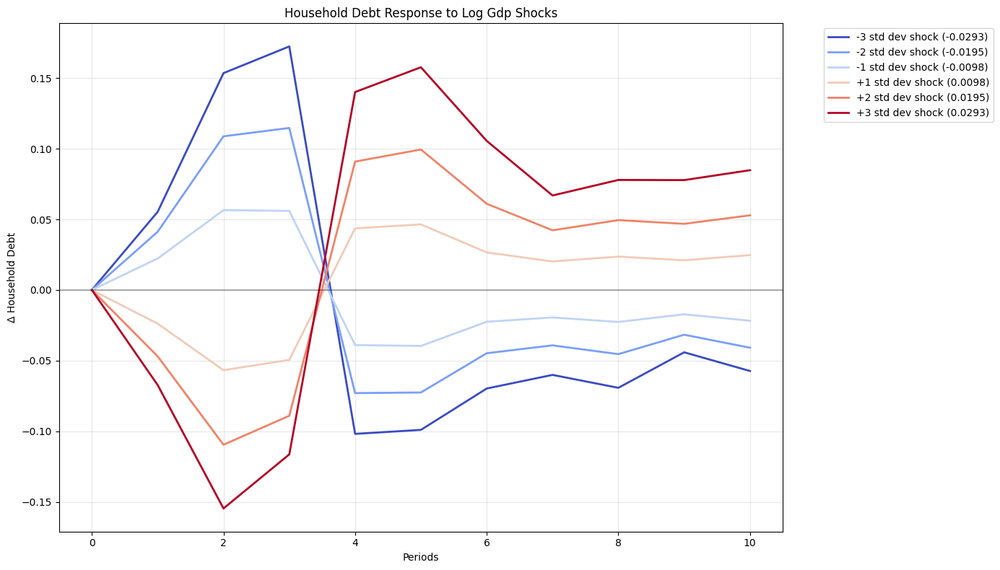

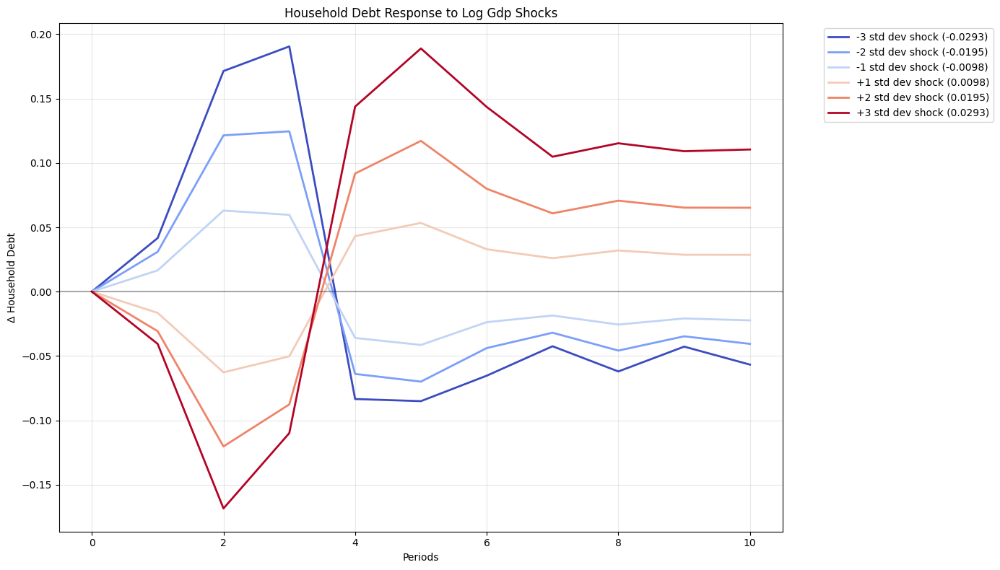

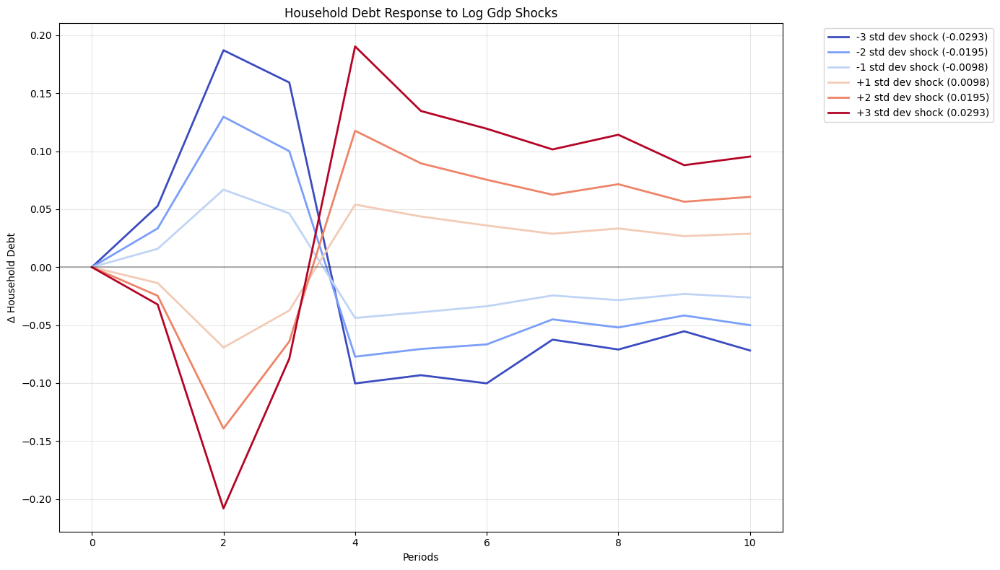

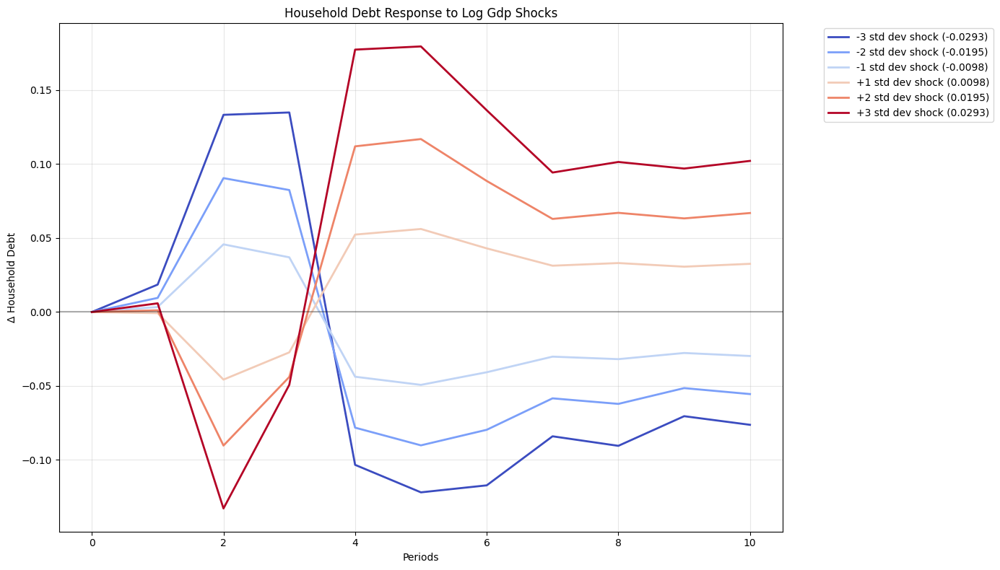

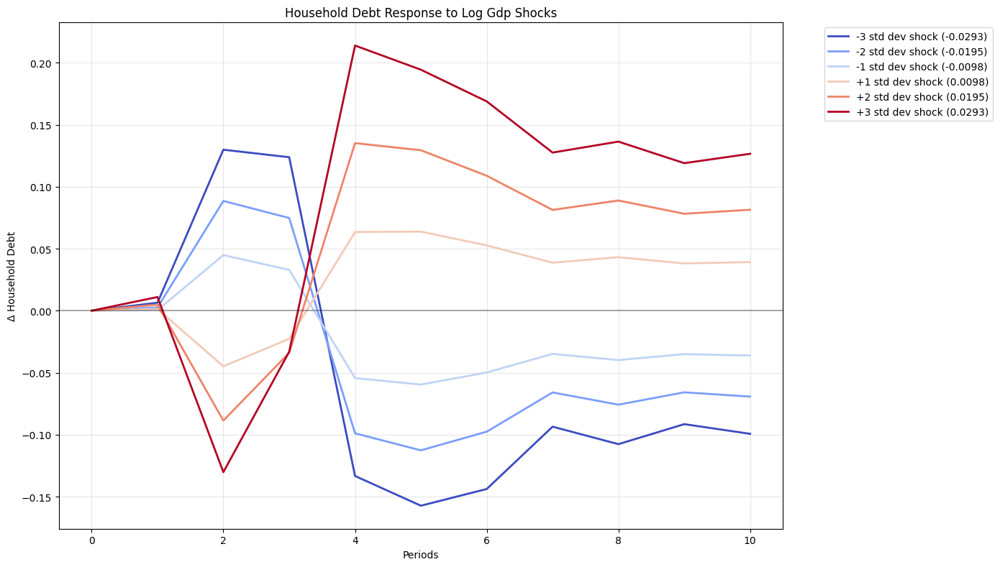

In [53]:

for lag in range(1,7):
    irf_grid = create_irf_grid(models, lag, 'log_GDP_lag1', 'household_debt', periods=10, std_multipliers=std_multipliers)


In [1]:
demeaned_df

NameError: name 'demeaned_df' is not defined